In [0]:
! pip install eli5
import pandas as pd
import numpy as np

from plotnine import ggplot, geom_point, aes, stat_smooth, facet_wrap, geom_histogram
from plotnine import geom_boxplot, scale_y_log10, geom_bar, geom_line, ggtitle
from plotnine import facet_wrap, scale_x_log10
from scipy.stats import pearsonr
from scipy.stats import spearmanr
import itertools
import scipy.stats as scs
import matplotlib.pyplot as plt


from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.inspection import permutation_importance
from sklearn.impute import SimpleImputer
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
from xgboost import XGBClassifier

from sklearn.preprocessing import StandardScaler

from keras.models import Sequential, load_model
from keras.layers.core import Dense, Activation, Dropout
from keras.layers import LeakyReLU, BatchNormalization, ReLU
from keras import callbacks, optimizers
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.wrappers.scikit_learn import KerasRegressor

from eli5.sklearn import PermutationImportance
import eli5

Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


## Load important libraries

In [0]:
# Import File
filepath = '/content/drive/My Drive/omdena-model-b-c-nn/dataset/OUTPUT_WBI_exposer_cyclones_v14.csv'
df = pd.read_csv(filepath, sep=';')

In [0]:
df.head(3)

,SID,NAME,ISO,YEAR,COORDS,COORDS_MAX_WINDS,COORDS_MIN_DIST2LAND,BASIN,SUB BASIN,MONTH_START,MONTH_END,DATE_START,DATE_END,DATE_LAND_START,DATE_LAND_END,TOTAL_HOURS_EVENT,TOTAL_HOURS_IN_LAND,NATURE,GENERAL_CATEGORY,MAX_WIND,MIN_PRES,MIN_DIST2LAND,MAX_STORMSPEED,MAX_USA_SSHS,MAX_USA_SSHS_INLAND,V_LAND_KN,DISTANCE_TRACK,DISTANCE_TRACK_VINCENTY,34KN_POP,64KN_POP,96KN_POP,64KN_ASSETS,34KN_ASSETS,96KN_ASSETS,TOTAL_DAMAGE_(000$),TOTAL_DEATHS,POP_DEN_SQ_KM,RURAL_POP(%),HDI,Arable land (hectares per person),Cereal yield (kg per hectare),Food production index (2004-2006 = 100),GDP per capita (constant 2010 US$),Net flows from UN agencies US$,"Life expectancy at birth, total (years)",Adjusted savings: education expenditure (% of GNI),Income_level_Final,POP_MAX_34_ADJ,POP_MAX_50_ADJ,POP_MAX_64_ADJ,TOTAL_AFFECTED
0,1949163N07145,DELLA,JPN,1949,"[(21.5, 125.424), (22.2, 125.8), (22.9089, 126...","[(27.6584, 128.82), (28.9141, 129.572999999999...","[(31.9866, 130.683), (33.5183, 130.97299999999...",WP,WP,6,6,19/06/1949 9:00,24/06/1949 6:00,20/06/1949 15:00,23/06/1949 3:00,117.0,60.0,TS,Cat 4,116.0,952,0,33.0,3,0,99.82,3889.480640,3632.626180,NaN,NaN,NaN,NaN,NaN,NaN,NaN,419.0,195.0,77.20,0.816,0.059615,4173.5,67.79,8607.657082,0.0,67.666098,2.867878,Low,1.198300e+07,5.803981e+06,3.320907e+06,194046
1,1950241N23140,JANE,JPN,1950,"[(23.8845, 139.74), (23.9335, 139.639), (23.98...","[(28.7509, 133.748), (29.1201, 133.762), (29.6...","[(34.9374, 135.476), (36.1016, 136.095), (37.2...",WP,WP,8,9,30/08/1950 3:00,05/09/1950 0:00,03/09/1950 3:00,04/09/1950 0:00,141.0,21.0,ET,Cat 4,116.0,940,0,31.0,3,1,99.82,3596.090691,2787.480021,NaN,NaN,NaN,NaN,NaN,NaN,NaN,509.0,227.0,47.00,0.816,0.059615,4173.5,67.79,8607.657082,0.0,67.666098,2.867878,Low,3.160822e+07,1.559196e+07,1.018936e+07,642117
2,1951224N12316,CHARLIE,JAM,1951,"[(17.3398, -75.4138), (17.6, -76.2), (17.9, -7...","[(17.6, -76.2), (17.9, -76.9)]","[(17.9, -76.9), (18.1, -77.8)]",NAm,CS,8,8,17/08/1951 21:00,18/08/1951 12:00,18/08/1951 3:00,18/08/1951 6:00,15.0,3.0,TS,Cat 3,110.0,0,0,17.0,3,3,132.40,438.214691,435.729082,2788659.0,2788659.0,2552903.0,2.148198e+10,2.148198e+10,1.948346e+10,56000.0,154.0,133.0,66.23,0.668,0.100541,868.3,69.93,3796.219401,0.0,64.770000,2.578304,Low,1.689243e+06,1.687083e+06,1.195052e+06,20200


# Drop Columns & Some Pre - preprocessing


In [0]:
# Drop some unimportant features
drop_cols = ['34KN_POP', '34KN_ASSETS', '64KN_POP', '64KN_ASSETS', 
             '96KN_POP', '96KN_ASSETS', "SID", 'NAME', 'ISO', 
             'TOTAL_DAMAGE_(000$)', 'TOTAL_DEATHS', 'DATE_LAND_END',
             'DATE_START',	'DATE_END',	'DATE_LAND_START', 
             'COORDS',	'COORDS_MAX_WINDS',	'COORDS_MIN_DIST2LAND']

df = df.drop(columns=drop_cols)

In [0]:
### Xaview Preprocessing
df["SUB BASIN"]= df["SUB BASIN"].replace('MM', np.nan) 
df["BASIN"]= df["BASIN"].replace('MM', np.nan)

df['SUB BASIN']= np.where(df['SUB BASIN'].isnull(), df['BASIN'], df['SUB BASIN'])

In [0]:
df.shape

(991, 33)

In [0]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 991 entries, 0 to 990
Data columns (total 33 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   YEAR                                                991 non-null    int64  
 1   BASIN                                               991 non-null    object 
 2   SUB BASIN                                           991 non-null    object 
 3   MONTH_START                                         991 non-null    int64  
 4   MONTH_END                                           991 non-null    int64  
 5   TOTAL_HOURS_EVENT                                   991 non-null    float64
 6   TOTAL_HOURS_IN_LAND                                 991 non-null    float64
 7   NATURE                                              991 non-null    object 
 8   GENERAL_CATEGORY                                    991 non-null    object 
 9  

In [0]:
## Check features null count
def checkNull(col, df):
  return(df[col].isna().sum() / len(df[col]) * 100.0)
  
for each in df.columns.values:
  print('{} ---- {}'.format(each, checkNull(each, df)))

YEAR ---- 0.0
BASIN ---- 0.0
SUB BASIN ---- 0.0
MONTH_START ---- 0.0
MONTH_END ---- 0.0
TOTAL_HOURS_EVENT ---- 0.0
TOTAL_HOURS_IN_LAND ---- 0.0
NATURE ---- 0.0
GENERAL_CATEGORY ---- 0.0
MAX_WIND ---- 0.0
MIN_PRES ---- 0.0
MIN_DIST2LAND ---- 0.0
MAX_STORMSPEED ---- 0.20181634712411706
MAX_USA_SSHS ---- 0.0
MAX_USA_SSHS_INLAND ---- 0.0
V_LAND_KN ---- 0.0
DISTANCE_TRACK ---- 0.0
DISTANCE_TRACK_VINCENTY ---- 0.0
POP_DEN_SQ_KM ---- 0.0
RURAL_POP(%) ---- 0.0
HDI ---- 0.0
Arable land (hectares per person) ---- 0.10090817356205853
Cereal yield (kg per hectare) ---- 1.0090817356205852
Food production index (2004-2006 = 100) ---- 0.4036326942482341
GDP per capita (constant 2010 US$) ---- 0.9081735620585267
Net flows from UN agencies US$ ---- 0.0
Life expectancy at birth, total (years) ---- 0.4036326942482341
Adjusted savings: education expenditure (% of GNI) ---- 1.0090817356205852
Income_level_Final ---- 0.0
POP_MAX_34_ADJ ---- 8.072653884964682
POP_MAX_50_ADJ ---- 8.072653884964682
POP_MAX_64_

In [0]:
## USA_SSHS Preprocessing

df['MAX_USA_SSHS_INLAND'][df['MAX_USA_SSHS_INLAND'] == 'No landing'] = -7
df['MAX_USA_SSHS_INLAND'] = df['MAX_USA_SSHS_INLAND'].astype('int')

## Engineer new features
# If value is 7
# And if value falls in the SS scale

df['MAX_SSH_7'] = np.where(df['MAX_USA_SSHS_INLAND'] == -7, 1, 0)
df['MAX_SSH_SS'] = np.where(df['MAX_USA_SSHS_INLAND'] > 0, 1, 0)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


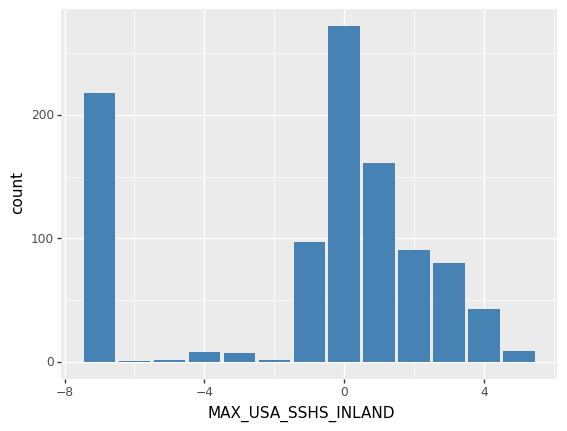

<ggplot: (-9223363251236146211)>


In [0]:
print(ggplot(df, aes(x='MAX_USA_SSHS_INLAND'))
 + geom_bar(fill="steelblue"))

# Numerical Features With NaNs

## Helper Functions

In [0]:
objects_viz = ['BASIN', 'SUB BASIN', 'NATURE', 'GENERAL_CATEGORY', 
               'Income_level_Final']


## Bi & MultiVariate Plots
def plotBiMulti(x, y='TOTAL_AFFECTED', scale_x=False, scale_y=False):
  x_corr = (np.log10(df[x] + 1) if scale_x else df[x])
  y_corr = (np.log10(df[y] + 1) if scale_y else df[y])

  print("Correlation - ", pearsonr(x_corr, y_corr)[0])

  null = geom_point()
  for each in objects_viz:
    print(ggplot(df, aes(x=x, y=y, fill=each))
 + geom_point(color='steelblue')
 + (scale_x_log10() if scale_x else null)
 + (scale_y_log10() if scale_y else null))
    

## Categorical
def plotBiMulti_cat(x, y='TOTAL_AFFECTED', fill="#990099"):

  objects_viz_temp = [cat for cat in objects_viz if cat != x]

  for each in objects_viz_temp:
    print(ggplot(df, aes(x=x, y=y, fill=each)) + geom_bar(stat="identity", 
                                                          position="dodge"))

    

## Checks for outliers. 
def outlier_check(x):
  upper_quartile = np.nanpercentile(x, 75)
  lower_quartile = np.nanpercentile(x, 25)
  IQR = 1.5 * (upper_quartile - lower_quartile)
  q_both = [lower_quartile - IQR, upper_quartile + IQR]

  outliers = np.where(x < q_both[0])[0], np.where(x > q_both[1])[0]

  return({"lower": outliers[0], 
          "upper": outliers[1], 
          "q_both": q_both, 
          'min-max': [x.min(), x.max()]})


### Helper Func - Clip outliers
def clip_outliers(x, outlier_dict):
  lower_idx = outlier_dict["lower"]
  upper_idx = outlier_dict["upper"]
  q_both = outlier_dict["q_both"]

  x[lower_idx] = q_both[0]
  x[upper_idx] = q_both[1]


## MAX_STORMSPEED

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 33'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


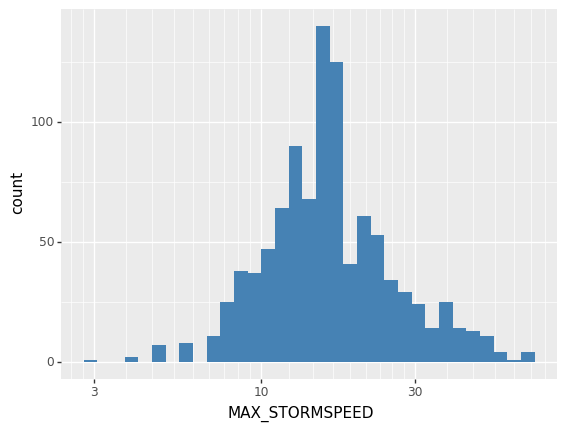

<ggplot: (8785614732450)>
Correlation -  -0.10927855101047225


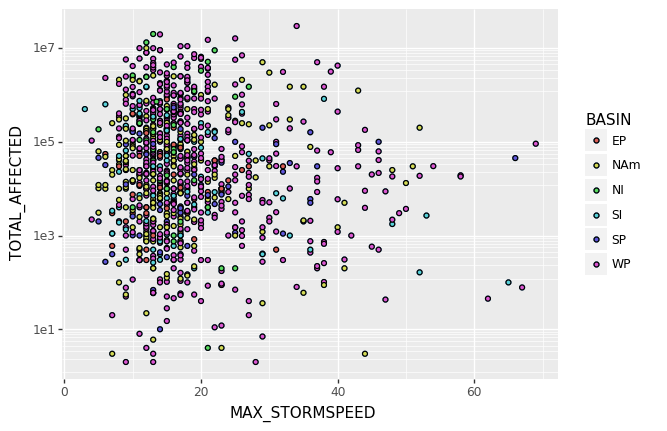

<ggplot: (8785614412699)>


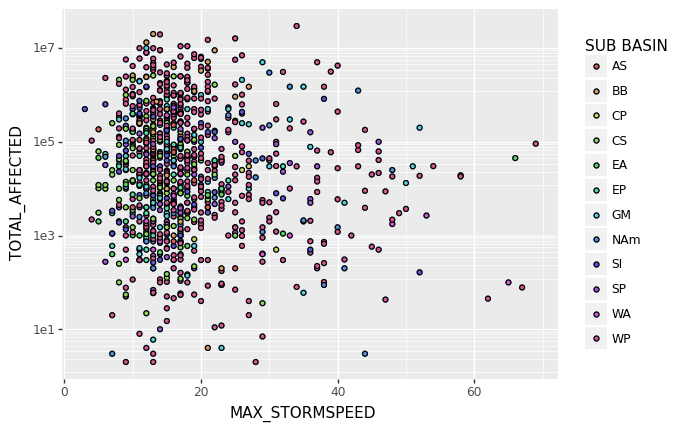

<ggplot: (8785614400660)>


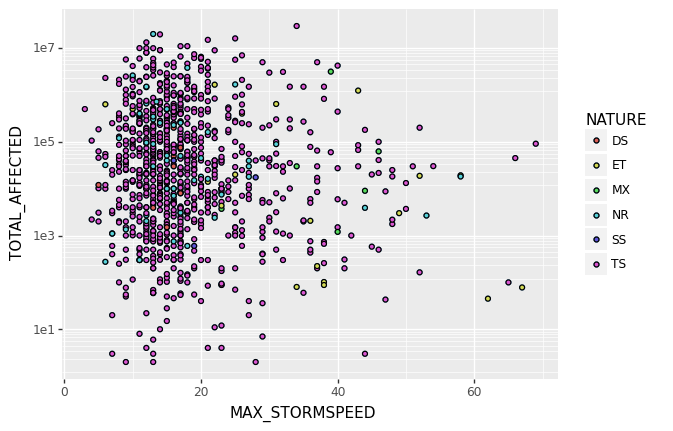

<ggplot: (8785614416581)>


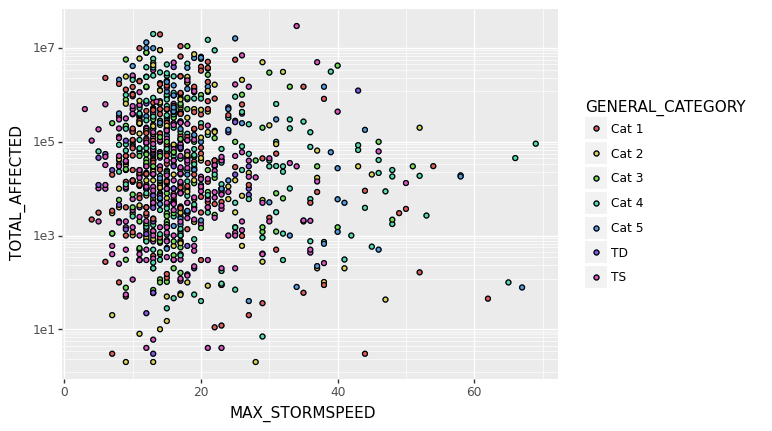

<ggplot: (8785614390911)>


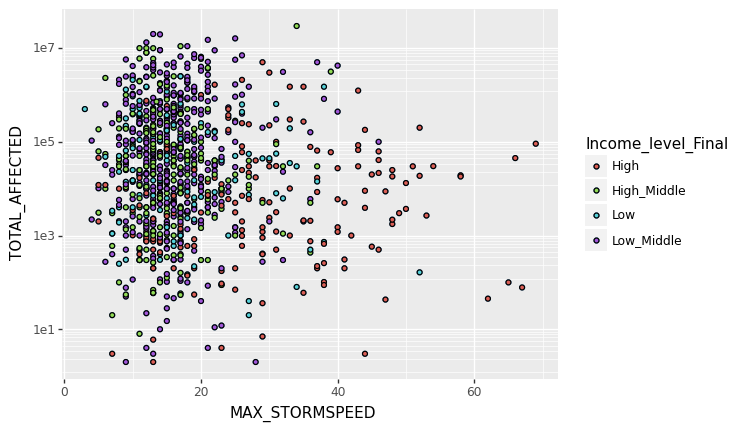

<ggplot: (8785614416581)>


In [0]:
#############################################################################
#############################################################################
################ Numerical Features With NaNs ###############################
#############################################################################
#############################################################################
### MAX_STORMSPEED

df['MAX_STORMSPEED'] = SimpleImputer(missing_values=np.nan, 
                                                              strategy='median').fit_transform(np.array(
    df['MAX_STORMSPEED']).reshape(-1, 1))
                                                            
df['MAX_STORMSPEED'] = SimpleImputer(missing_values=0, 
                                                              strategy='median').fit_transform(np.array(
    df['MAX_STORMSPEED']).reshape(-1, 1))   


#df['MAX_STORMSPEED'] = np.log10(df['MAX_STORMSPEED'] + 1)


print(ggplot(df, aes(x='MAX_STORMSPEED'))
 + geom_histogram(fill='steelblue')
 + scale_x_log10())

plotBiMulti('MAX_STORMSPEED', scale_x=0, scale_y=True)

## Arable land (hectares per person)

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 59'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


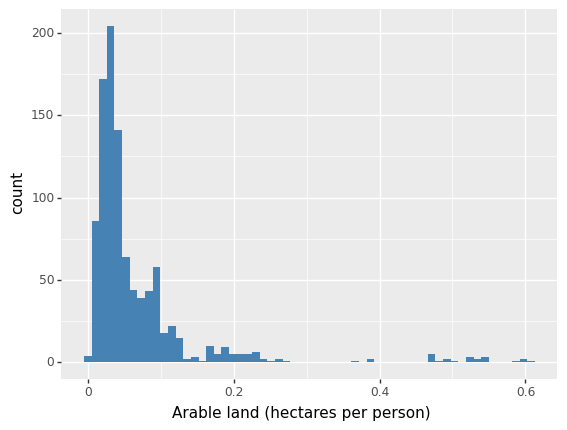

<ggplot: (-9223363251240043481)>


In [0]:
## Arable land (hectares per person) ---- 0.09950248756218905

df['Arable land (hectares per person)'] = SimpleImputer(missing_values=np.nan, 
                                                        strategy='most_frequent').fit_transform(np.array(
    df['Arable land (hectares per person)']).reshape(-1, 1))
                                                        
df['Arable land (hectares per person)'] = np.log10(df['Arable land (hectares per person)'] + 1)

print(ggplot(df, aes(x='Arable land (hectares per person)'))
 + geom_histogram(fill='steelblue'))

Correlation -  -0.08297289675955956


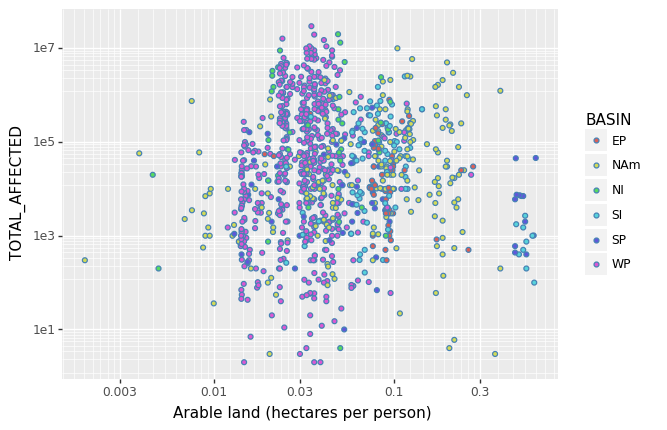

<ggplot: (8785618629440)>


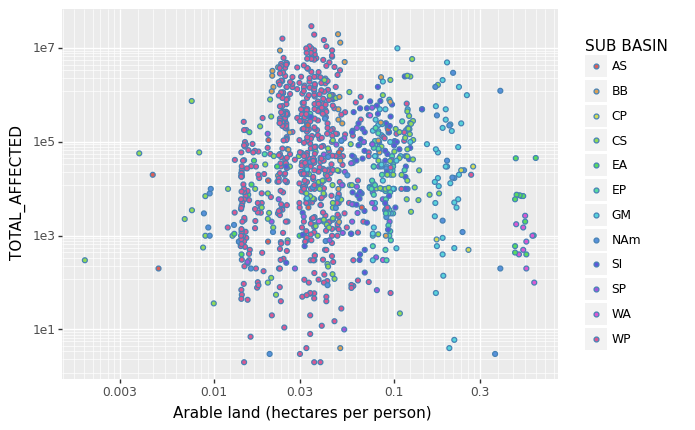

<ggplot: (8785618629594)>


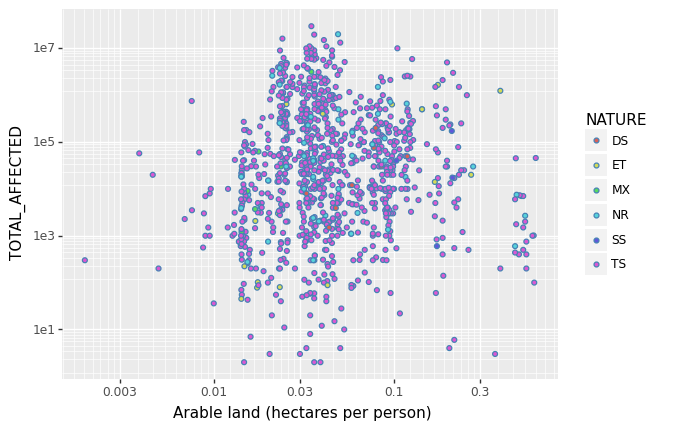

<ggplot: (-9223363251242513562)>


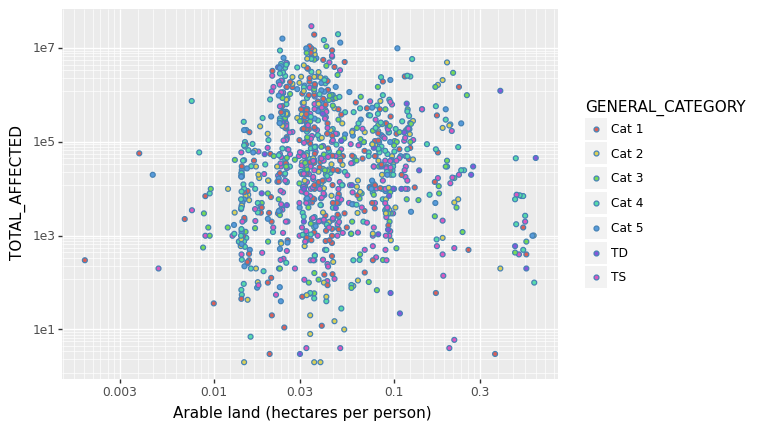

<ggplot: (8785612652755)>


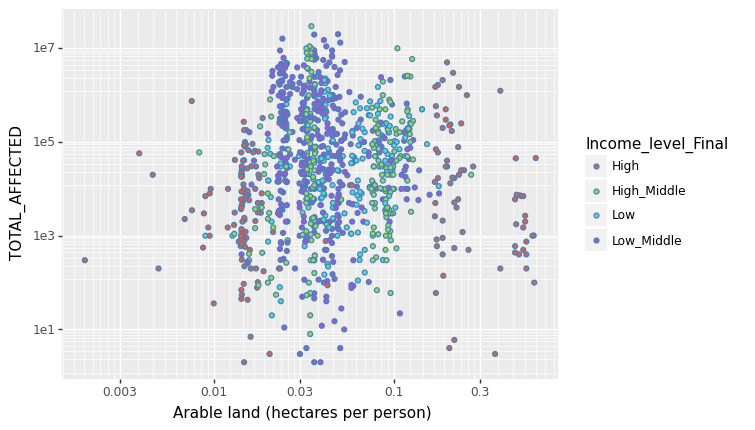

<ggplot: (8785612510966)>
{'lower': array([], dtype=int64), 'upper': array([  6,  35,  42,  61,  92,  97, 139, 166, 172, 211, 220, 247, 257,
       260, 290, 307, 309, 312, 321, 328, 334, 357, 358, 360, 365, 377,
       379, 383, 388, 393, 406, 412, 417, 419, 453, 458, 470, 480, 481,
       483, 496, 507, 519, 539, 545, 555, 563, 565, 566, 579, 642, 648,
       654, 658, 660, 674, 689, 720, 737, 739, 755, 767, 777, 783, 830,
       850, 851, 878, 894, 904, 916, 927, 932, 941, 972, 977]), 'q_both': [-0.051774649698300895, 0.15366235026126754], 'min-max': [0.001911047828764563, 0.6095274550624196]}


In [0]:
plotBiMulti('Arable land (hectares per person)', scale_x=True, scale_y=True)
print(outlier_check(df['Arable land (hectares per person)']))

## Food production index (2004-2006 = 100)

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 25'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 4 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


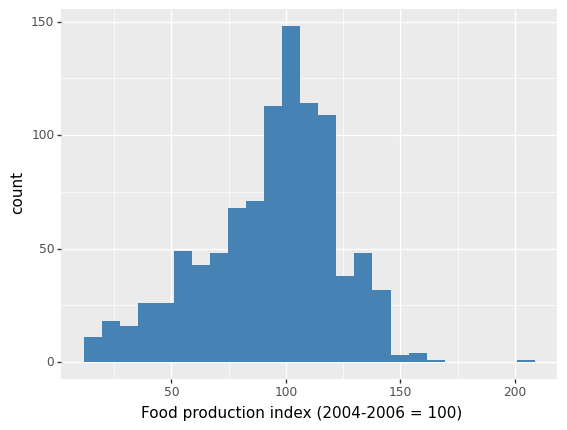

<ggplot: (8785612153548)>


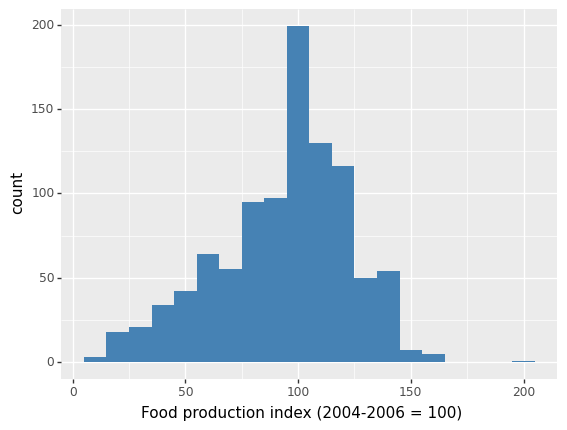

<ggplot: (-9223363251240052287)>


In [0]:
## Food production index (2004-2006 = 100)

print(ggplot(df, aes(x='Food production index (2004-2006 = 100)'))
 + geom_histogram(fill='steelblue'))


df['Food production index (2004-2006 = 100)'] = SimpleImputer(missing_values=np.nan, 
                                                              strategy='median').fit_transform(np.array(
    df['Food production index (2004-2006 = 100)']).reshape(-1, 1))


print(ggplot(df, aes(x='Food production index (2004-2006 = 100)'))
 + geom_histogram(fill='steelblue', binwidth=10))

Correlation -  0.04891711679199337


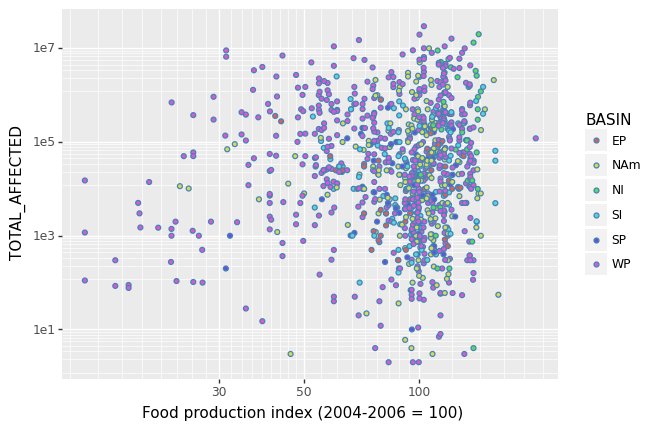

<ggplot: (8785612335175)>


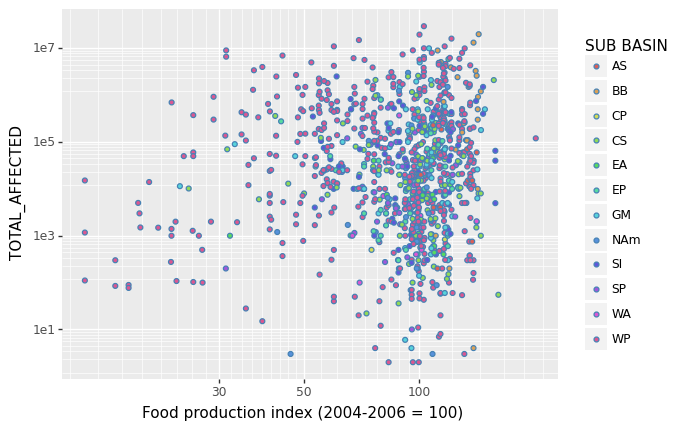

<ggplot: (-9223363251242264860)>


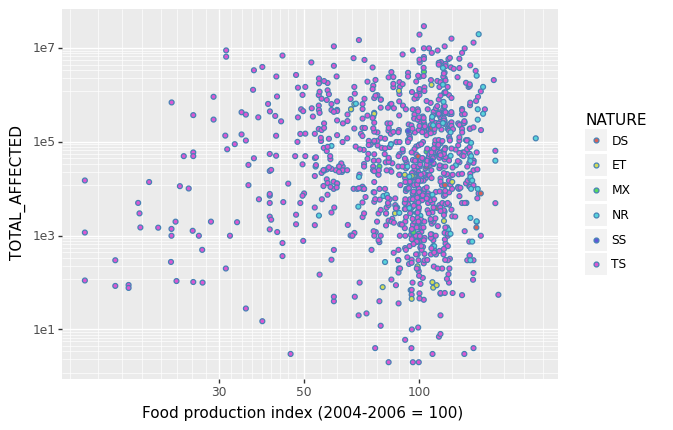

<ggplot: (-9223363251242356220)>


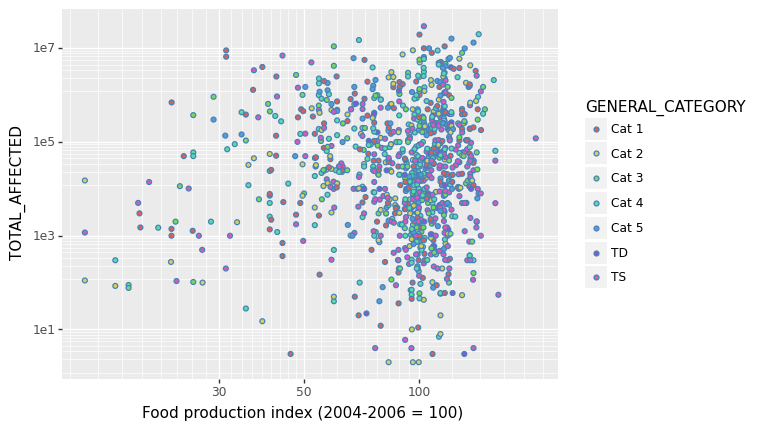

<ggplot: (-9223363251240361384)>


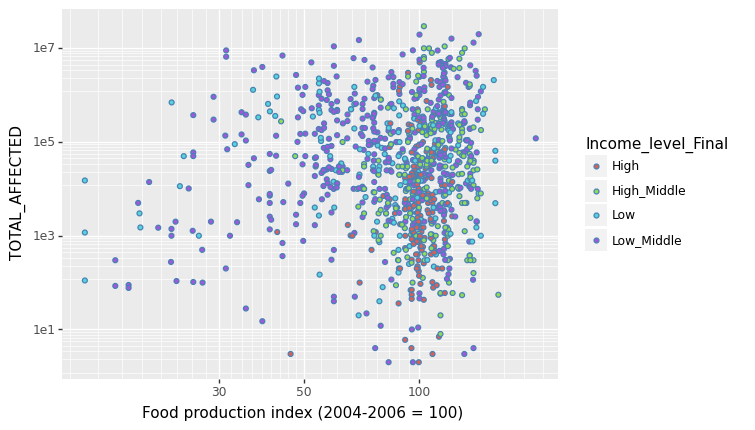

<ggplot: (8785611857700)>
{'lower': array([ 7,  9, 12, 16, 17, 20, 23, 26, 36, 39]), 'upper': array([965]), 'q_both': [19.5375, 170.5975], 'min-max': [13.36, 202.3770886]}


In [0]:
plotBiMulti('Food production index (2004-2006 = 100)', 
            scale_x=True, scale_y=True)
print(outlier_check(df['Food production index (2004-2006 = 100)']))

## GDP per capita (constant 2010 US$)

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 57'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 9 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


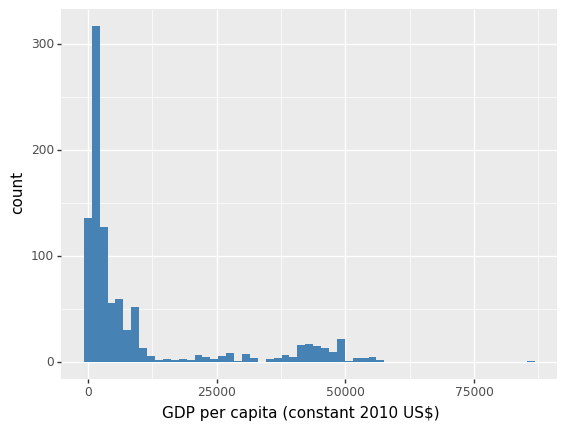

<ggplot: (-9223363251242944610)>


/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 58'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


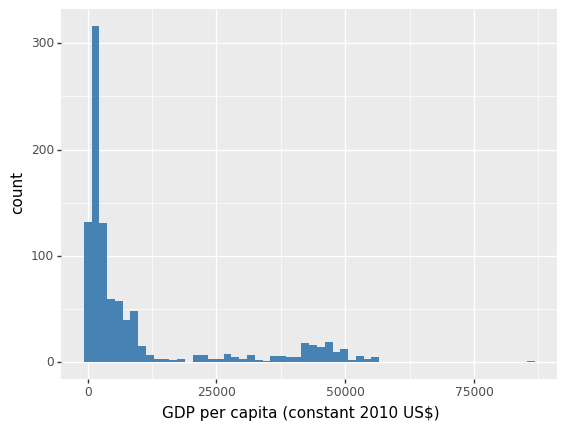

<ggplot: (-9223363251242918119)>


In [0]:
## GDP per capita (constant 2010 US$)

print(ggplot(df, aes(x='GDP per capita (constant 2010 US$)'))
 + geom_histogram(fill='steelblue'))


imp_mean_gdp = SimpleImputer(missing_values=np.nan, strategy='median')
df['GDP per capita (constant 2010 US$)'] = imp_mean_gdp.fit_transform(np.array(
    df['GDP per capita (constant 2010 US$)']).reshape(-1, 1))


print(ggplot(df, aes(x='GDP per capita (constant 2010 US$)'))
 + geom_histogram(fill='steelblue'))

Correlation -  -0.22036716309900495


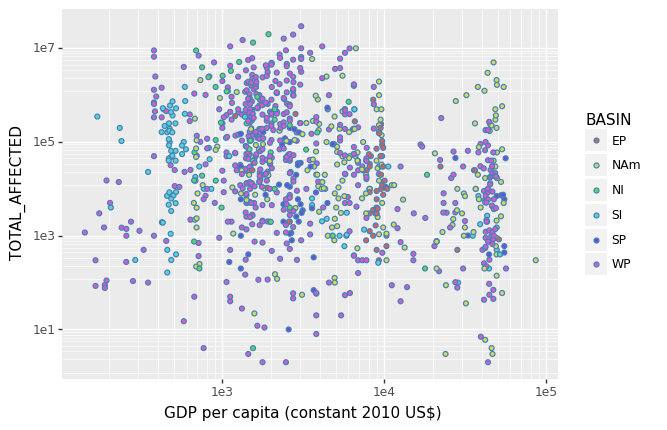

<ggplot: (-9223363251242930821)>


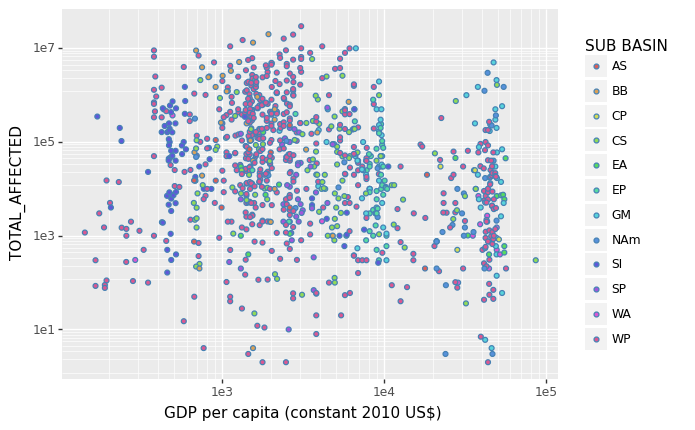

<ggplot: (-9223363251243127534)>


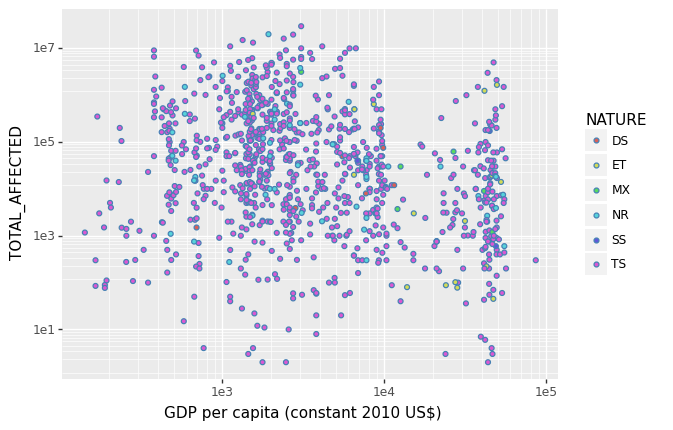

<ggplot: (8785611831181)>


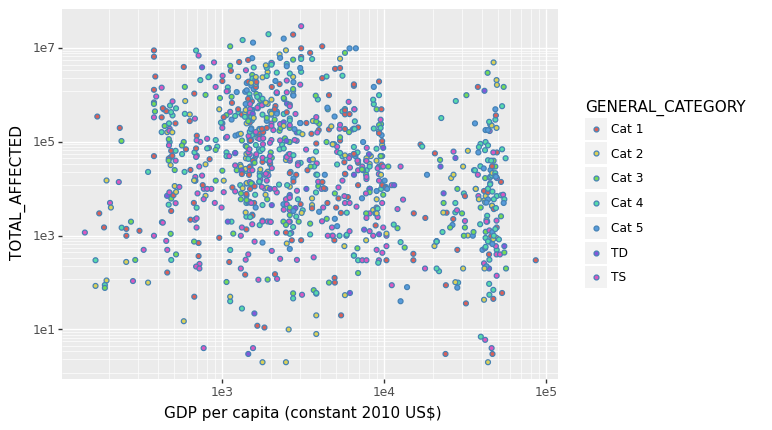

<ggplot: (8785611921016)>


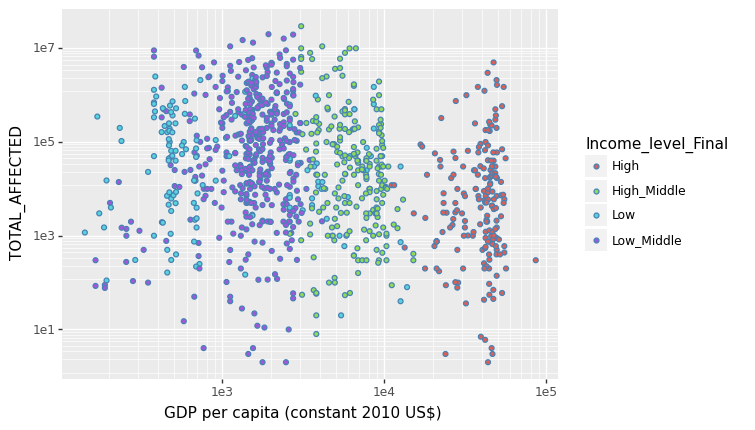

<ggplot: (8785611418288)>
{'lower': array([], dtype=int64), 'upper': array([ 24,  29,  35,  61,  77,  81,  86,  87,  92,  96, 116, 121, 122,
       132, 134, 135, 139, 146, 163, 164, 166, 170, 172, 177, 191, 211,
       219, 220, 233, 247, 248, 256, 257, 260, 277, 290, 304, 307, 309,
       312, 317, 318, 321, 328, 333, 334, 337, 349, 357, 358, 360, 361,
       365, 366, 368, 377, 379, 383, 384, 388, 393, 394, 404, 412, 417,
       419, 427, 429, 438, 446, 447, 453, 456, 458, 470, 475, 478, 480,
       481, 483, 492, 496, 499, 501, 502, 505, 506, 507, 508, 515, 518,
       519, 520, 521, 522, 538, 539, 542, 545, 555, 556, 563, 565, 566,
       579, 581, 596, 604, 609, 614, 642, 648, 654, 656, 658, 660, 661,
       662, 674, 688, 689, 695, 709, 720, 726, 734, 736, 737, 738, 739,
       740, 755, 767, 768, 769, 770, 777, 783, 800, 802, 807, 812, 824,
       829, 830, 839, 840, 850, 851, 855, 861, 865, 867, 878, 892, 893,
       894, 898, 901, 904, 916, 925, 927, 928, 932, 935, 939, 941, 

In [0]:
plotBiMulti('GDP per capita (constant 2010 US$)', 
            scale_x=True, scale_y=True)
print(outlier_check(df['GDP per capita (constant 2010 US$)']))

## Life expectancy at birth, total (years)

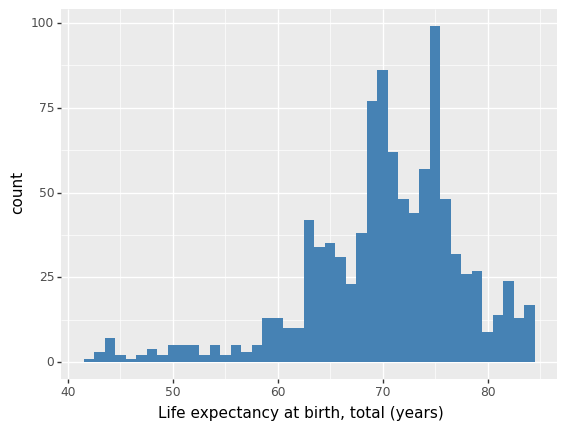

<ggplot: (8785611341460)>


In [0]:
### Life expectancy at birth, total (years)

df['Life expectancy at birth, total (years)'] = SimpleImputer(missing_values=np.nan, 
                                            strategy='median').fit_transform(
    np.array(df['Life expectancy at birth, total (years)']).reshape(-1, 1))

print(ggplot(df, aes(x='Life expectancy at birth, total (years)'))
 + geom_histogram(fill='steelblue', binwidth=1))


df['Expectancy_break'] = np.where(df['Life expectancy at birth, total (years)'] > 67, 1, 0)

Correlation -  -0.10846962645006317


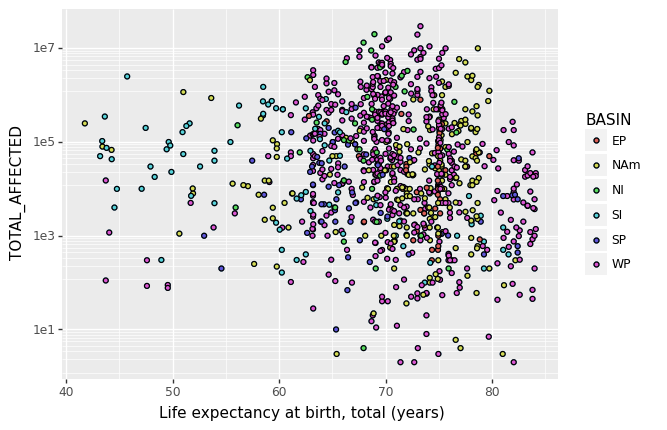

<ggplot: (-9223363251243275355)>


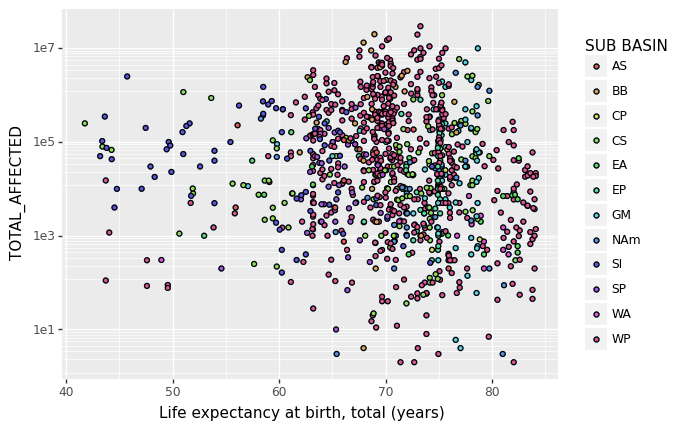

<ggplot: (8785611561662)>


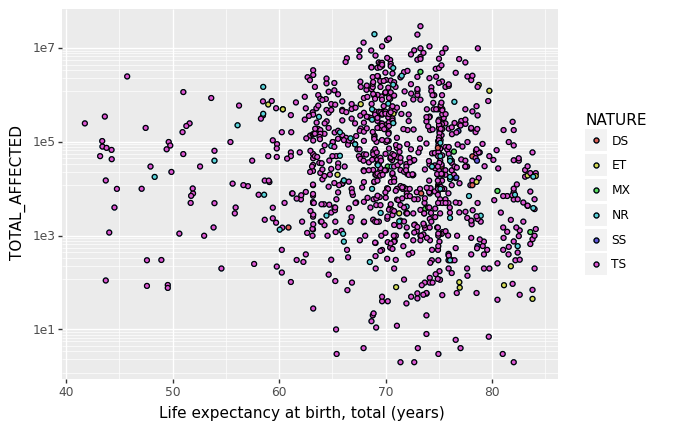

<ggplot: (8785611195954)>


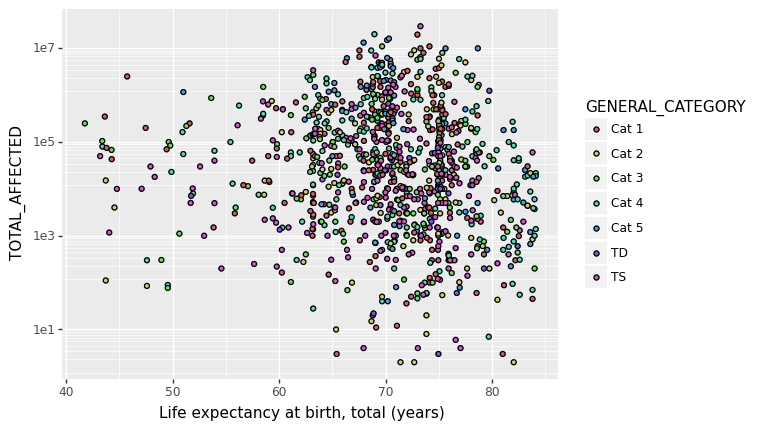

<ggplot: (8785611932101)>


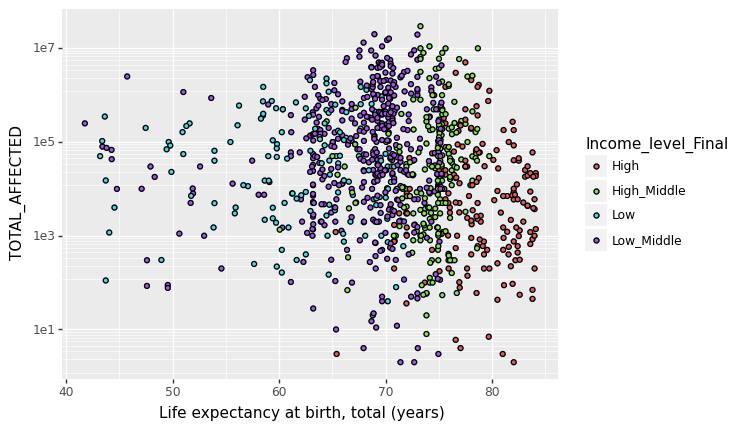

<ggplot: (-9223363251243496865)>
{'lower': array([  5,   7,   9,  12,  15,  16,  17,  20,  23,  26,  31,  33,  38,
        41,  42,  43,  44,  53,  76,  84, 101, 102, 107, 114, 128, 140,
       150, 154, 173, 197, 202, 228, 237, 326, 392, 464, 465, 593, 630,
       675]), 'upper': array([], dtype=int64), 'q_both': [53.782926825000004, 87.834243905], 'min-max': [41.762, 84.0997561]}


In [0]:
plotBiMulti('Life expectancy at birth, total (years)', 
            scale_x=False, scale_y=True)
print(outlier_check(df['Life expectancy at birth, total (years)']))

## POP_MAX_34_ADJ

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 46'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 80 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


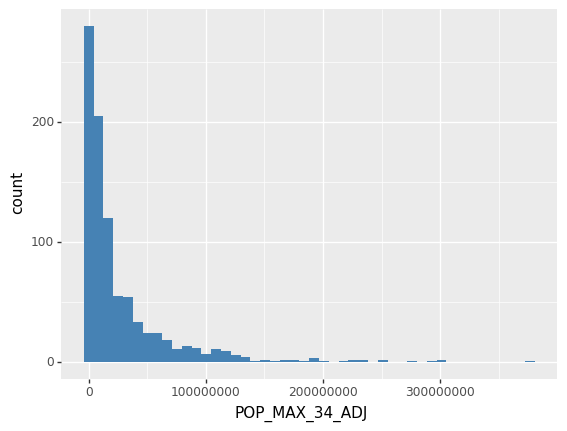

<ggplot: (8785611574059)>


/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 72'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


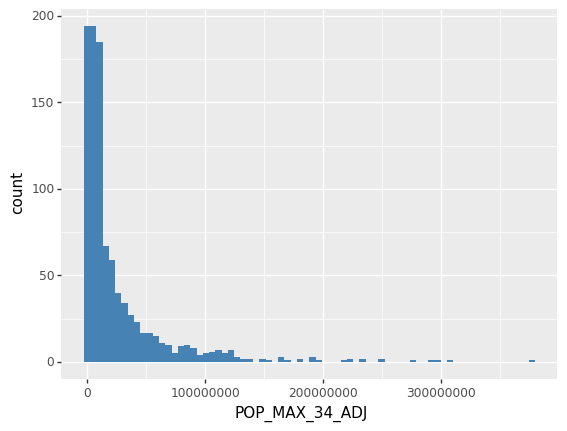

<ggplot: (-9223363251243476378)>


In [0]:
## POP_MAX_34_ADJ

print(ggplot(df, aes(x='POP_MAX_34_ADJ'))
 + geom_histogram(fill='steelblue'))


df['POP_MAX_34_ADJ'] = SimpleImputer(missing_values=np.nan, 
                                            strategy='median').fit_transform(
    np.array(df['POP_MAX_34_ADJ']).reshape(-1, 1))
                                            

df['POP_MAX_34_ADJ'] = SimpleImputer(missing_values=0.0, 
                                            strategy='median').fit_transform(
    np.array(df['POP_MAX_34_ADJ']).reshape(-1, 1))
                                            
                                            
#df['POP_MAX_34_ADJ'] = np.log10(df['POP_MAX_34_ADJ'] + 1)
                                            
                                            
print(ggplot(df, aes(x='POP_MAX_34_ADJ'))
 + geom_histogram(fill='steelblue'))

Correlation -  0.19187762145398446


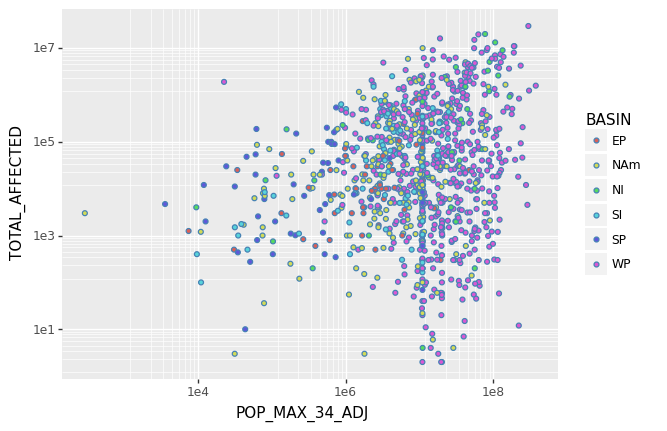

<ggplot: (8785611851591)>


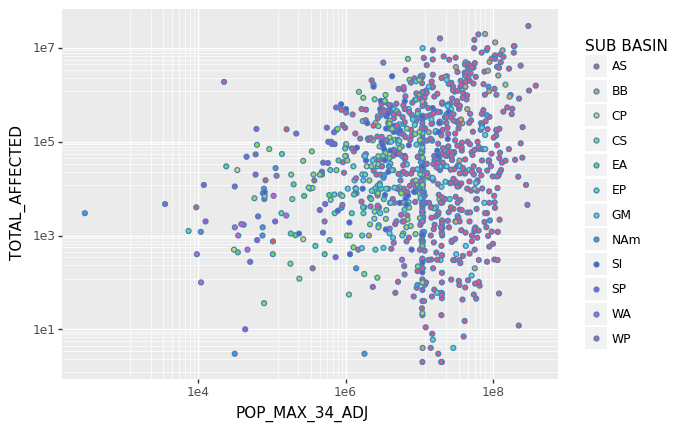

<ggplot: (-9223363251243281804)>


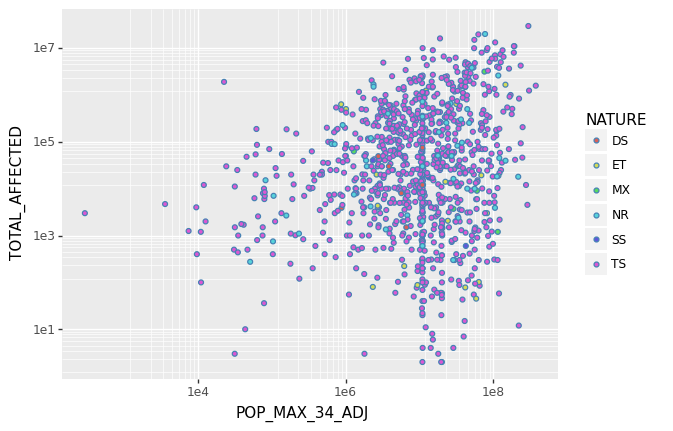

<ggplot: (-9223363251242383416)>


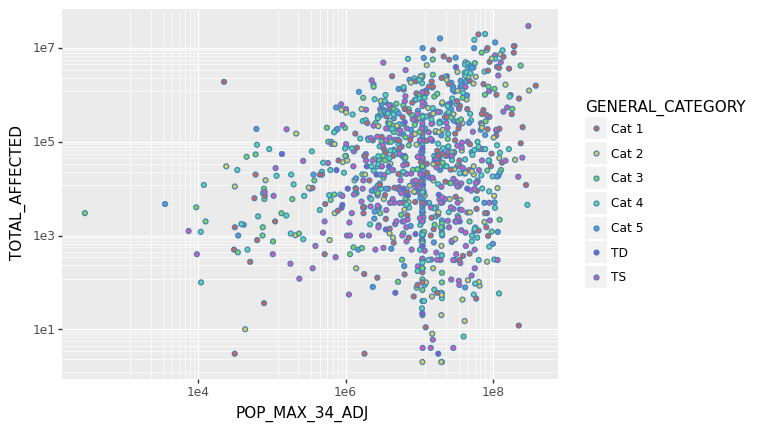

<ggplot: (8785680617501)>


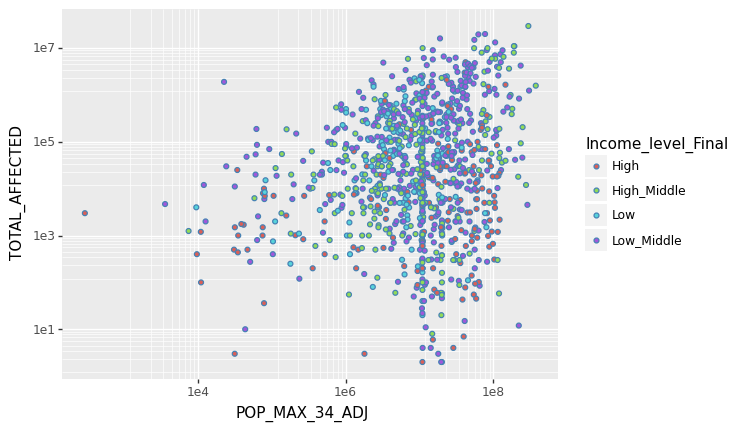

<ggplot: (-9223363251242924144)>
{'lower': array([], dtype=int64), 'upper': array([ 34,  36,  39,  58, 145, 176, 200, 221, 242, 259, 278, 288, 293,
       300, 315, 331, 347, 380, 381, 385, 397, 402, 403, 419, 427, 429,
       447, 450, 472, 475, 477, 481, 495, 504, 519, 520, 522, 536, 537,
       543, 569, 570, 574, 575, 577, 596, 598, 603, 604, 619, 631, 638,
       643, 658, 660, 665, 681, 687, 695, 711, 713, 729, 737, 740, 756,
       759, 760, 770, 777, 778, 793, 797, 798, 802, 805, 808, 809, 823,
       824, 836, 839, 840, 841, 860, 862, 864, 869, 881, 890, 897, 900,
       908, 920, 929, 932, 935, 945, 961, 966, 970, 971, 972, 974, 977,
       990]), 'q_both': [-35793076.309999995, 69102547.49], 'min-max': [295.6025692, 376497216.0]}


In [0]:
plotBiMulti('POP_MAX_34_ADJ', 
            scale_x=True, scale_y=True)
print(outlier_check(df['POP_MAX_34_ADJ']))

## POP_MAX_50_ADJ

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 73'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 80 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


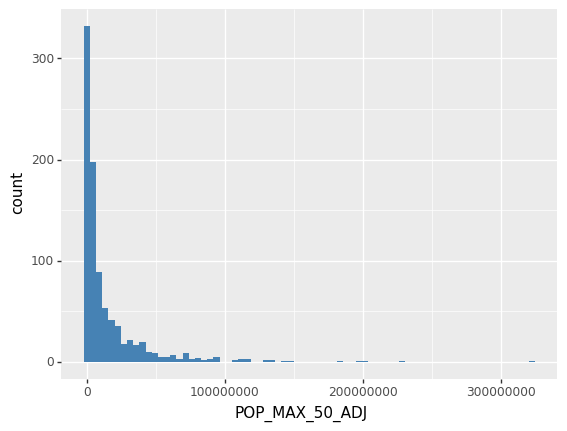

<ggplot: (-9223363251242612806)>


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


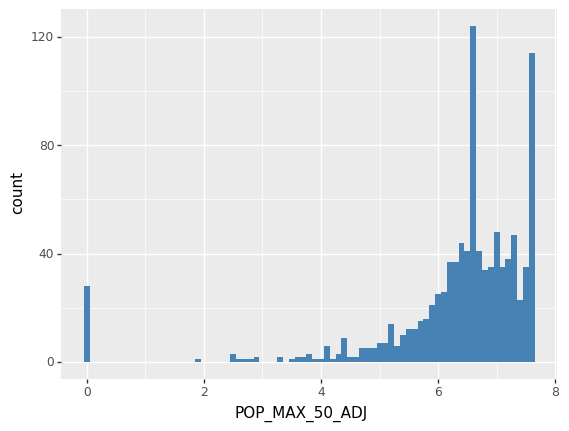

<ggplot: (-9223363251242123183)>


In [0]:
### POP_MAX_50_ADJ

print(ggplot(df, aes(x='POP_MAX_50_ADJ'))
 + geom_histogram(fill='steelblue'))


df['POP_MAX_50_ADJ'] = SimpleImputer(missing_values=np.nan, 
                                            strategy='median').fit_transform(
    np.array(df['POP_MAX_50_ADJ']).reshape(-1, 1))
                                            
clip_outliers(df['POP_MAX_50_ADJ'], outlier_check(df['POP_MAX_50_ADJ'])) 


df['POP_MAX_50_ADJ'] = np.log10(df['POP_MAX_50_ADJ'] + 1)


print(ggplot(df, aes(x='POP_MAX_50_ADJ'))
 + geom_histogram(fill='steelblue', binwidth=0.1))




Correlation -  0.13354706851713935


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


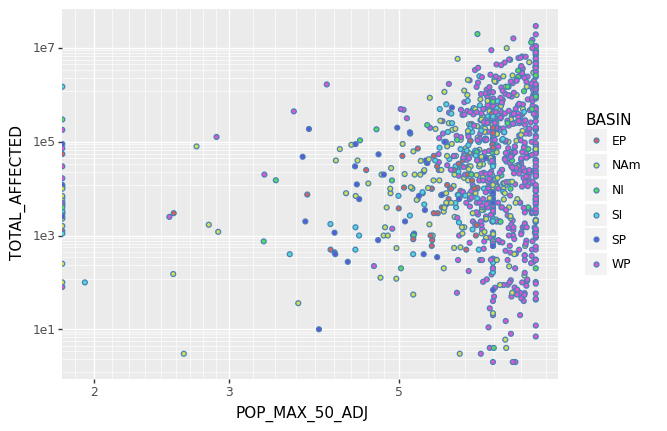

<ggplot: (-9223363251242207109)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


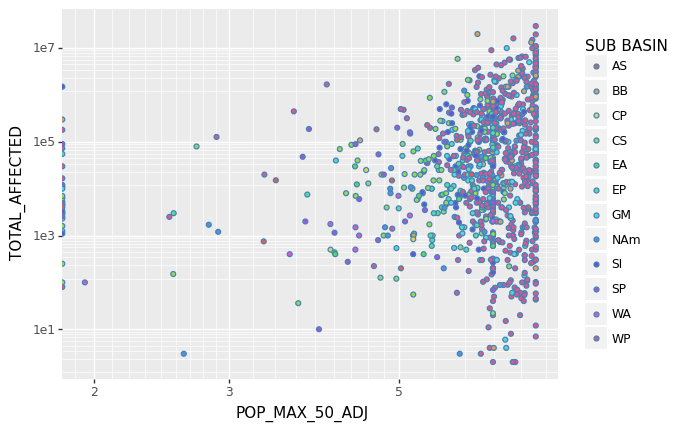

<ggplot: (8785612710604)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


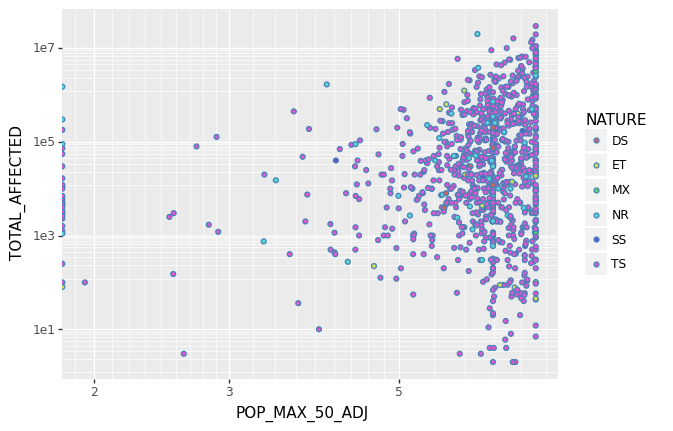

<ggplot: (8785614382961)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


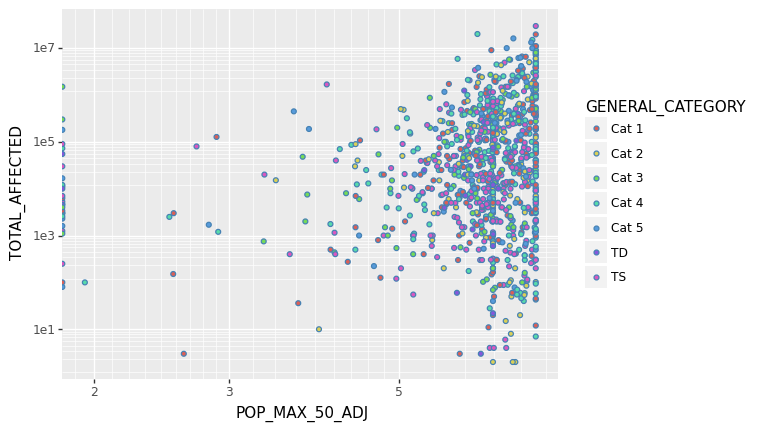

<ggplot: (-9223363251243416071)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


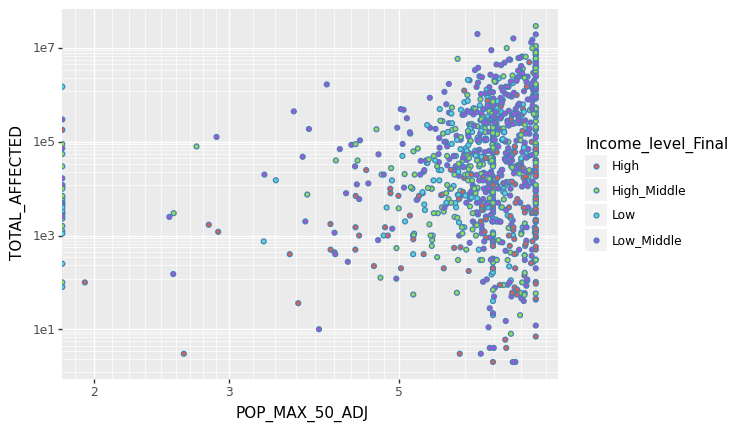

<ggplot: (8785612041543)>
{'lower': array([ 24,  27,  29,  42,  57,  65,  92, 103, 130, 139, 142, 186, 196,
       198, 211, 241, 252, 256, 267, 271, 294, 328, 335, 369, 372, 404,
       436, 438, 454, 462, 469, 534, 546, 552, 563, 566, 599, 614, 617,
       635, 644, 650, 662, 674, 676, 699, 723, 731, 804, 822, 832, 850,
       852, 858, 875, 886, 896, 917, 919, 922, 955, 956, 958, 959, 963,
       978, 979, 986, 987]), 'upper': array([], dtype=int64), 'q_both': [4.475239605579221, 8.79777981704518], 'min-max': [0.0, 7.552577313892013]}


In [0]:
plotBiMulti('POP_MAX_50_ADJ', 
            scale_x=True, scale_y=True)
print(outlier_check(df['POP_MAX_50_ADJ']))

## POP_MAX_64_ADJ

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 65'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 80 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


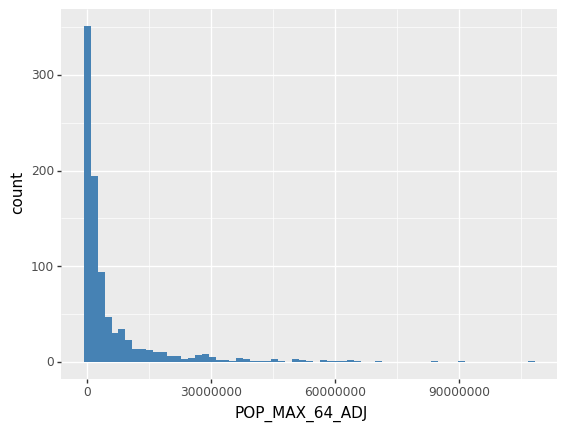

<ggplot: (-9223363251243443845)>


/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 35'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


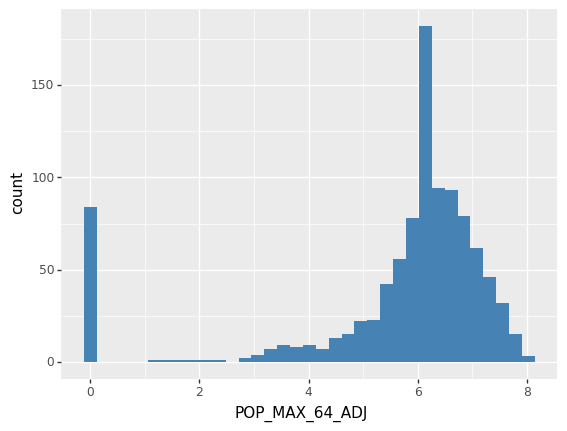

<ggplot: (8785612284385)>


In [0]:
### ### POP_MAX_64_ADJ

print(ggplot(df, aes(x='POP_MAX_64_ADJ'))
 + geom_histogram(fill='steelblue'))


df['POP_MAX_64_ADJ'] = SimpleImputer(missing_values=np.nan, 
                                            strategy='median').fit_transform(
    np.array(df['POP_MAX_64_ADJ']).reshape(-1, 1))
                                            

df['POP_MAX_64_ADJ'] = np.log10(df['POP_MAX_64_ADJ'] + 1)
    
                                            

print(ggplot(df, aes(x='POP_MAX_64_ADJ'))
 + geom_histogram(fill='steelblue'))


Correlation -  0.1592285035604946


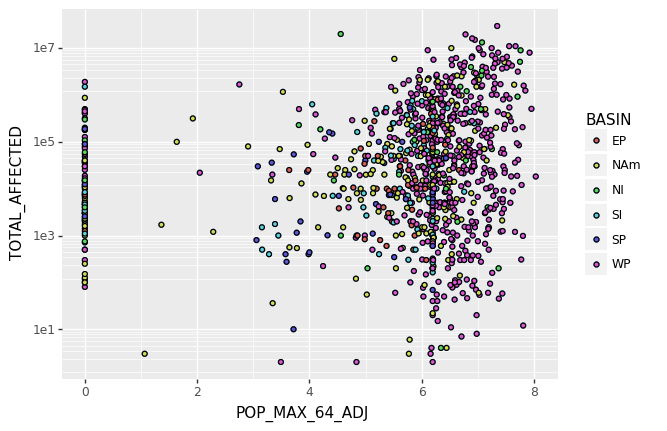

<ggplot: (8785612392533)>


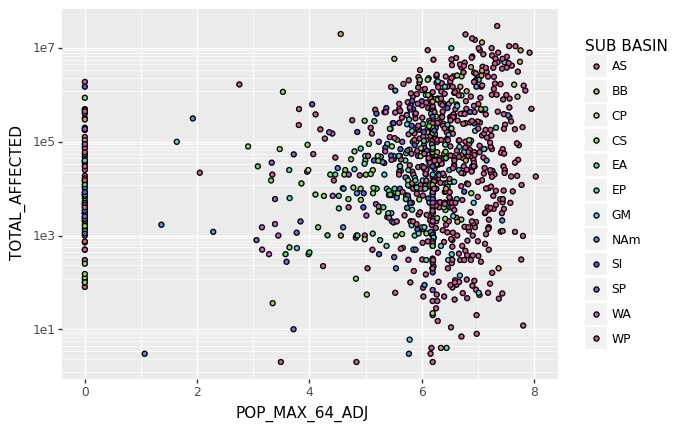

<ggplot: (8785612392666)>


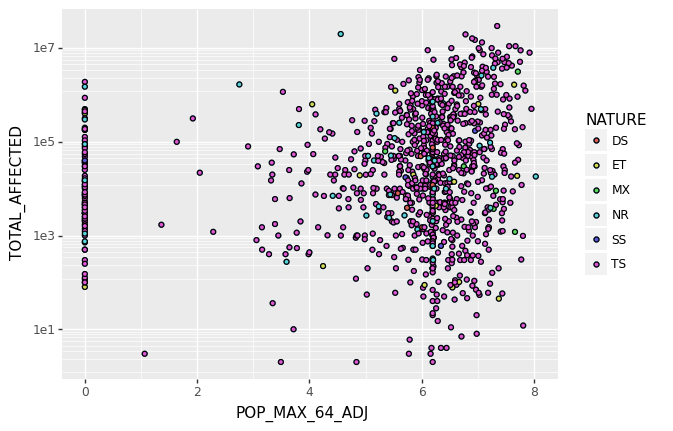

<ggplot: (-9223363251242491616)>


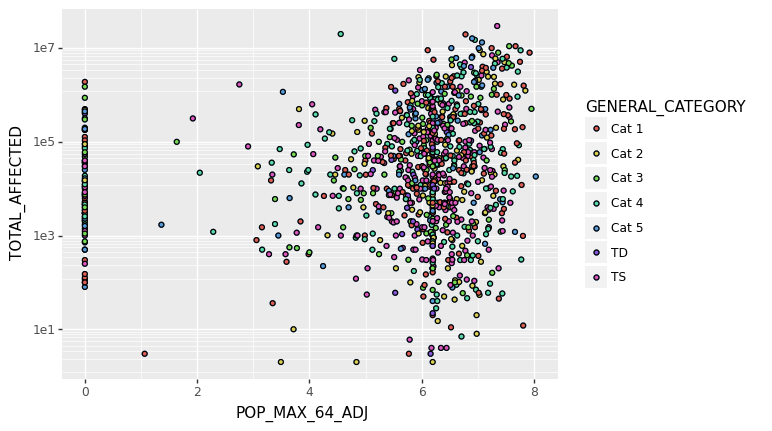

<ggplot: (8785611876079)>


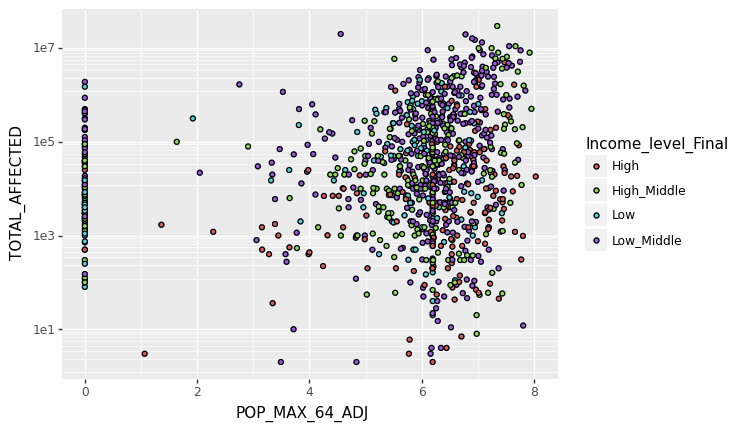

<ggplot: (-9223363251242388543)>
{'lower': array([ 24,  27,  29,  42,  65,  70,  92, 103, 104, 106, 114, 115, 123,
       124, 130, 131, 139, 141, 142, 148, 149, 153, 162, 177, 179, 186,
       192, 193, 196, 198, 202, 211, 230, 241, 252, 256, 267, 271, 276,
       294, 317, 328, 329, 335, 344, 369, 371, 372, 401, 402, 404, 418,
       420, 423, 438, 448, 454, 462, 469, 488, 489, 498, 503, 510, 512,
       517, 531, 534, 546, 552, 554, 563, 566, 578, 599, 600, 617, 635,
       644, 650, 655, 662, 674, 676, 699, 718, 723, 731, 768, 784, 804,
       822, 832, 849, 852, 858, 866, 875, 886, 896, 917, 919, 922, 930,
       950, 955, 956, 958, 959, 963, 978, 979, 986, 987]), 'upper': array([], dtype=int64), 'q_both': [3.769264913324396, 8.464463604947433], 'min-max': [0.0, 8.030877115557198]}


In [0]:
plotBiMulti('POP_MAX_64_ADJ', 
            scale_x=0, scale_y=1)
print(outlier_check(df['POP_MAX_64_ADJ']))

## Adjusted savings: education expenditure (% of GNI)

/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 10 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


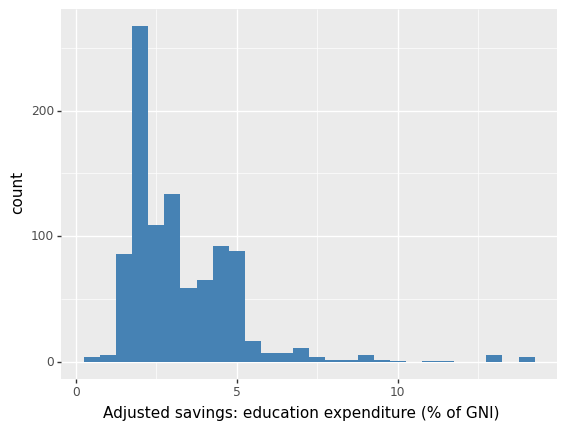

<ggplot: (8785611932045)>


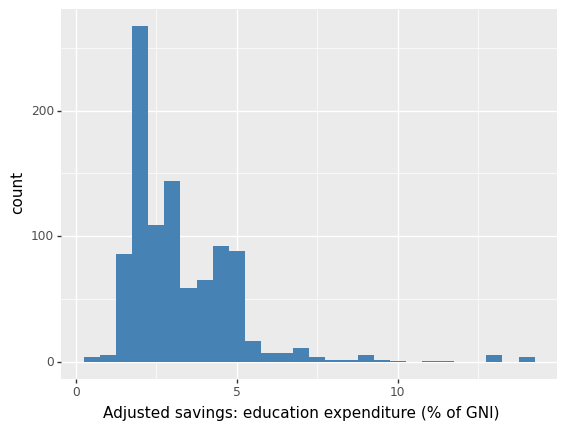

<ggplot: (-9223363251243126447)>


In [0]:
## Adjusted savings: education expenditure (% of GNI)
print(ggplot(df, aes(x='Adjusted savings: education expenditure (% of GNI)'))
 + geom_histogram(fill='steelblue', binwidth=0.5))


df['Adjusted savings: education expenditure (% of GNI)'] = SimpleImputer(missing_values=np.nan, 
                                            strategy='median').fit_transform(
    np.array(df['Adjusted savings: education expenditure (% of GNI)']).reshape(-1, 1))


print(ggplot(df, aes(x='Adjusted savings: education expenditure (% of GNI)'))
 + geom_histogram(fill='steelblue', binwidth=0.5))

Correlation -  -0.11903380478614217


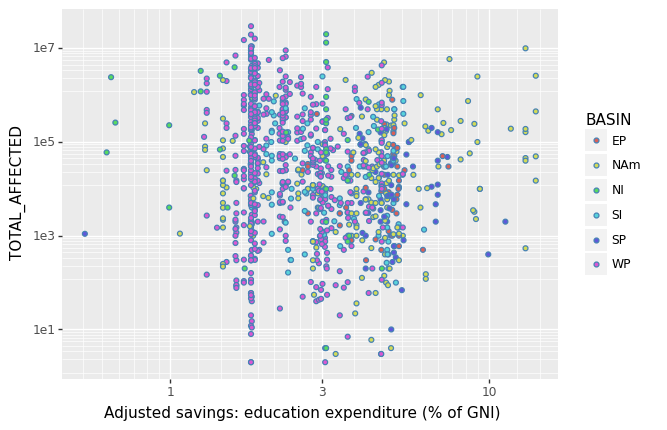

<ggplot: (8785611359496)>


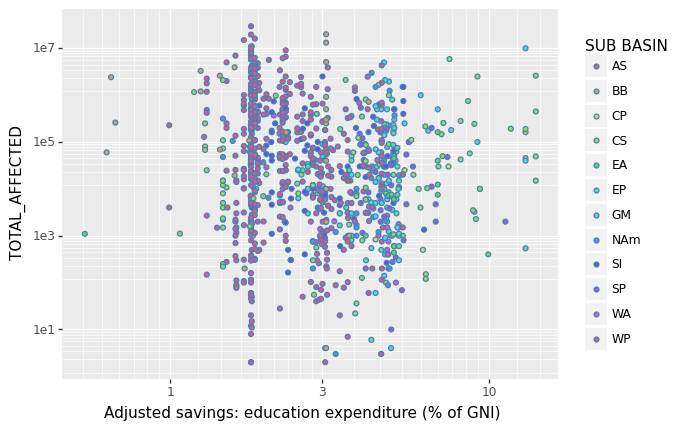

<ggplot: (8785611097015)>


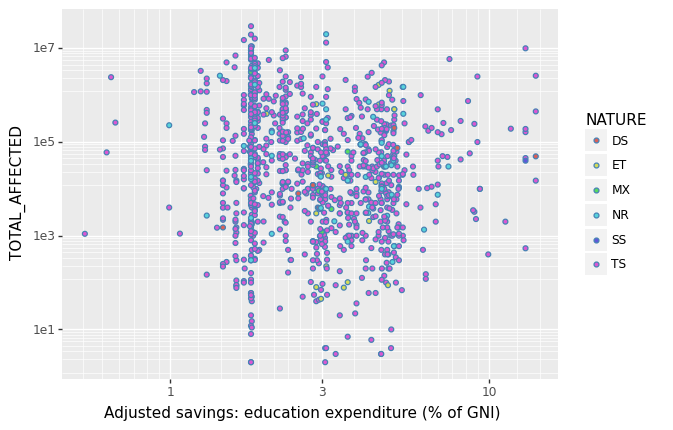

<ggplot: (8785612423656)>


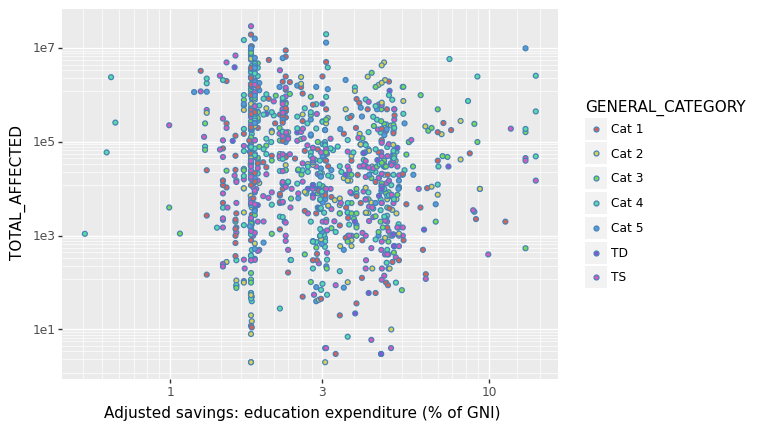

<ggplot: (8785617386774)>


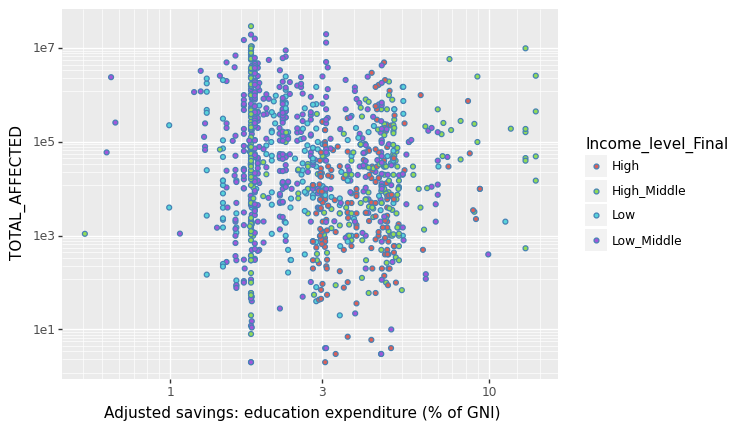

<ggplot: (-9223363251242125354)>
{'lower': array([], dtype=int64), 'upper': array([120, 219, 318, 337, 451, 457, 497, 509, 515, 533, 554, 615, 647,
       653, 659, 672, 734, 766, 776, 858, 903, 931, 939, 959, 976]), 'q_both': [-1.805710319, 7.916183865], 'min-max': [0.538880795, 14.01]}


In [0]:
plotBiMulti('Adjusted savings: education expenditure (% of GNI)', 
            scale_x=True, scale_y=True)
print(outlier_check(df['Adjusted savings: education expenditure (% of GNI)']))

## Cereal yield (kg per hectare)

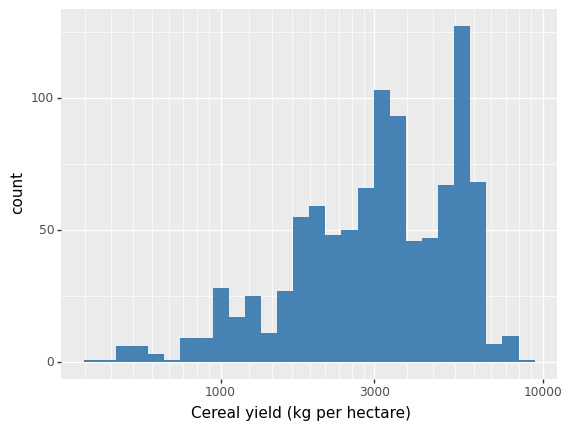

<ggplot: (-9223363251242734185)>


In [0]:
### Cereal yield (kg per hectare)
df['Cereal yield (kg per hectare)'] = SimpleImputer(missing_values=np.nan, 
                                            strategy='median').fit_transform(
    np.array(df['Cereal yield (kg per hectare)']).reshape(-1, 1))
                                            

print(ggplot(df, aes(x='Cereal yield (kg per hectare)'))
 + geom_histogram(fill='steelblue', binwidth=0.05)
 + scale_x_log10())

df["cereal_break"] = np.where(df['Cereal yield (kg per hectare)'].between(2500, 5000), 1, 0)
df["cereal_break_two"] = np.where(df['Cereal yield (kg per hectare)'] > 3650.0, 1, 0)



Correlation -  -0.07377341296113668


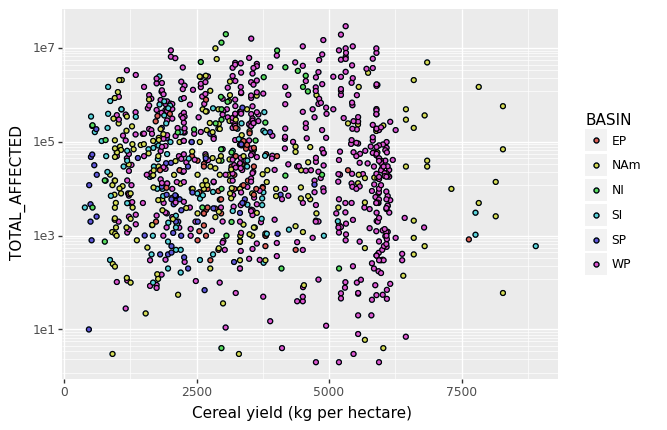

<ggplot: (8785611842252)>


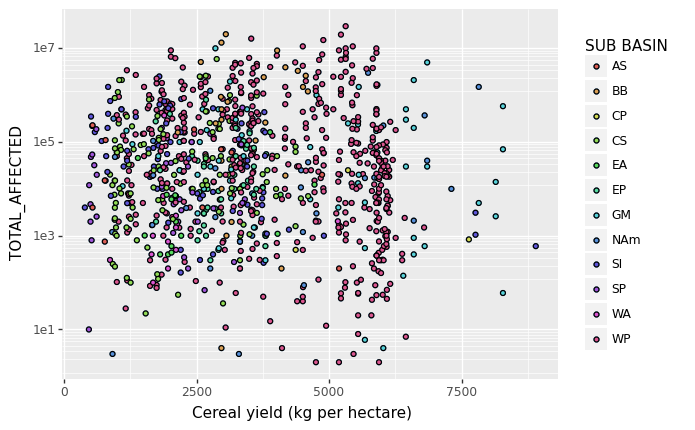

<ggplot: (-9223363251243210310)>


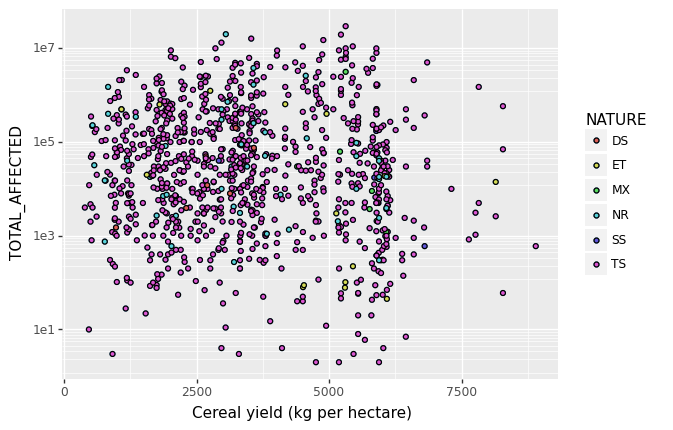

<ggplot: (8785612365902)>


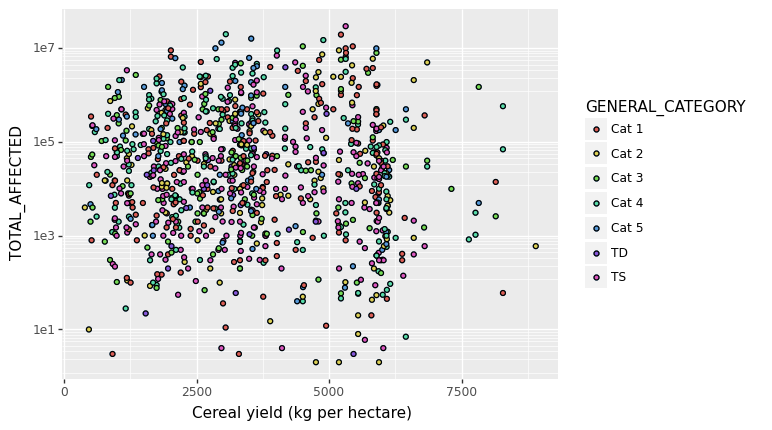

<ggplot: (8785612365867)>


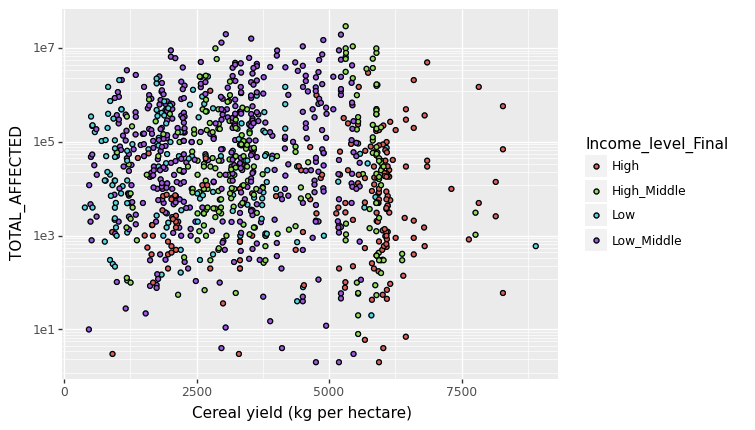

<ggplot: (-9223363251242615920)>
{'lower': array([], dtype=int64), 'upper': array([], dtype=int64), 'q_both': [-2167.725, 9178.474999999999], 'min-max': [393.3, 8900.0]}


In [0]:

plotBiMulti('Cereal yield (kg per hectare)', 
            scale_x=0, scale_y=True)
print(outlier_check(df['Cereal yield (kg per hectare)']))

# Numerical Features Without NaNs

In [0]:
#############################################################################
#############################################################################
################ Numerical Features Without NaNs ############################
#############################################################################
#############################################################################

## TOTAL_HOURS_EVENT

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 5 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


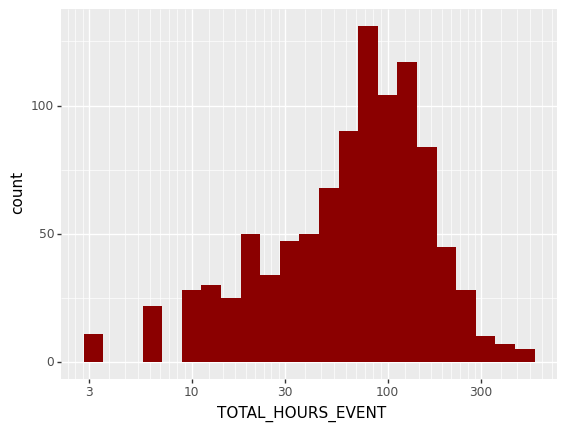

<ggplot: (8785611793549)>


In [0]:
## TOTAL_HOURS_EVENT
## Further investigate - may be outliers
print(ggplot(df, aes(x='TOTAL_HOURS_EVENT'))
 + geom_histogram(fill='darkred', binwidth=0.1)
 + scale_x_log10())

df['TOTAL_HOURS_EVENT'] = np.log10(df['TOTAL_HOURS_EVENT'] + 1)

Correlation -  0.09227614179267132


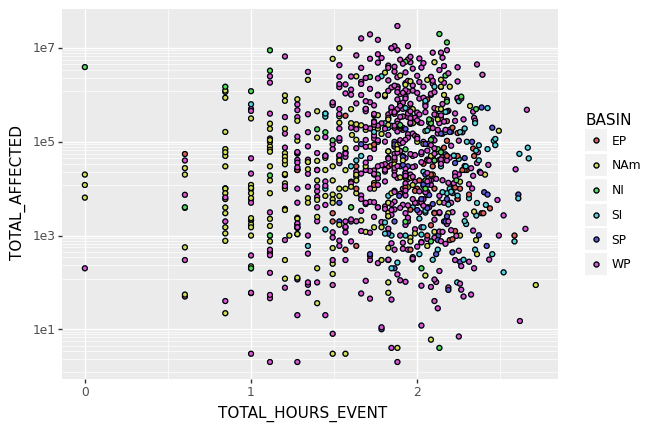

<ggplot: (8785612153366)>


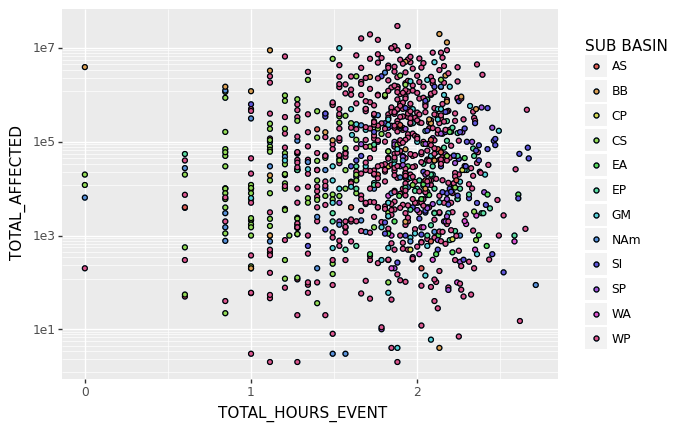

<ggplot: (-9223363251243216987)>


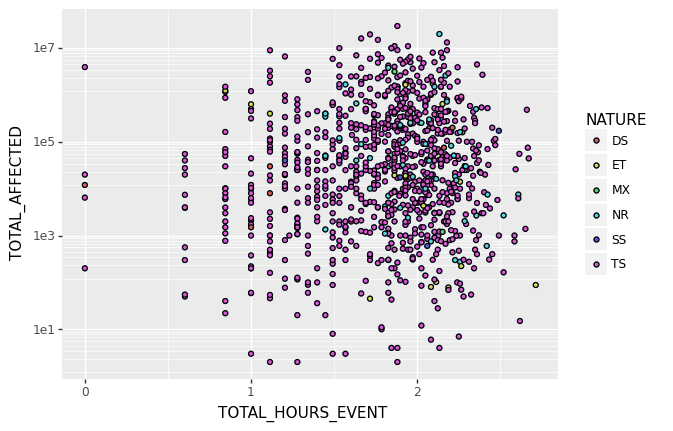

<ggplot: (8785612426339)>


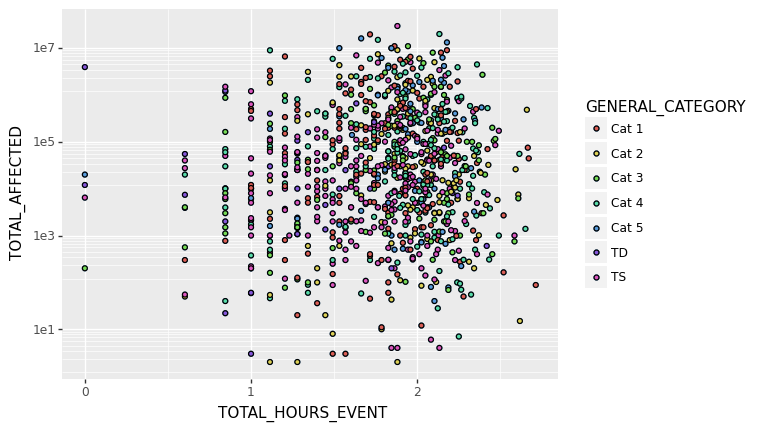

<ggplot: (-9223363251243285816)>


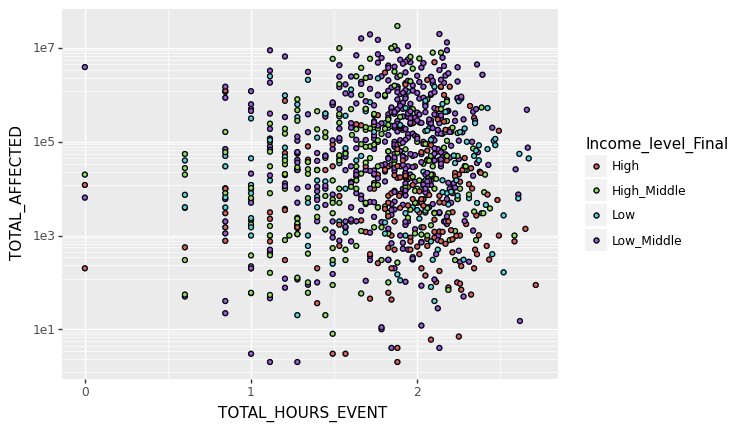

<ggplot: (8785611663750)>
{'lower': array([301, 401, 432, 433, 434, 448, 512, 602, 605, 635, 682, 710, 875,
       888, 928, 943]), 'upper': array([], dtype=int64), 'q_both': [0.6885647648622851, 2.936335837342205], 'min-max': [0.0, 2.7134905430939424]}


In [0]:
plotBiMulti('TOTAL_HOURS_EVENT', 
            scale_x=0, scale_y=1)
print(outlier_check(df['TOTAL_HOURS_EVENT']))

## TOTAL_HOURS_IN_LAND

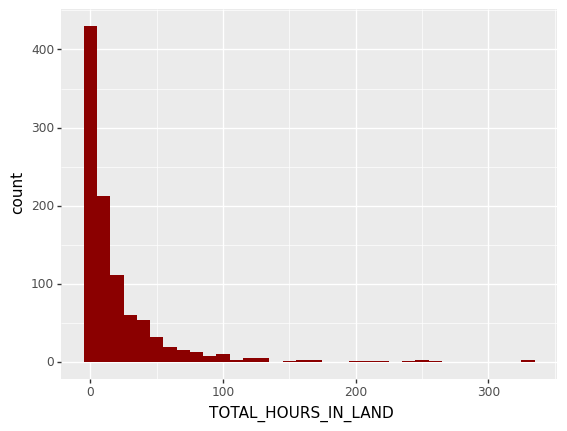

<ggplot: (-9223363251243407195)>


In [0]:
## TOTAL_HOURS_IN_LAND
print(ggplot(df, aes(x='TOTAL_HOURS_IN_LAND'))
 + geom_histogram(fill='darkred', binwidth=10))


df['TOTAL_HOURS_IN_LAND'] = np.log10(df['TOTAL_HOURS_IN_LAND'] + 1)

Correlation -  0.20109784391707536


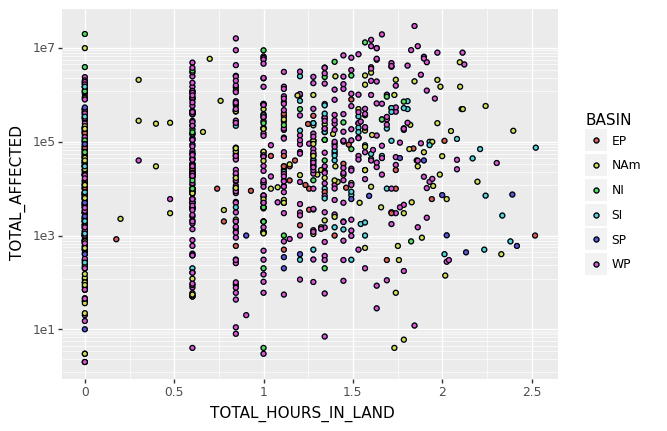

<ggplot: (8785612559343)>


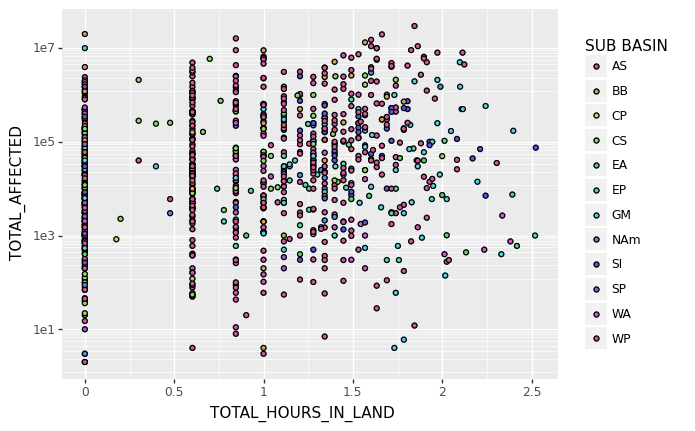

<ggplot: (-9223363251242933665)>


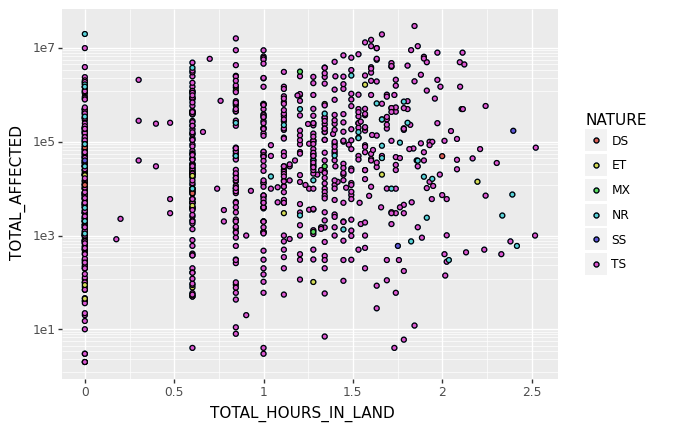

<ggplot: (-9223363251243407328)>


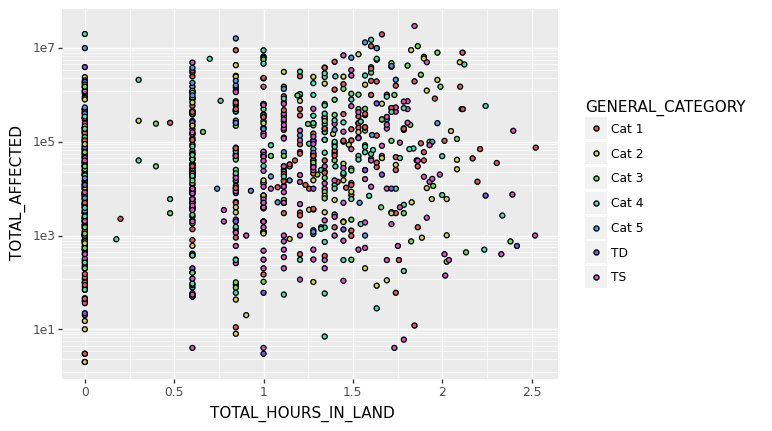

<ggplot: (-9223363251242933665)>


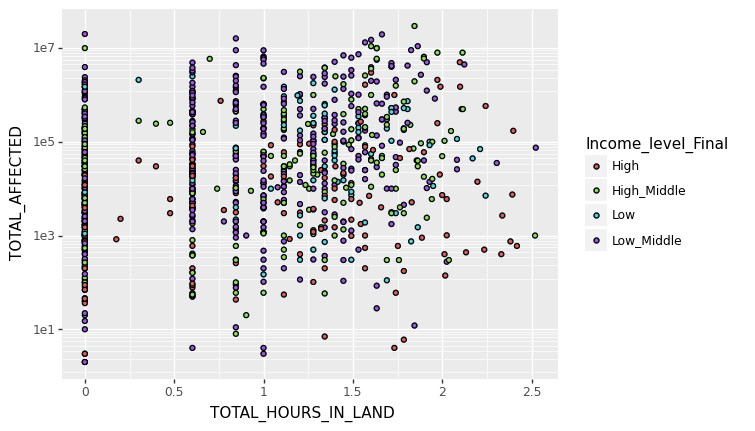

<ggplot: (8785614382898)>
{'lower': array([], dtype=int64), 'upper': array([], dtype=int64), 'q_both': [-2.0969100130080567, 3.4948500216800946], 'min-max': [0.0, 2.5237464668115646]}


In [0]:
plotBiMulti('TOTAL_HOURS_IN_LAND', 
            scale_x=0, scale_y=1)
print(outlier_check(df['TOTAL_HOURS_IN_LAND']))

## MONTH_START

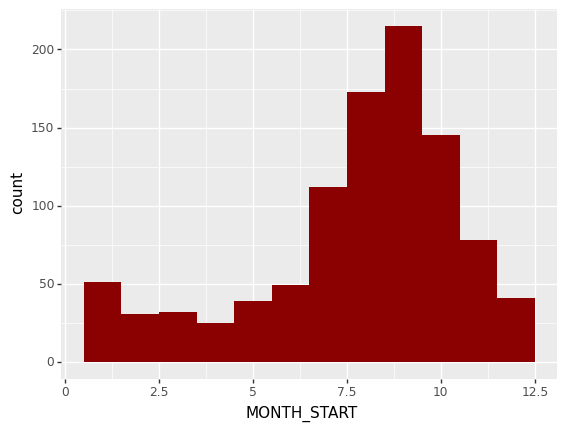

<ggplot: (-9223363251243162396)>


In [0]:
### MONTH_START
print(ggplot(df, aes(x='MONTH_START'))
 + geom_histogram(fill='darkred', binwidth=1))

Correlation -  0.07141773058747813


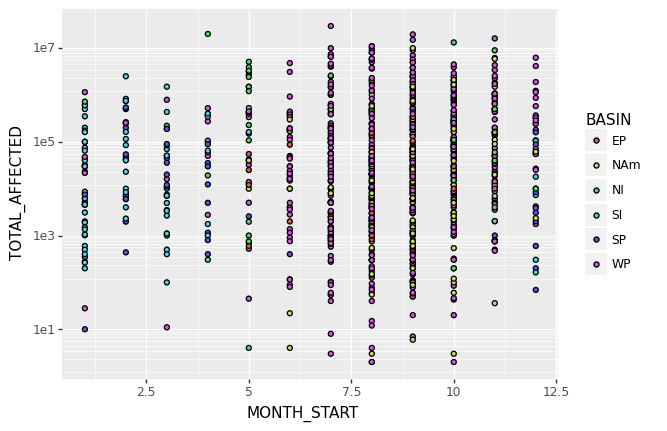

<ggplot: (8785612539961)>


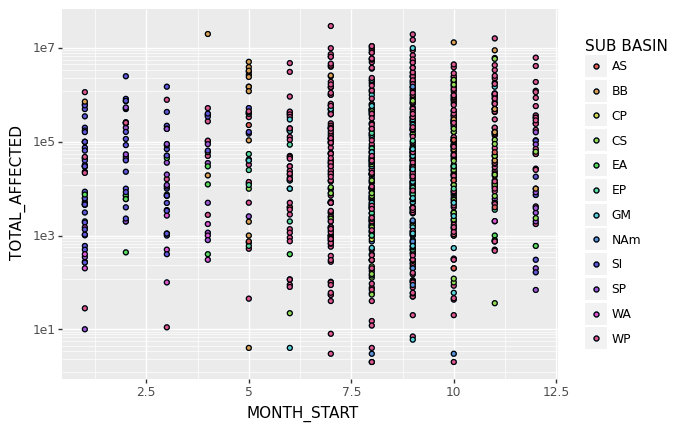

<ggplot: (-9223363251242235858)>


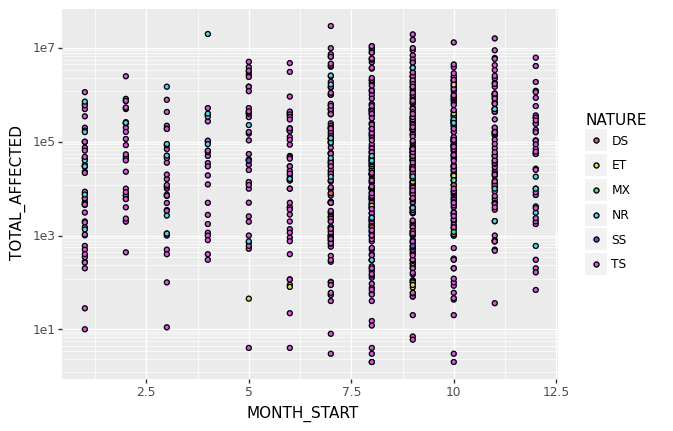

<ggplot: (8785612539961)>


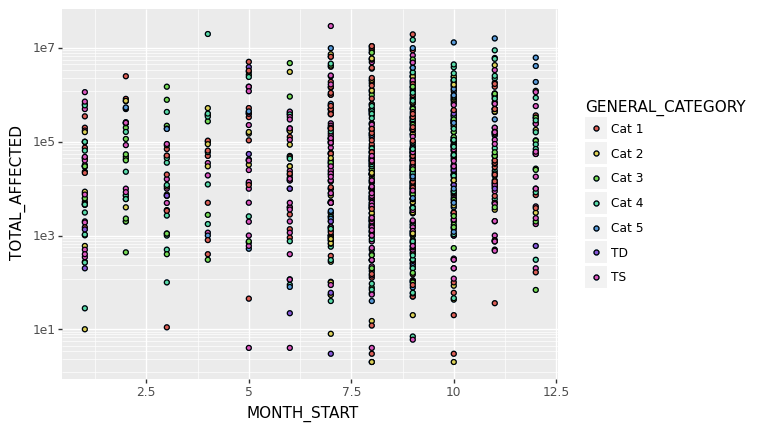

<ggplot: (-9223363251242649400)>


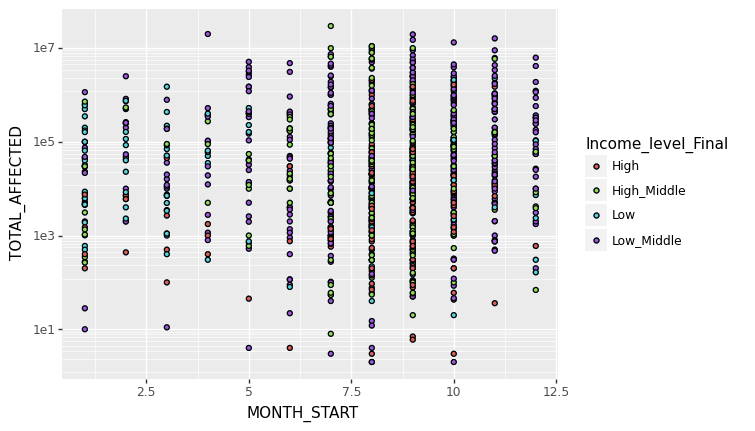

<ggplot: (8785611854796)>
{'lower': array([ 38,  41,  44,  52,  53,  61,  73,  74,  75,  84, 103, 119, 120,
       140, 141, 150, 151, 152, 153, 160, 161, 172, 186, 196, 197, 198,
       209, 210, 237, 252, 286, 309, 326, 327, 343, 377, 388, 389, 390,
       442, 443, 444, 461, 462, 463, 465, 487, 488, 528, 563, 564, 593,
       626, 627, 628, 674, 719, 720, 721, 748, 749, 750, 751, 752, 783,
       784, 785, 786, 818, 819, 820, 847, 848, 849, 850, 851, 879, 914,
       951, 952, 953, 985]), 'upper': array([], dtype=int64), 'q_both': [2.5, 14.5], 'min-max': [1, 12]}


In [0]:
plotBiMulti('MONTH_START', 
            scale_x=0, scale_y=1)
print(outlier_check(df['MONTH_START']))

## MONTH_END

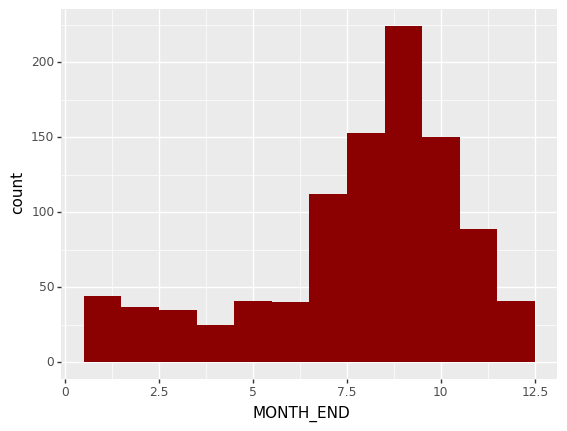

<ggplot: (-9223363251242268472)>


In [0]:
### MONTH_END
print(ggplot(df, aes(x='MONTH_END'))
 + geom_histogram(fill='darkred', binwidth=1))

Correlation -  0.06583017179426534


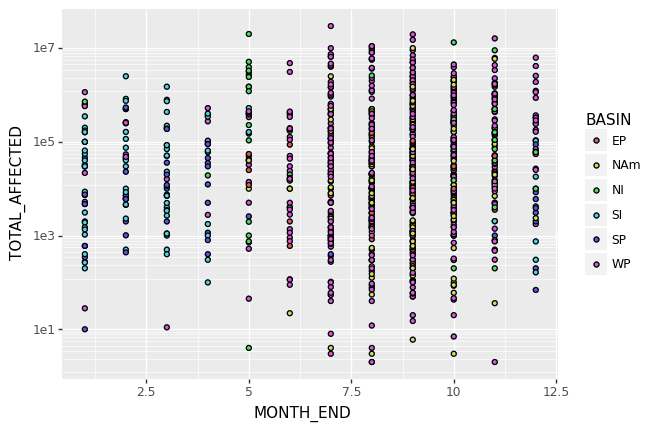

<ggplot: (-9223363251243390250)>


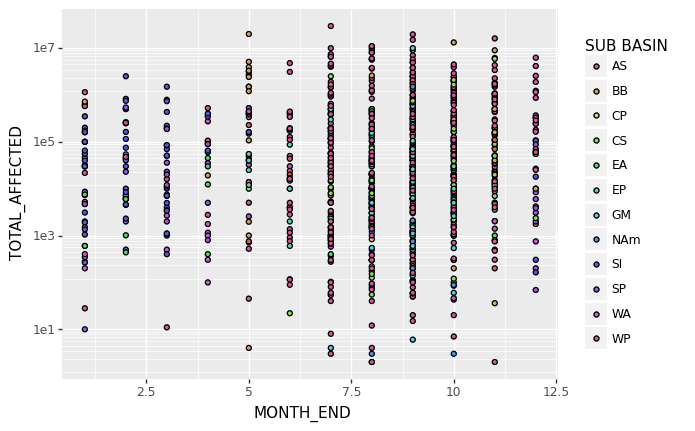

<ggplot: (8785614416504)>


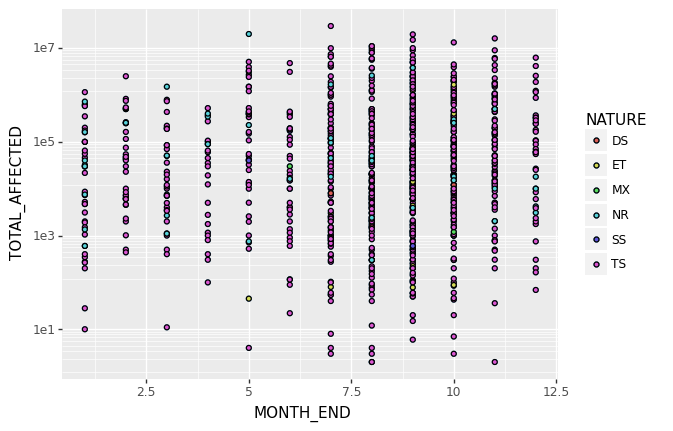

<ggplot: (8785611625876)>


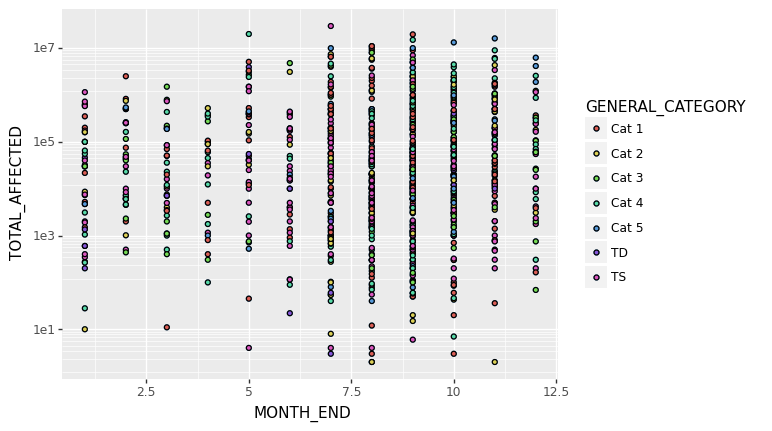

<ggplot: (-9223363251242097755)>


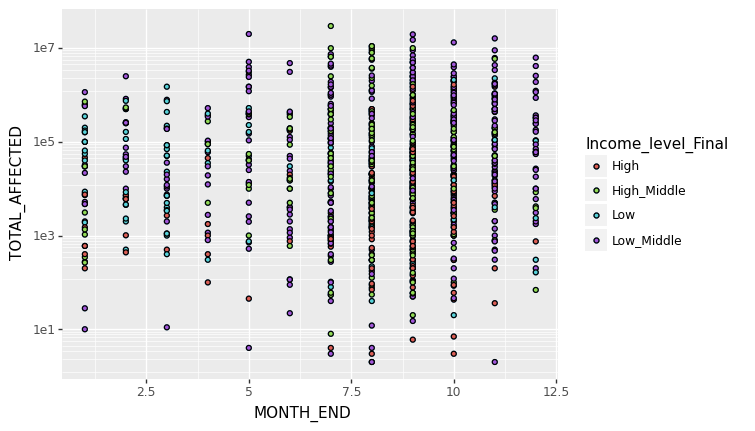

<ggplot: (8785618443710)>
{'lower': array([ 38,  41,  44,  52,  53,  61,  73,  74,  75,  84, 103, 119, 120,
       140, 150, 151, 152, 153, 160, 161, 172, 186, 196, 209, 210, 228,
       237, 252, 266, 286, 309, 326, 327, 343, 377, 388, 389, 442, 443,
       444, 461, 462, 463, 487, 488, 528, 563, 564, 592, 593, 626, 627,
       628, 674, 719, 720, 721, 748, 749, 750, 751, 783, 784, 785, 786,
       818, 819, 820, 846, 847, 848, 849, 850, 851, 878, 879, 914, 951,
       952, 953, 985]), 'upper': array([], dtype=int64), 'q_both': [2.5, 14.5], 'min-max': [1, 12]}


In [0]:
plotBiMulti('MONTH_END', 
            scale_x=0, scale_y=1)
print(outlier_check(df['MONTH_END']))

## MAX_WIND

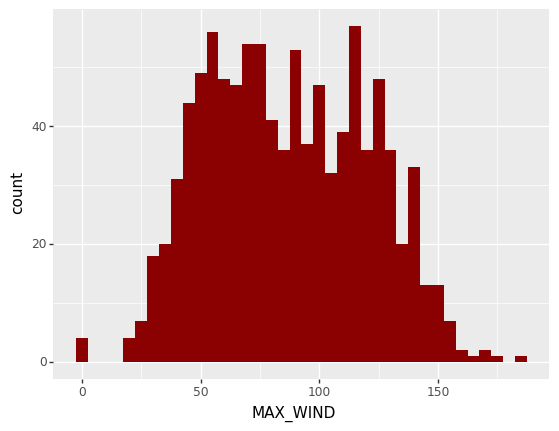

<ggplot: (-9223363251243236292)>


"\n\ndf['PRES_CALC_MEAN'] = SimpleImputer(missing_values=0.0, \n                                            strategy='median').fit_transform(\n    np.array(df['PRES_CALC_MEAN']).reshape(-1, 1))\n          "

In [0]:
### MAX_WIND

print(ggplot(df, aes(x='MAX_WIND'))
 + geom_histogram(fill='darkred', binwidth=5))

'''

df['PRES_CALC_MEAN'] = SimpleImputer(missing_values=0.0, 
                                            strategy='median').fit_transform(
    np.array(df['PRES_CALC_MEAN']).reshape(-1, 1))
          '''                                  

Correlation -  0.1283472518509806


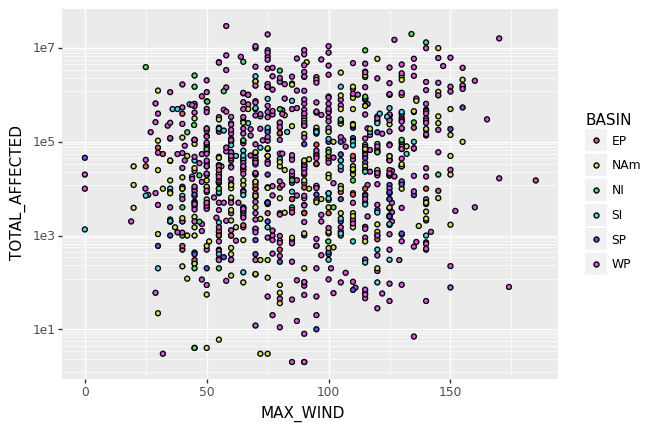

<ggplot: (-9223363251242823971)>


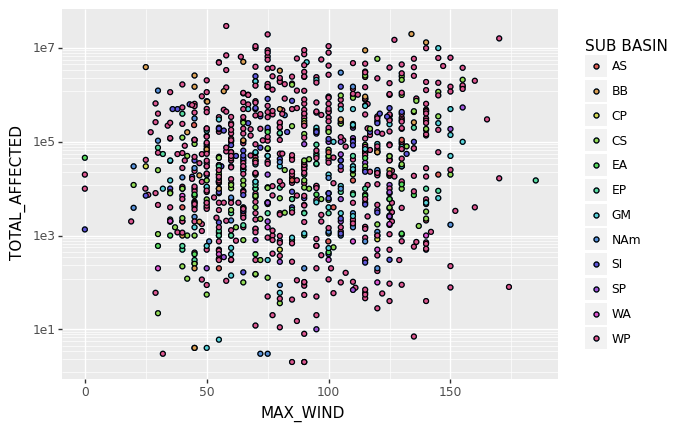

<ggplot: (8785611951848)>


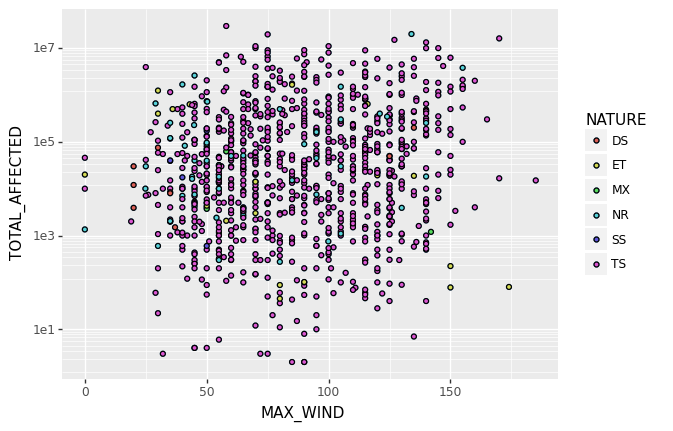

<ggplot: (8785611524058)>


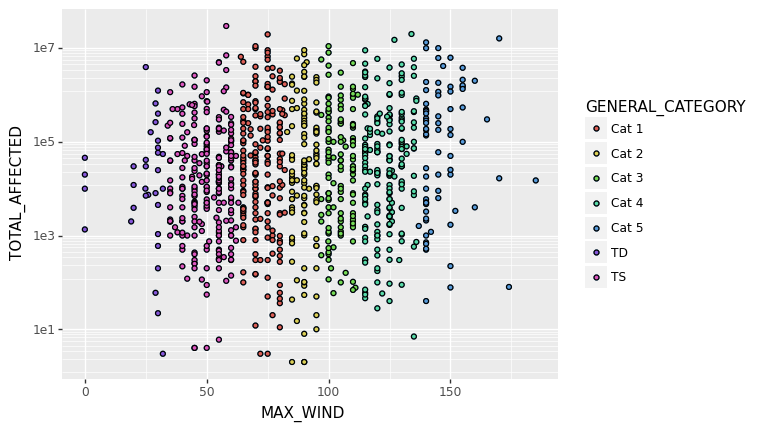

<ggplot: (8785612025117)>


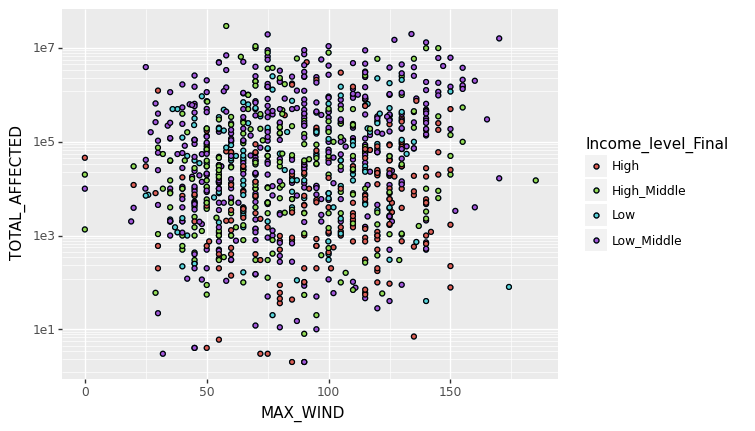

<ggplot: (-9223363251242679285)>
{'lower': array([], dtype=int64), 'upper': array([], dtype=int64), 'q_both': [-22.5, 197.5], 'min-max': [0.0, 185.0]}


In [0]:
plotBiMulti('MAX_WIND', 
            scale_x=0, scale_y=1)
print(outlier_check(df['MAX_WIND']))

## MIN_PRES

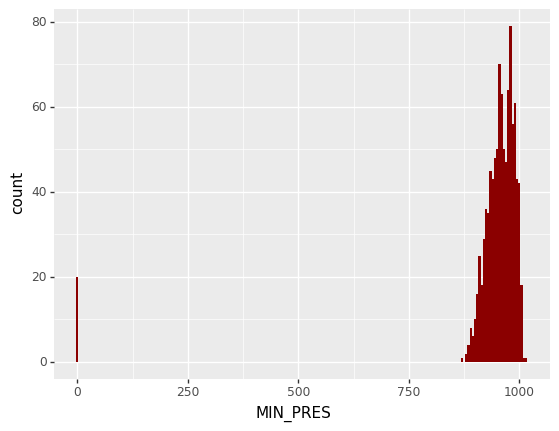

<ggplot: (8785611539576)>


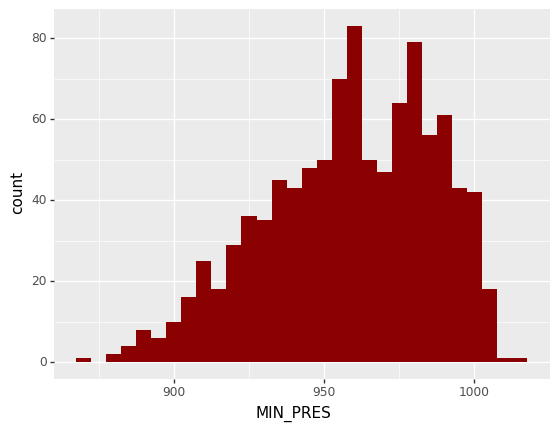

<ggplot: (-9223363251243236236)>


In [0]:
### MIN_PRES

print(ggplot(df, aes(x='MIN_PRES'))
 + geom_histogram(fill='darkred', binwidth=5))


df['MIN_PRES'] = SimpleImputer(missing_values=0, 
                                            strategy='median').fit_transform(
    np.array(df['MIN_PRES']).reshape(-1, 1))


print(ggplot(df, aes(x='MIN_PRES'))
 + geom_histogram(fill='darkred', binwidth=5))


Correlation -  -0.14186373284167333


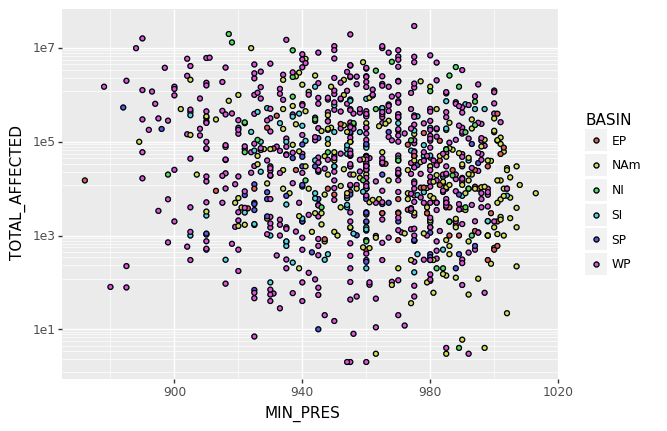

<ggplot: (-9223363251242273199)>


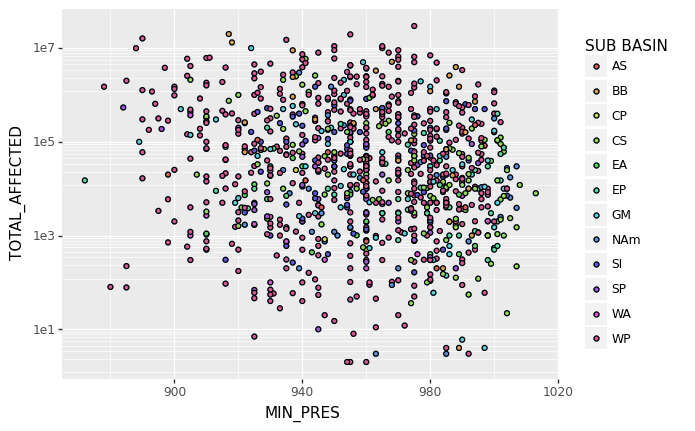

<ggplot: (8785611401420)>


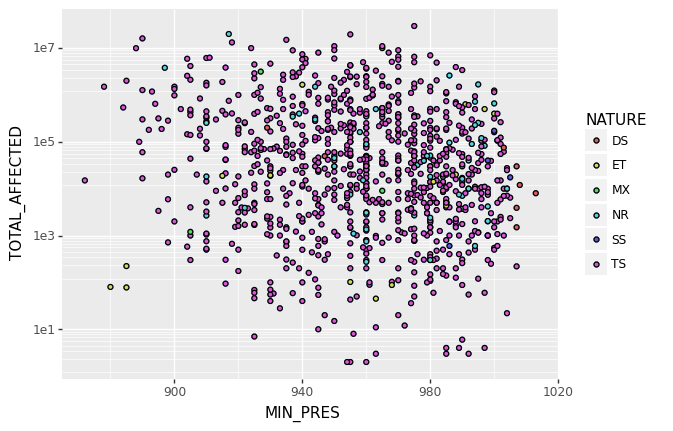

<ggplot: (8785611205391)>


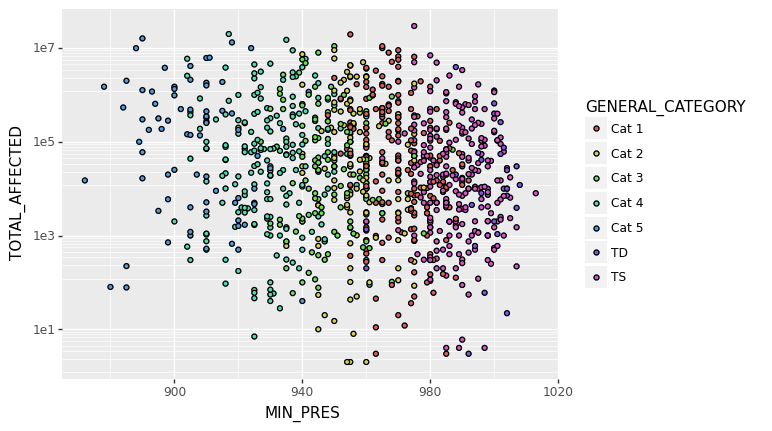

<ggplot: (-9223363251242224089)>


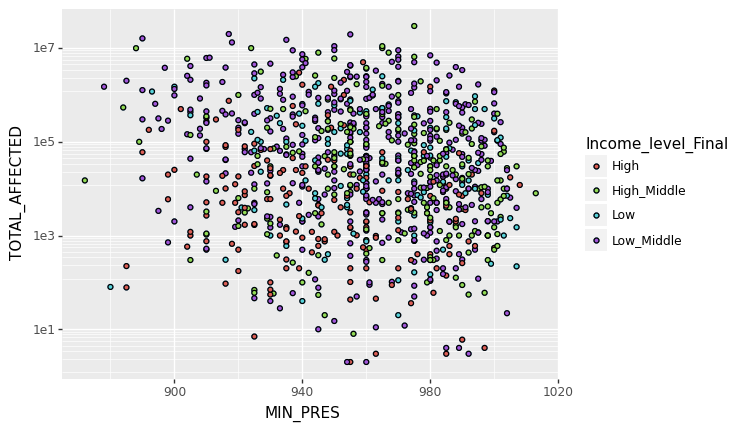

<ggplot: (-9223363251242102987)>
{'lower': array([100, 873]), 'upper': array([], dtype=int64), 'q_both': [880.0, 1040.0], 'min-max': [872.0, 1013.0]}


In [0]:
plotBiMulti('MIN_PRES', 
            scale_x=0, scale_y=1)
print(outlier_check(df['MIN_PRES']))

## MIN_DIST2LAND

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 32'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


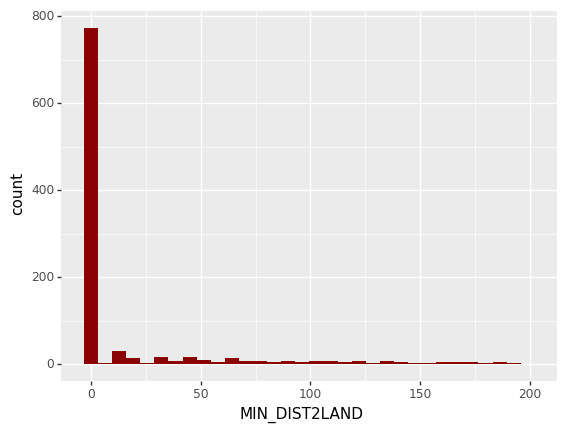

<ggplot: (-9223363251243123687)>


In [0]:
### MIN_DIST2LAND

df['dis2land_bin'] = np.where(df['MIN_DIST2LAND'] == 0, 1, 0)

print(ggplot(df, aes(x='MIN_DIST2LAND'))
 + geom_histogram(fill='darkred'))

Correlation -  -0.13844603238000125


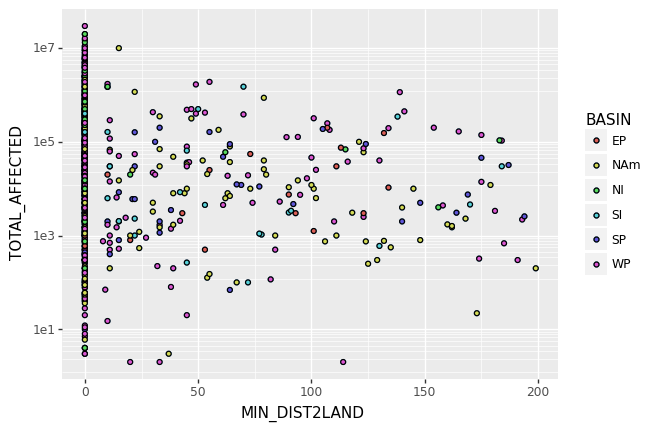

<ggplot: (-9223363251243415443)>


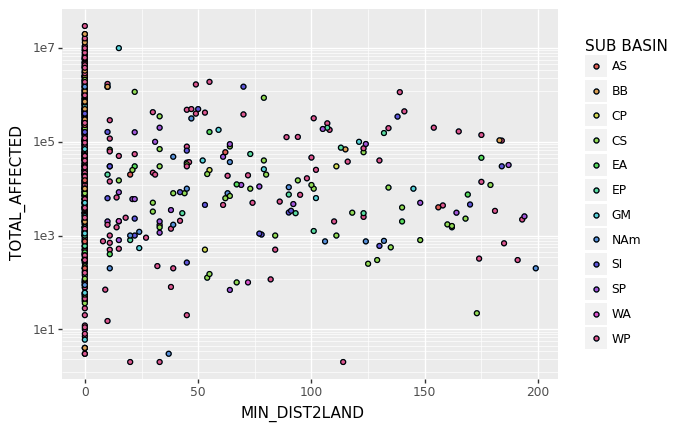

<ggplot: (-9223363251243050734)>


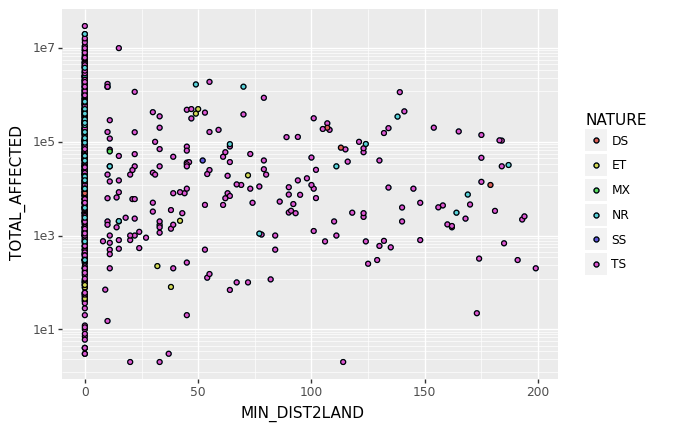

<ggplot: (-9223363251242946293)>


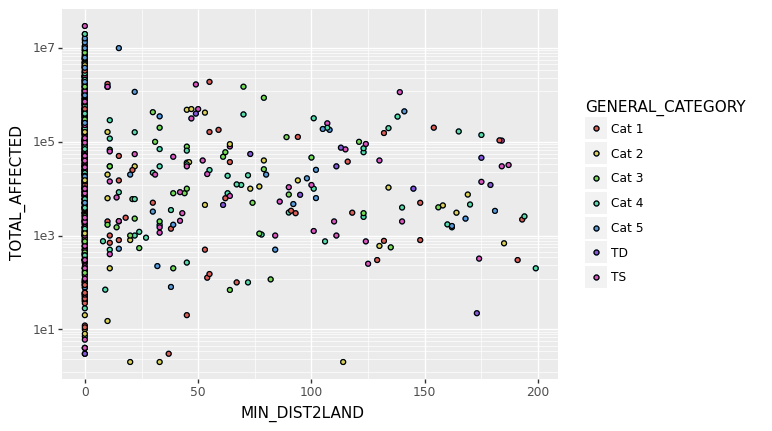

<ggplot: (-9223363251243050734)>


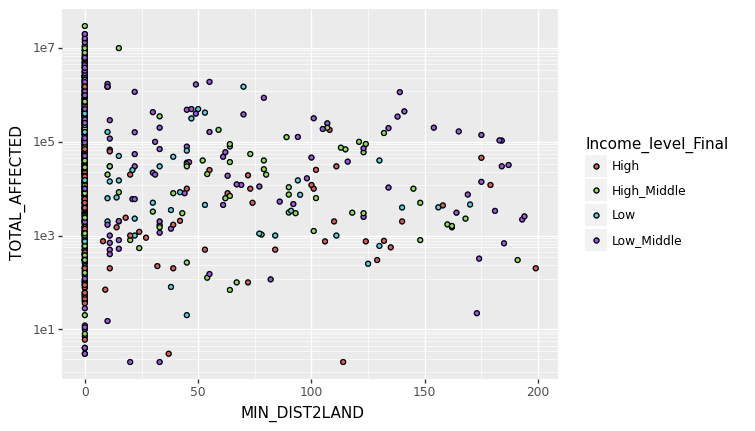

<ggplot: (-9223363251242183834)>
{'lower': array([], dtype=int64), 'upper': array([ 24,  27,  29,  31,  35,  42,  48,  57,  61,  65,  68,  70,  86,
        92, 103, 104, 114, 115, 120, 121, 123, 124, 130, 131, 139, 140,
       141, 142, 144, 149, 153, 161, 162, 167, 170, 177, 179, 180, 186,
       192, 193, 196, 198, 199, 202, 209, 210, 218, 219, 222, 223, 230,
       231, 236, 241, 256, 260, 263, 265, 266, 267, 271, 276, 286, 291,
       294, 298, 299, 302, 310, 314, 316, 317, 318, 329, 335, 338, 341,
       344, 345, 369, 371, 372, 376, 377, 378, 389, 394, 395, 401, 402,
       404, 414, 418, 420, 423, 443, 444, 448, 454, 455, 456, 461, 467,
       469, 478, 483, 484, 492, 493, 498, 500, 502, 503, 505, 506, 509,
       510, 511, 512, 513, 517, 518, 523, 524, 531, 532, 534, 546, 552,
       554, 556, 560, 572, 578, 585, 594, 599, 600, 601, 602, 617, 620,
       623, 635, 644, 646, 650, 655, 656, 657, 661, 664, 676, 684, 688,
       699, 708, 710, 718, 719, 723, 727, 730, 731, 735, 736

In [0]:
plotBiMulti('MIN_DIST2LAND', 
            scale_x=0, scale_y=1)
print(outlier_check(df['MIN_DIST2LAND']))

## MAX_STORMSPEED

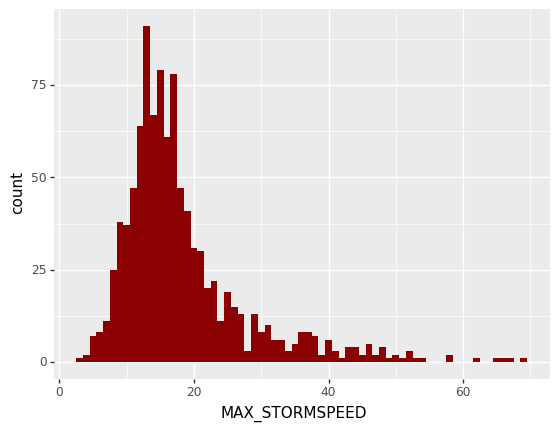

<ggplot: (8785612251645)>


In [0]:
### MAX_STORMSPEED
print(ggplot(df, aes(x='MAX_STORMSPEED'))
 + geom_histogram(fill='darkred', binwidth=1))

Correlation -  -0.10927855101047225


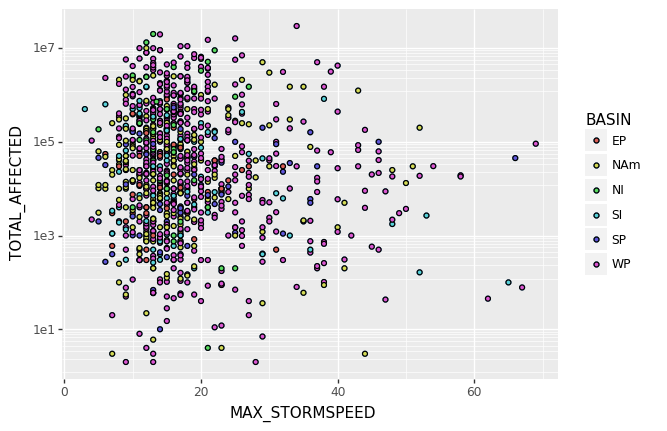

<ggplot: (8785611232169)>


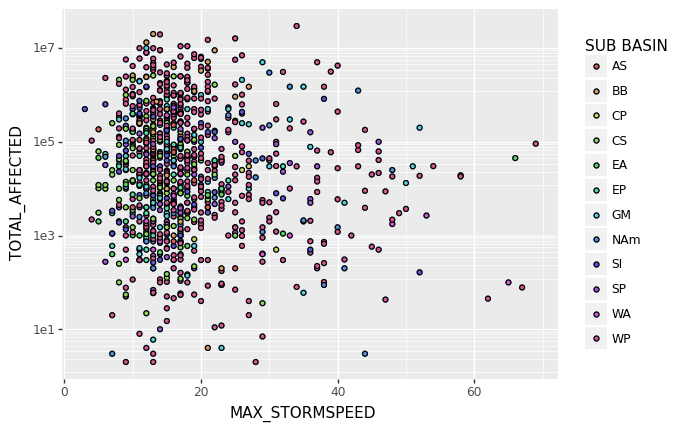

<ggplot: (-9223363251242584597)>


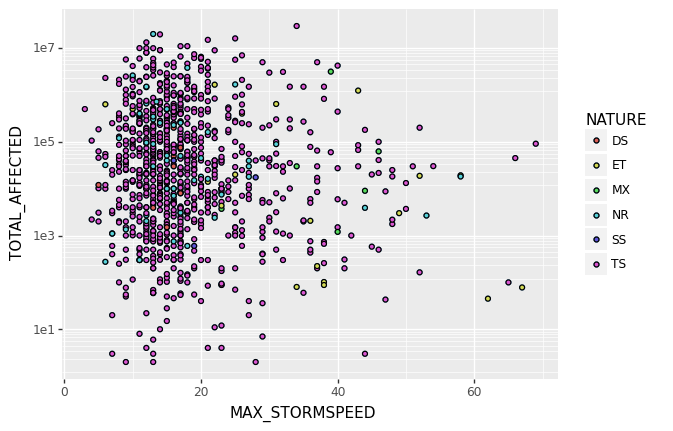

<ggplot: (-9223363251242858559)>


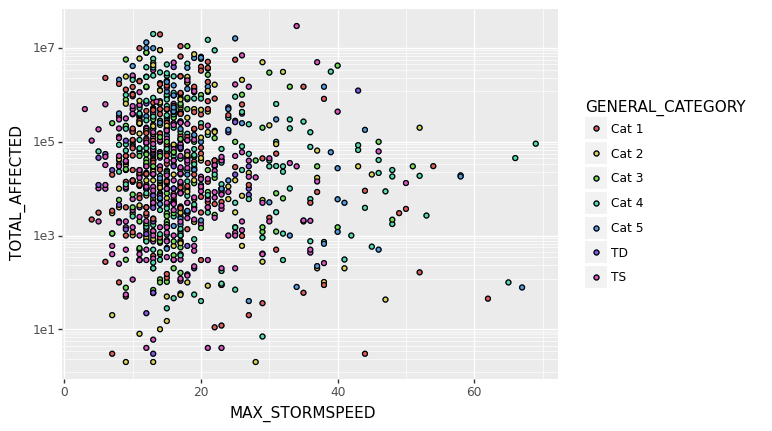

<ggplot: (8785611925291)>


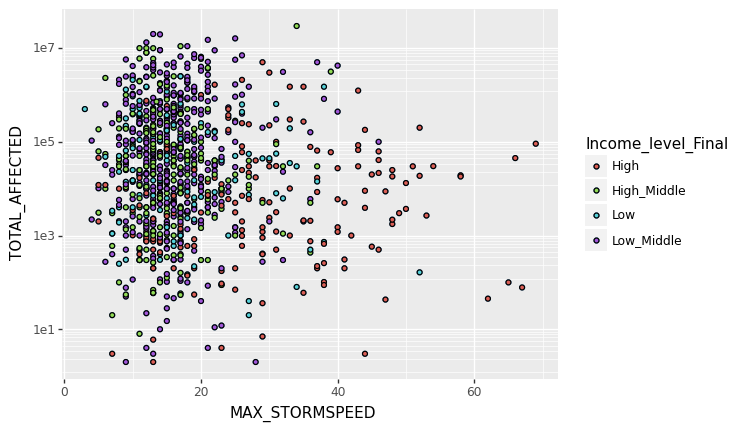

<ggplot: (8785612589537)>
{'lower': array([], dtype=int64), 'upper': array([  8,  21,  25,  27,  34,  75,  92, 116, 121, 122, 123, 135, 146,
       160, 163, 164, 177, 191, 220, 233, 236, 248, 259, 261, 265, 266,
       288, 293, 307, 317, 321, 328, 349, 361, 366, 368, 379, 384, 447,
       453, 461, 463, 475, 478, 480, 483, 485, 492, 499, 501, 508, 521,
       522, 542, 555, 556, 569, 570, 658, 660, 689, 740, 770, 802, 812,
       824, 839, 840, 855, 880, 892, 893, 916, 935, 941, 945, 971, 974,
       975, 977]), 'q_both': [1.0, 33.0], 'min-max': [3.0, 69.0]}


In [0]:
plotBiMulti('MAX_STORMSPEED', 
            scale_x=0, scale_y=1)
print(outlier_check(df['MAX_STORMSPEED']))

## V_LAND_KN

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 68'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


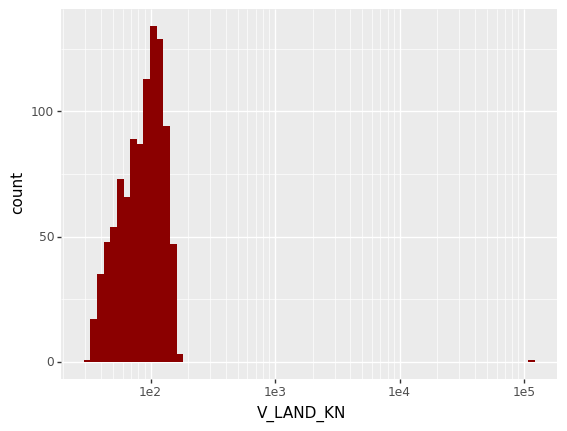

<ggplot: (8785611447388)>


/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 15'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


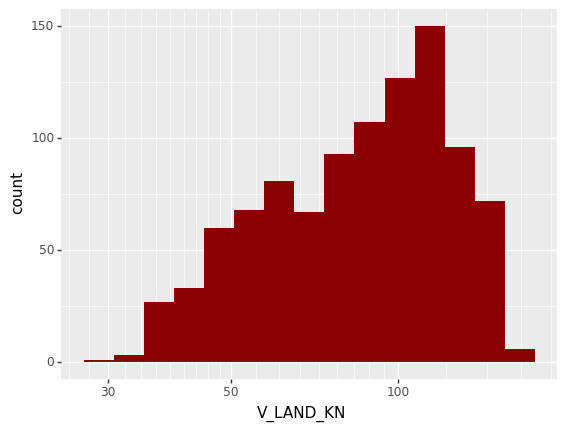

<ggplot: (-9223363251243152766)>


In [0]:
### V_LAND_KN
print(ggplot(df, aes(x='V_LAND_KN'))
 + geom_histogram(fill='darkred')
 + scale_x_log10())

df['V_LAND_KN'] = SimpleImputer(missing_values=110691.0, 
                                                        strategy='median').fit_transform(np.array(
    df['V_LAND_KN']).reshape(-1, 1))                   

print(ggplot(df, aes(x='V_LAND_KN'))
 + geom_histogram(fill='darkred')
 + scale_x_log10())           

Correlation -  0.13688711637734716


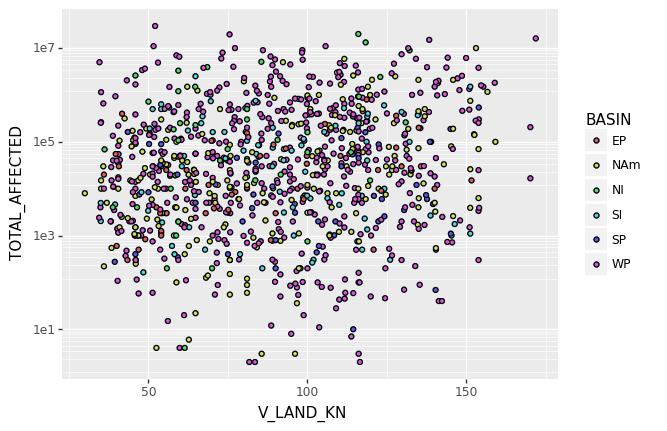

<ggplot: (8785611226965)>


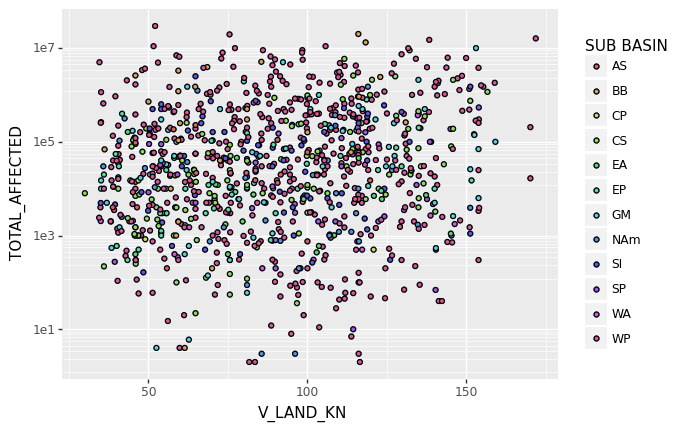

<ggplot: (-9223363251243267510)>


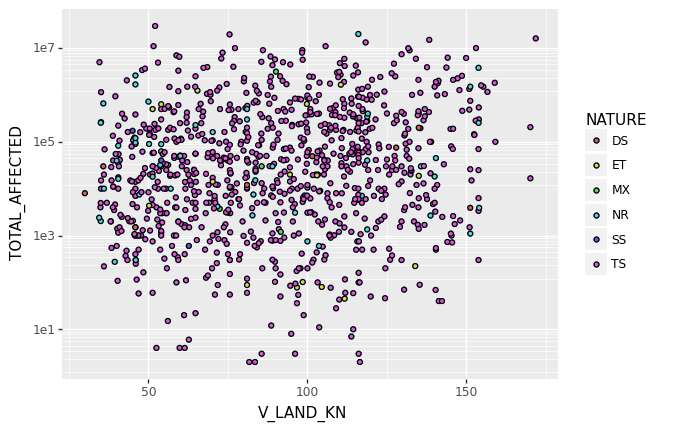

<ggplot: (-9223363251242702669)>


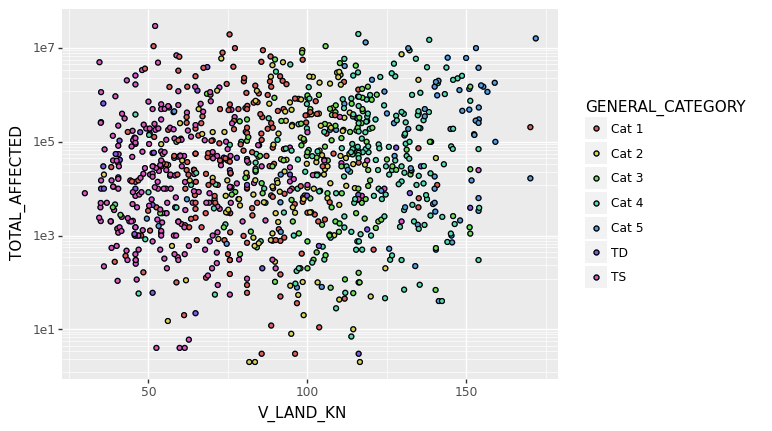

<ggplot: (-9223363251242239316)>


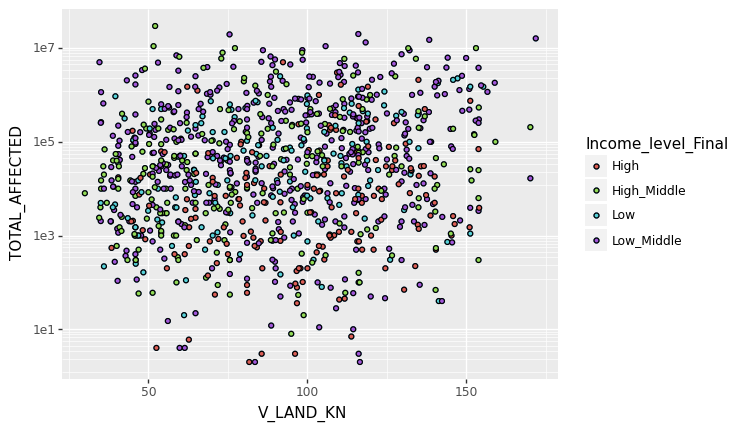

<ggplot: (8785611652279)>
{'lower': array([], dtype=int64), 'upper': array([], dtype=int64), 'q_both': [-16.124999999999986, 194.075], 'min-max': [30.0, 171.8]}


In [0]:
plotBiMulti('V_LAND_KN', 
            scale_x=0, scale_y=1)
print(outlier_check(df['V_LAND_KN']))

## MAX_USA_SSHS

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 14'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


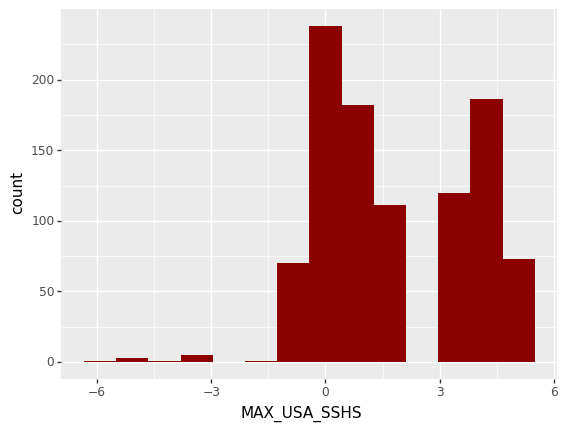

<ggplot: (-9223363251243121692)>


In [0]:
### MAX_USA_SSHS
print(ggplot(df, aes(x='MAX_USA_SSHS'))
 + geom_histogram(fill='darkred'))

Correlation -  0.09772227713783314


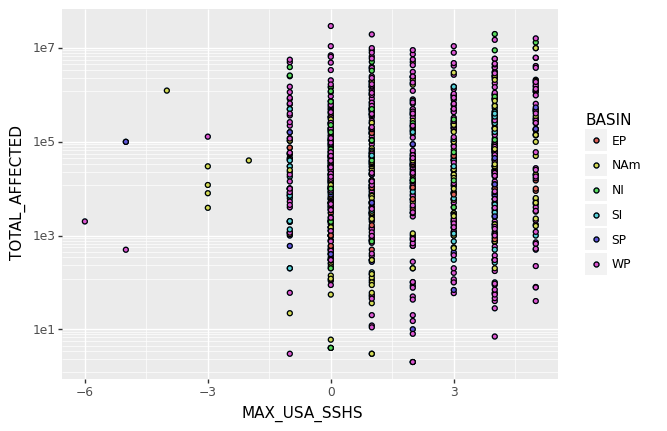

<ggplot: (8785612126377)>


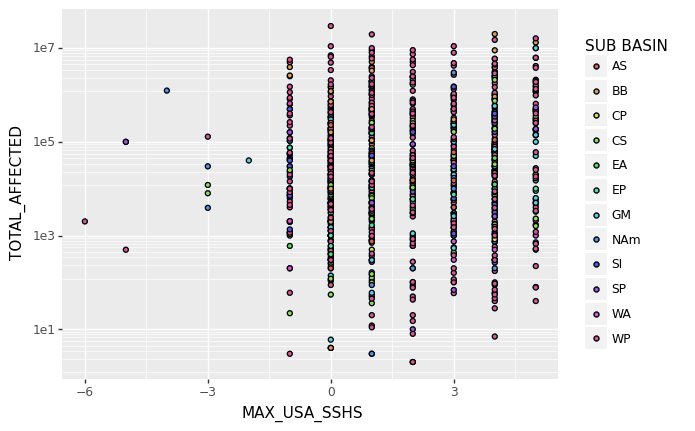

<ggplot: (-9223363251240457212)>


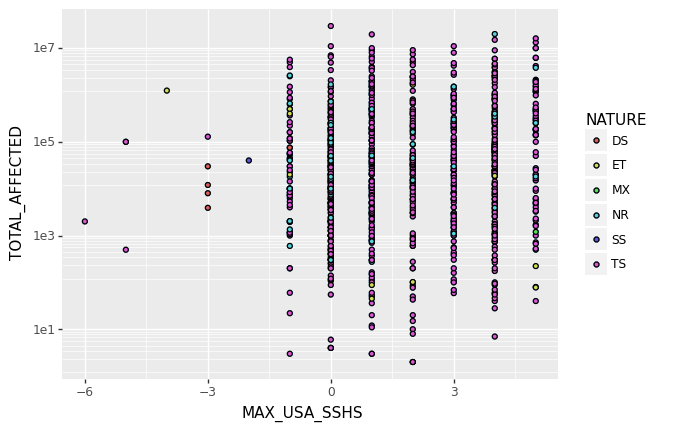

<ggplot: (-9223363251243360757)>


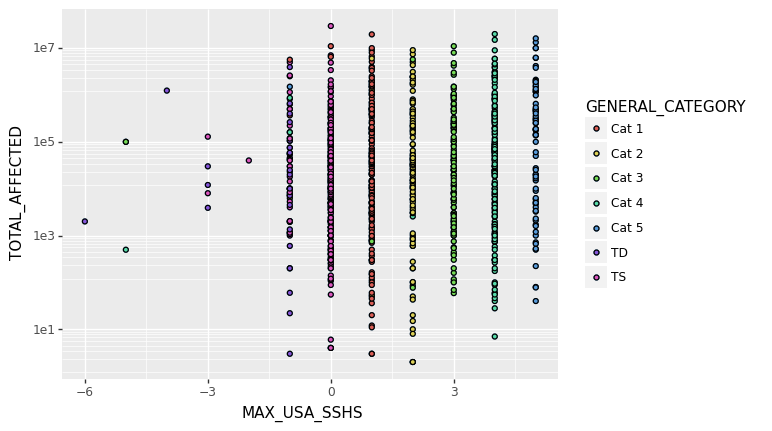

<ggplot: (-9223363251243490567)>


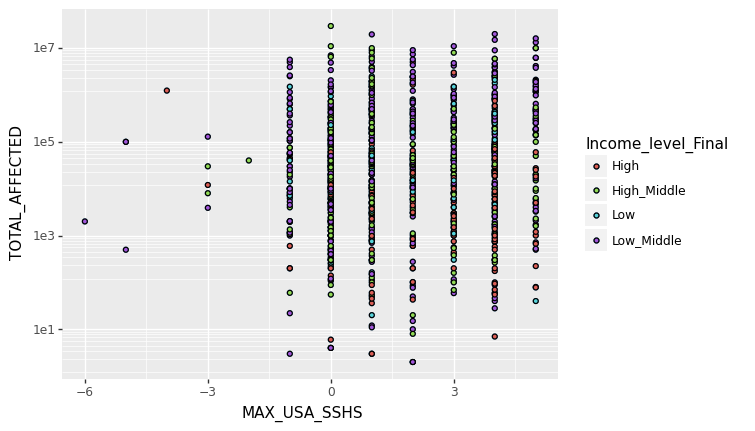

<ggplot: (-9223363251243553967)>
{'lower': array([], dtype=int64), 'upper': array([], dtype=int64), 'q_both': [-6.0, 10.0], 'min-max': [-6, 5]}


In [0]:
plotBiMulti('MAX_USA_SSHS', 
            scale_x=0, scale_y=1)
print(outlier_check(df['MAX_USA_SSHS']))

## POP_DEN_SQ_KM

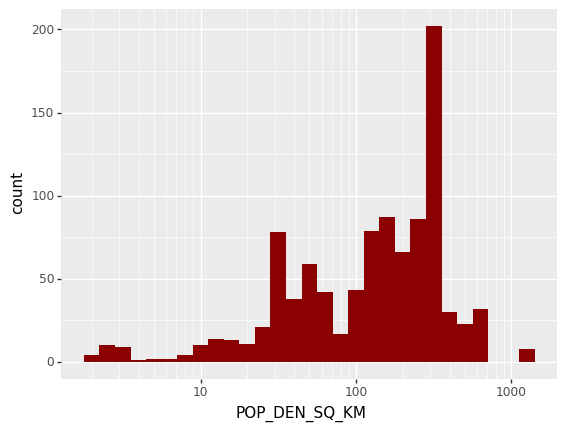

<ggplot: (8785611357935)>


In [0]:
### POP_DEN_SQ_KM


print(ggplot(df, aes(x='POP_DEN_SQ_KM'))
 + geom_histogram(fill='darkred', binwidth=0.1)
 + scale_x_log10())

df['POP_DEN_SQ_KM'] = np.log10(df['POP_DEN_SQ_KM'] + 1)

df["pop_break"] = np.where(df['POP_DEN_SQ_KM'].between(1, 2), 1, 0)
df["pop_break_two"] = np.where(df['POP_DEN_SQ_KM'].between(2, 3), 1, 0)

Correlation -  0.08012979097171073


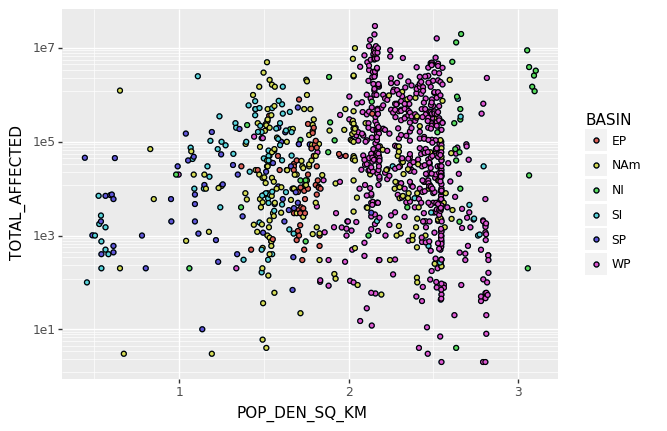

<ggplot: (-9223363251243547802)>


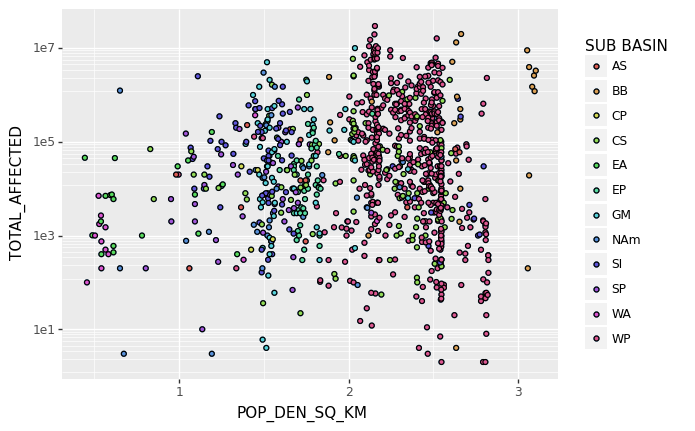

<ggplot: (-9223363251243121692)>


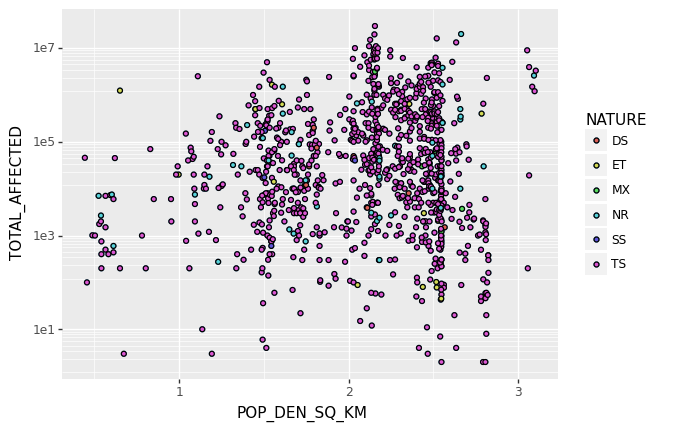

<ggplot: (8785612165552)>


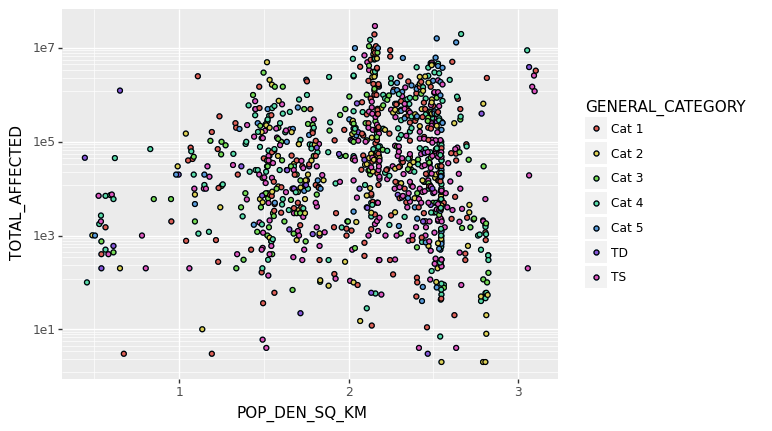

<ggplot: (8785612548111)>


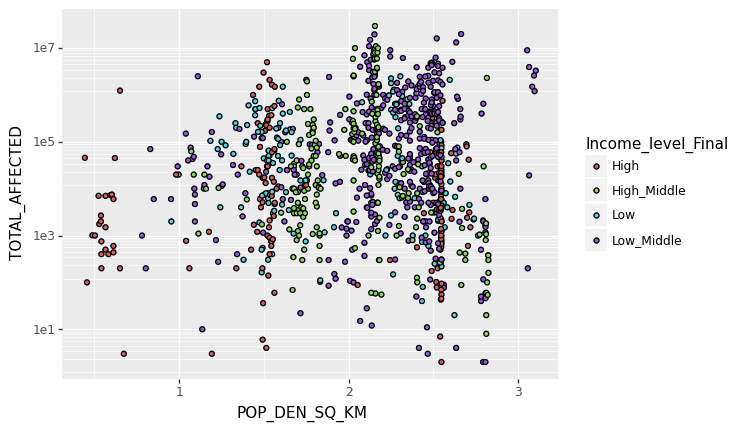

<ggplot: (-9223363251240356727)>
{'lower': array([ 61,  92, 172, 211, 309, 328, 377, 379, 388, 393, 417]), 'upper': array([], dtype=int64), 'q_both': [0.548792780081591, 3.6478786143215736], 'min-max': [0.44404479591807633, 3.104145550554008]}


In [0]:
plotBiMulti('POP_DEN_SQ_KM', 
            scale_x=0, scale_y=1)
print(outlier_check(df['POP_DEN_SQ_KM']))

## RURAL_POP(%)

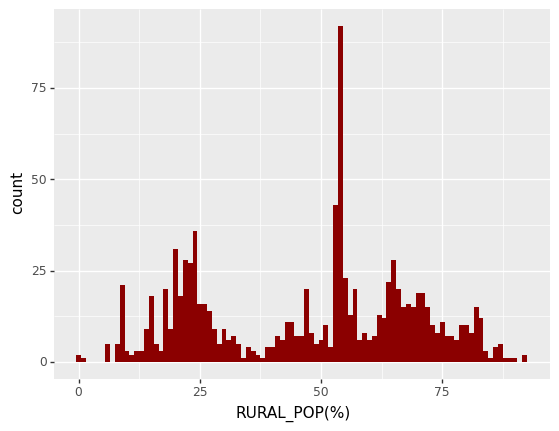

<ggplot: (8785612559259)>


In [0]:
### RURAL_POP(%)

print(ggplot(df, aes(x='RURAL_POP(%)'))
 + geom_histogram(fill='darkred', binwidth=1))


df['RURAL_POP(%)'] = SimpleImputer(missing_values=0.0, 
                                                        strategy='median').fit_transform(np.array(
    df['RURAL_POP(%)']).reshape(-1, 1)) 
                                                      
df['RURAL_POP(%)'] = SimpleImputer(missing_values=0.8, 
                                                        strategy='median').fit_transform(np.array(
    df['RURAL_POP(%)']).reshape(-1, 1))   


df["rural_break"] = np.where(df['RURAL_POP(%)'] < 37.5, 1, 0)
df["rural_break_two"] = np.where(df['RURAL_POP(%)'].between(37.5, 62.5), 1, 0)
df["rural_break_three"] = np.where(df['RURAL_POP(%)'] > 62.5, 1, 0)


df["rural_break_four"] = np.where(df['RURAL_POP(%)'] > 37.5, 1, 0)

Correlation -  0.2724971615765821


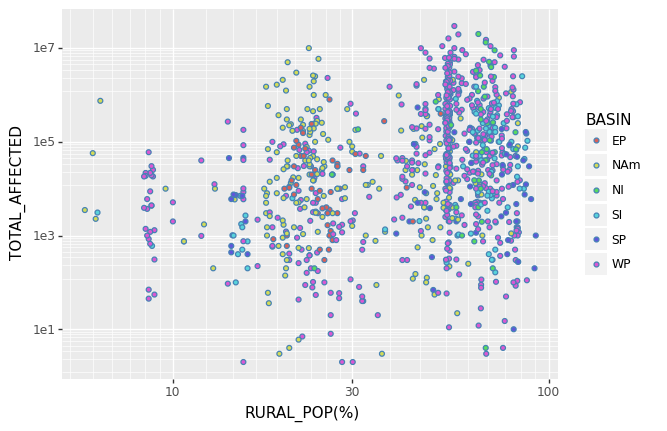

<ggplot: (-9223363251243455765)>


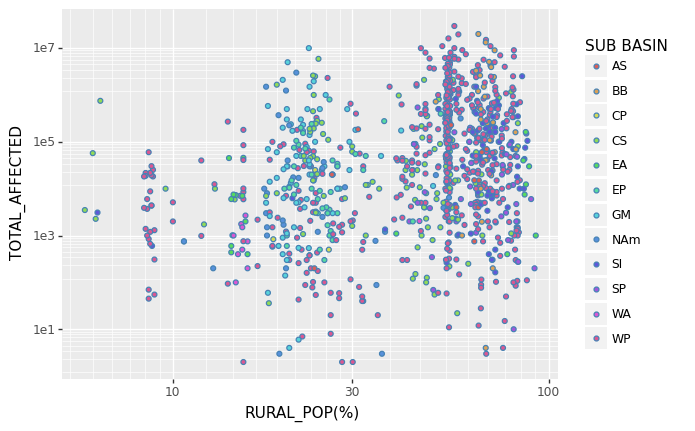

<ggplot: (-9223363251243577207)>


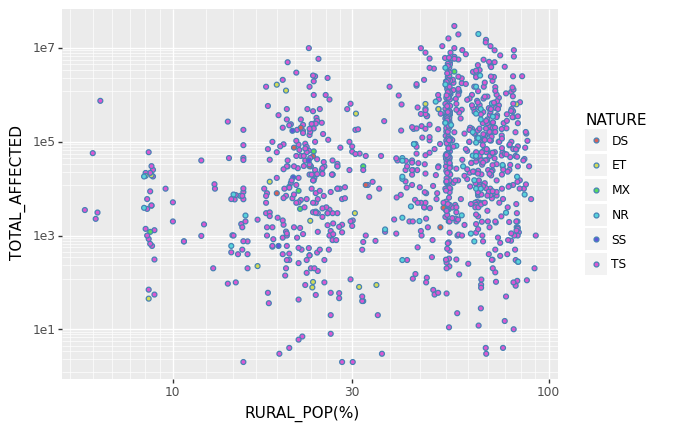

<ggplot: (-9223363251242958490)>


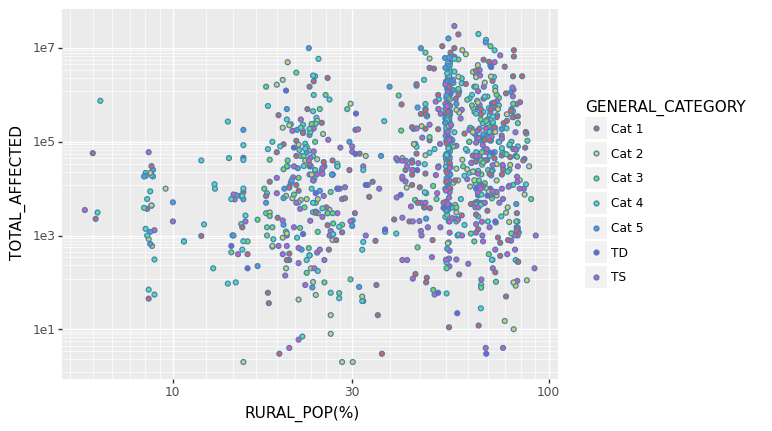

<ggplot: (-9223363251243017626)>


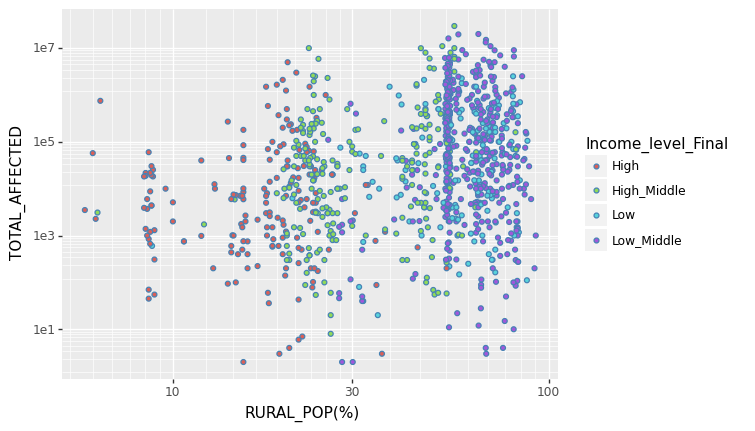

<ggplot: (8785612672783)>
{'lower': array([], dtype=int64), 'upper': array([], dtype=int64), 'q_both': [-36.300000000000004, 126.10000000000001], 'min-max': [5.83, 92.4]}


In [0]:
plotBiMulti('RURAL_POP(%)', 
            scale_x=1, scale_y=1)
print(outlier_check(df['RURAL_POP(%)']))

## DISTANCE_TRACK

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 5 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


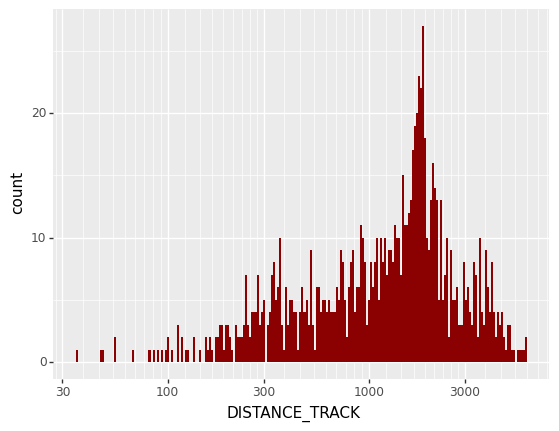

<ggplot: (8785612627569)>


In [0]:
### DISTANCE_TRACK
print(ggplot(df, aes(x='DISTANCE_TRACK'))
 + geom_histogram(fill='darkred', binwidth=0.01)
 + scale_x_log10())


df['DISTANCE_TRACK'] = np.log10(df['DISTANCE_TRACK'] + 1)

Correlation -  0.0671143093559796


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


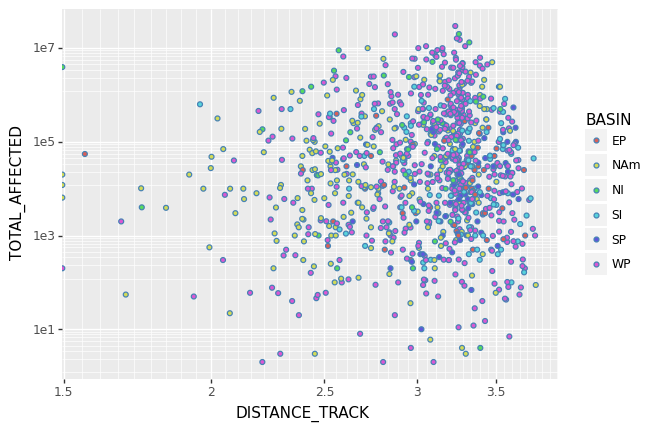

<ggplot: (8785611164669)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


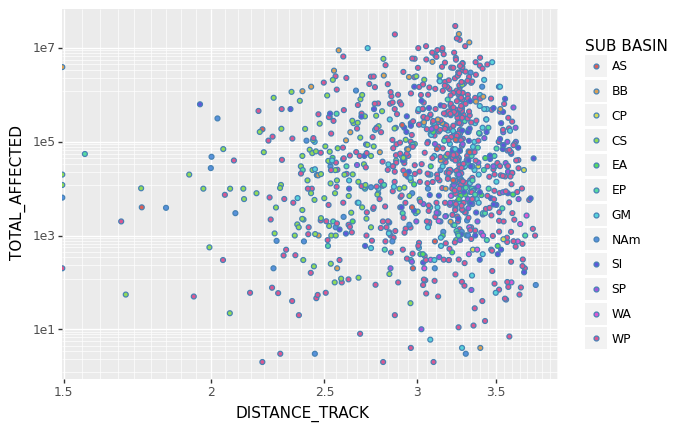

<ggplot: (8785611543069)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


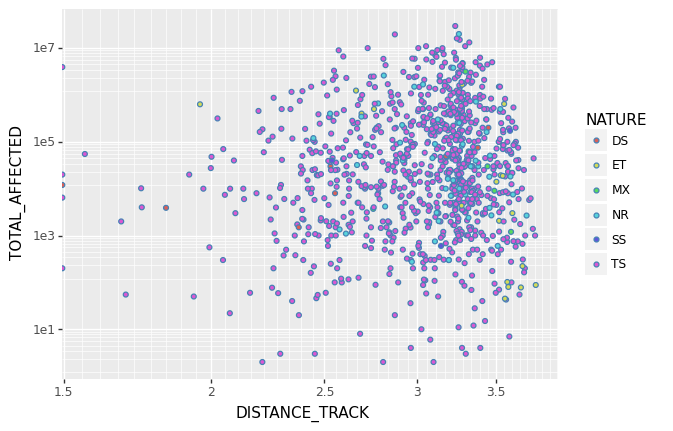

<ggplot: (8785611762906)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


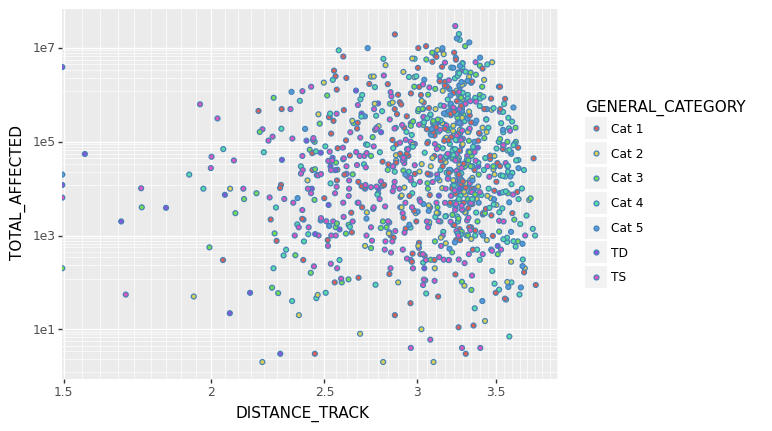

<ggplot: (-9223363251242858068)>


/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


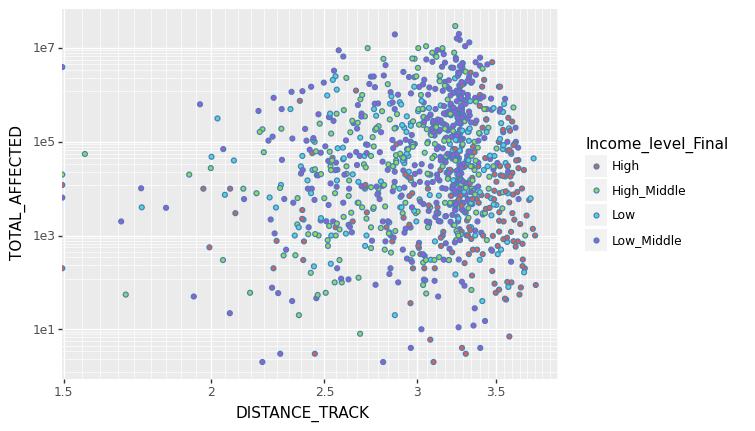

<ggplot: (8785611917800)>
{'lower': array([ 43, 151, 219, 301, 432, 433, 434, 512, 571, 602, 605, 635, 657,
       682, 875, 888, 928, 943]), 'upper': array([], dtype=int64), 'q_both': [2.020610501844029, 4.079412440450586], 'min-max': [0.0, 3.7835868138871787]}


In [0]:
plotBiMulti('DISTANCE_TRACK', 
            scale_x=1, scale_y=1)
print(outlier_check(df['DISTANCE_TRACK']))

## DISTANCE_TRACK_VINCENTY

/usr/local/lib/python3.6/dist-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.6/dist-packages/plotnine/layer.py:360: PlotnineWarning: stat_bin : Removed 5 rows containing non-finite values.
  data = self.stat.compute_layer(data, params, layout)


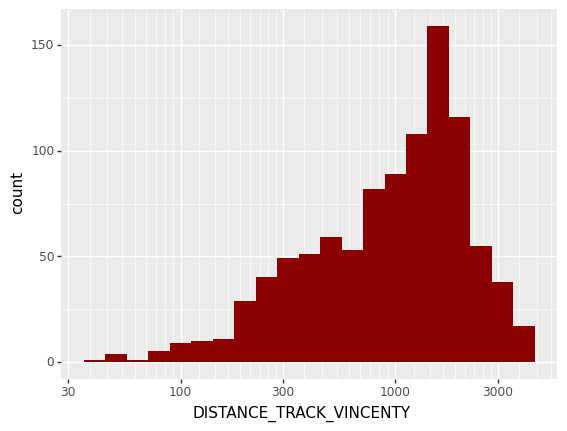

<ggplot: (8785611988544)>


In [0]:
## DISTANCE_TRACK_VINCENTY
print(ggplot(df, aes(x='DISTANCE_TRACK_VINCENTY'))
 + geom_histogram(fill='darkred', binwidth=0.1)
 + scale_x_log10())


df['DISTANCE_TRACK_VINCENTY'] = np.log(df['DISTANCE_TRACK_VINCENTY'] + 1)

Correlation -  0.09260694171404432


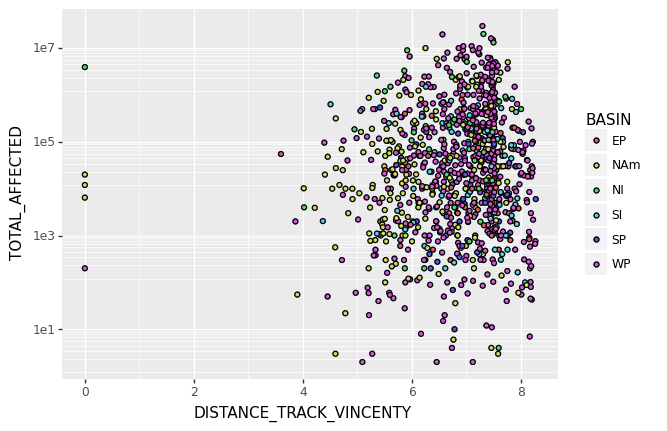

<ggplot: (-9223363251243571838)>


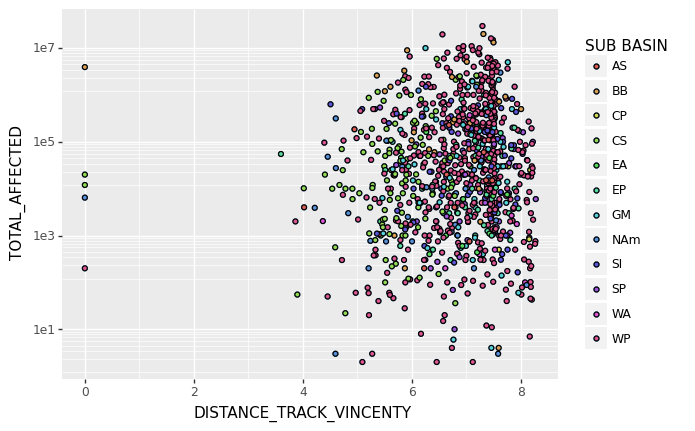

<ggplot: (-9223363251243516833)>


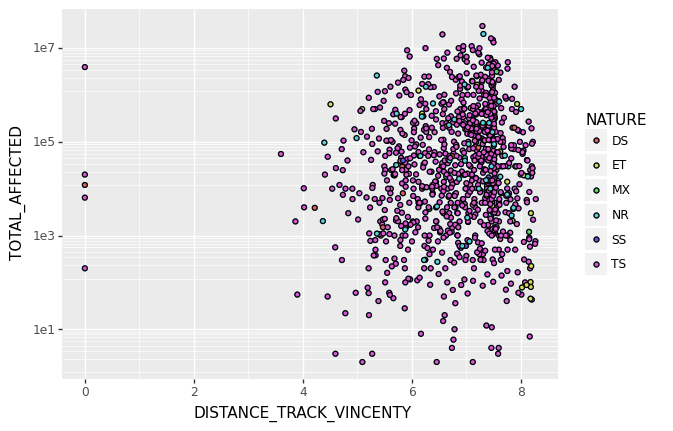

<ggplot: (8785611259014)>


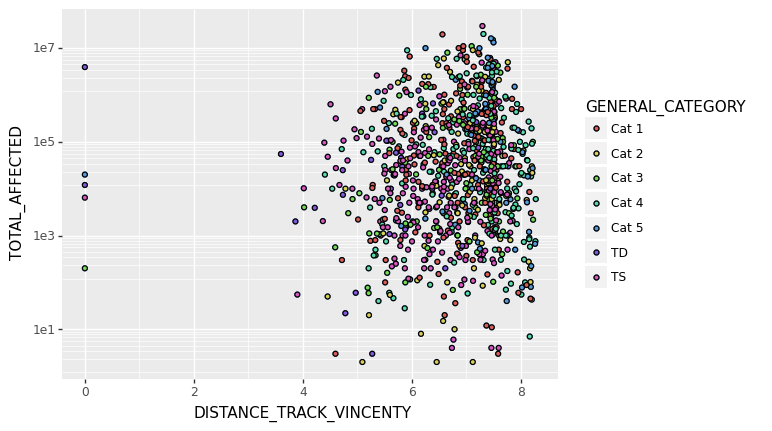

<ggplot: (-9223363251242531531)>


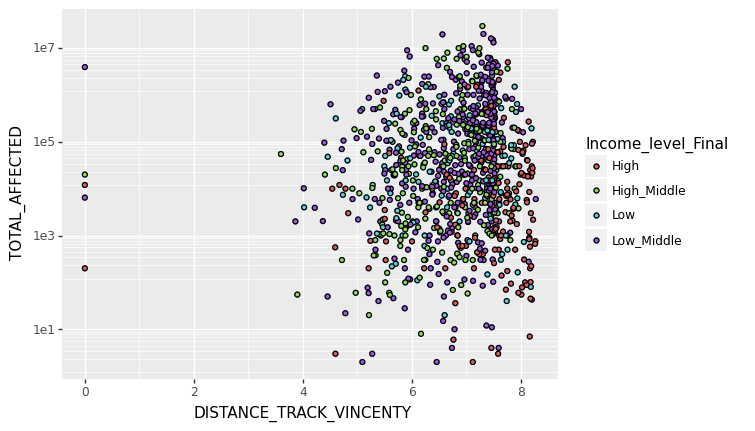

<ggplot: (-9223363251243250421)>
{'lower': array([ 43, 434, 571, 602, 605, 635, 682, 875, 888, 928, 943, 948, 964]), 'upper': array([], dtype=int64), 'q_both': [4.396206776000246, 9.31420765093058], 'min-max': [0.0, 8.275943081777358]}


In [0]:
plotBiMulti('DISTANCE_TRACK_VINCENTY', 
            scale_x=0, scale_y=1)
print(outlier_check(df['DISTANCE_TRACK_VINCENTY']))

## HDI

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 22'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


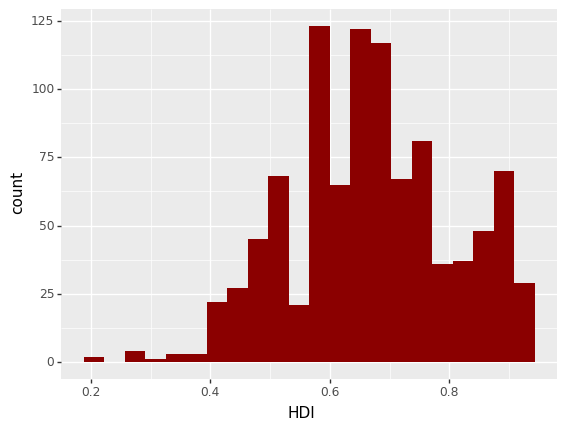

<ggplot: (-9223363251242645353)>


In [0]:
## HDI

print(ggplot(df, aes(x='HDI'))
 + geom_histogram(fill='darkred'))

Correlation -  -0.21972396139893738


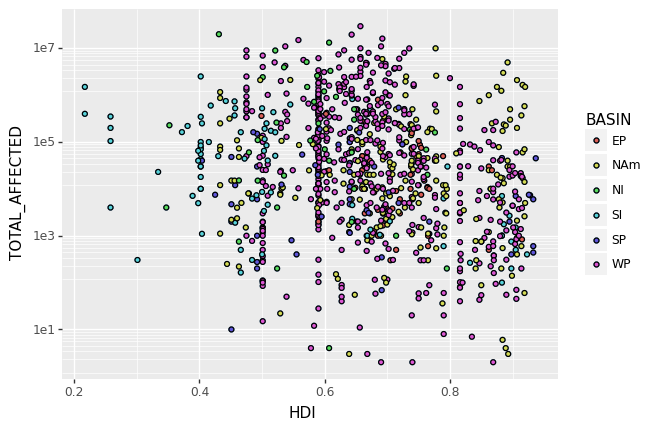

<ggplot: (-9223363251243254149)>


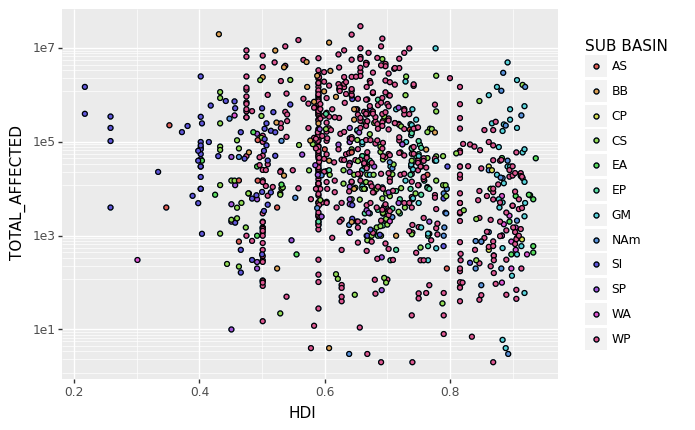

<ggplot: (8785611792851)>


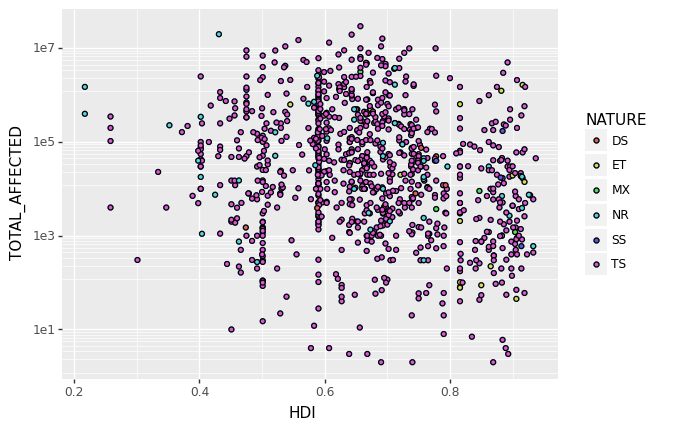

<ggplot: (-9223363251242953486)>


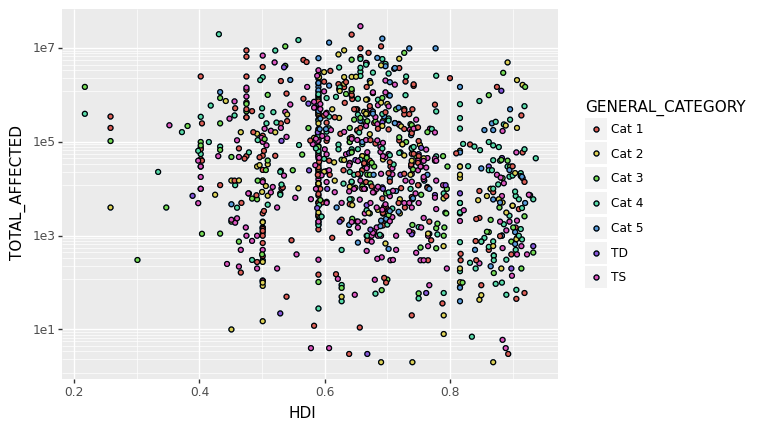

<ggplot: (-9223363251242605308)>


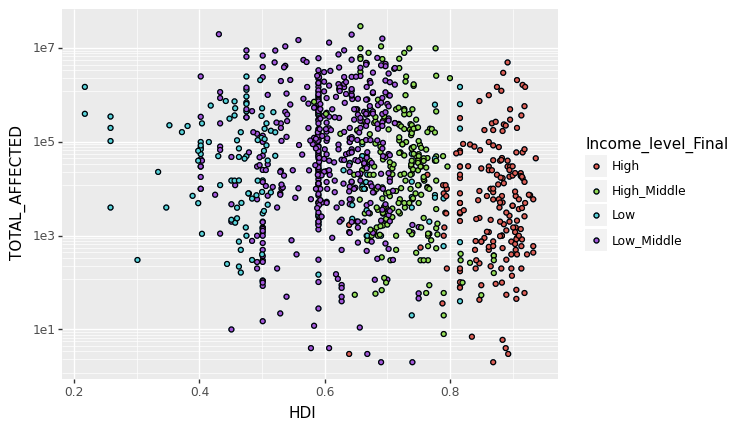

<ggplot: (-9223363251243038362)>
{'lower': array([101, 150, 197, 326, 392, 465, 986, 989]), 'upper': array([], dtype=int64), 'q_both': [0.3439999999999999, 1.0], 'min-max': [0.217, 0.937]}


In [0]:
plotBiMulti('HDI', 
            scale_x=0, scale_y=1)
print(outlier_check(df['HDI']))

# Categorical Variables

In [0]:
#############################################################################
#############################################################################
################ Categorical Variables ######################################
#############################################################################
#############################################################################

## GENERAL_CATEGORY

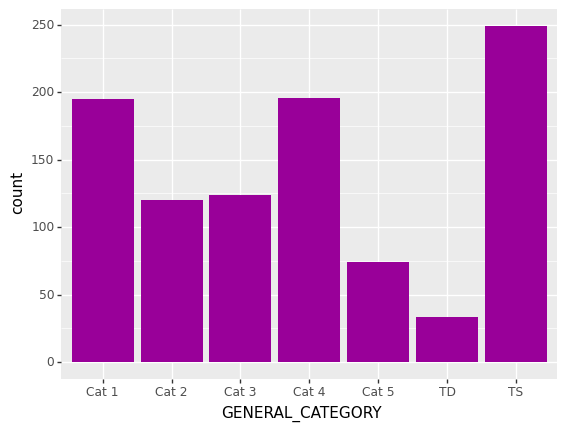

<ggplot: (8785611822305)>


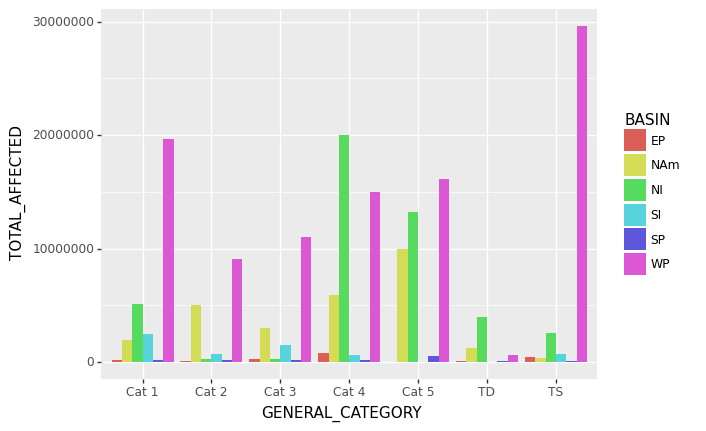

<ggplot: (8785611916110)>


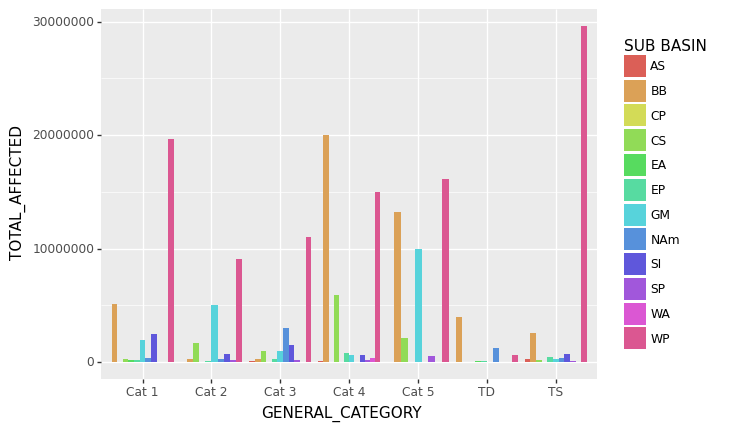

<ggplot: (8785611916110)>


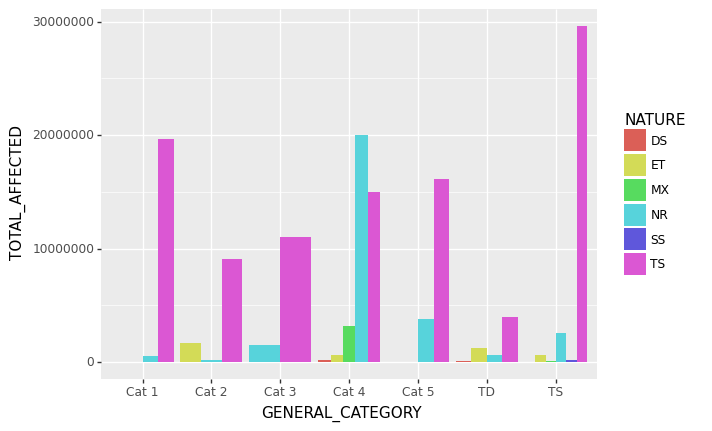

<ggplot: (-9223363251243087023)>


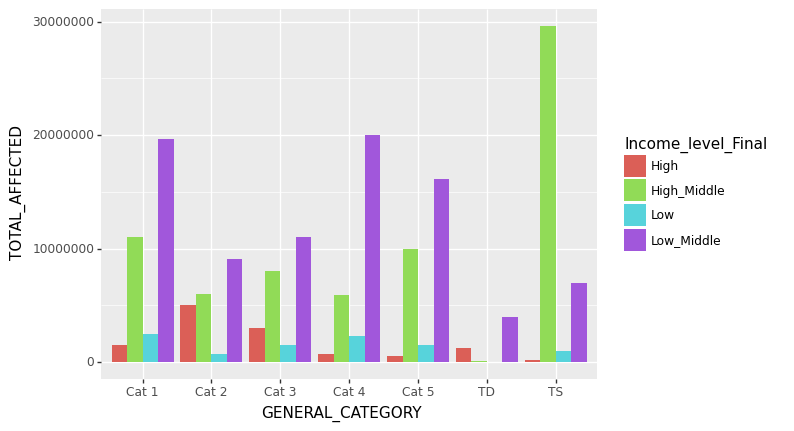

<ggplot: (-9223363251243236208)>


In [0]:
print(ggplot(df, aes(x='GENERAL_CATEGORY'))
 + geom_bar(fill="#990099"))

plotBiMulti_cat('GENERAL_CATEGORY')

## NATURE

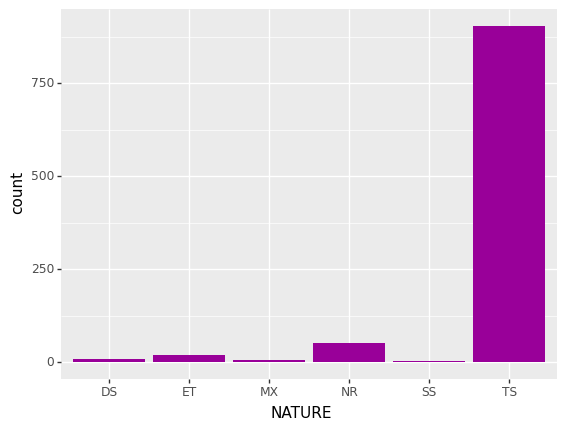

<ggplot: (8785611887778)>


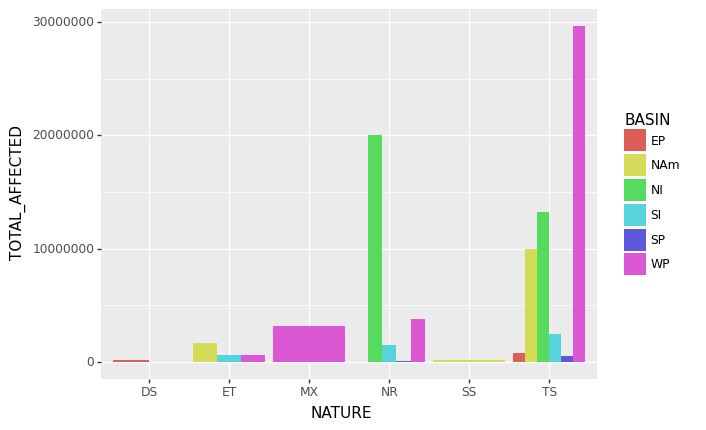

<ggplot: (-9223363251242545141)>


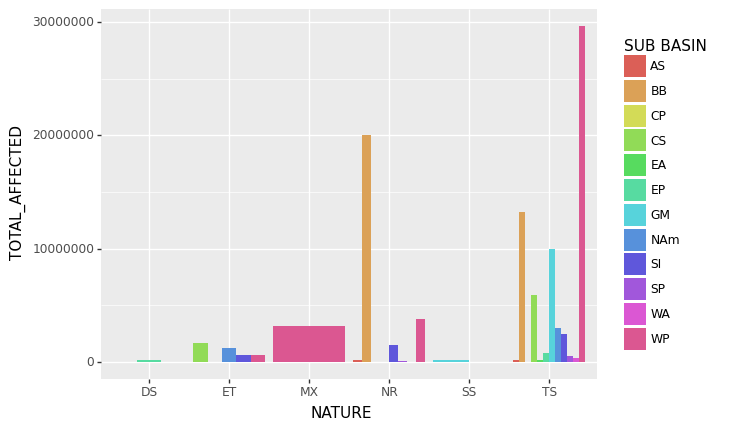

<ggplot: (-9223363251240344709)>


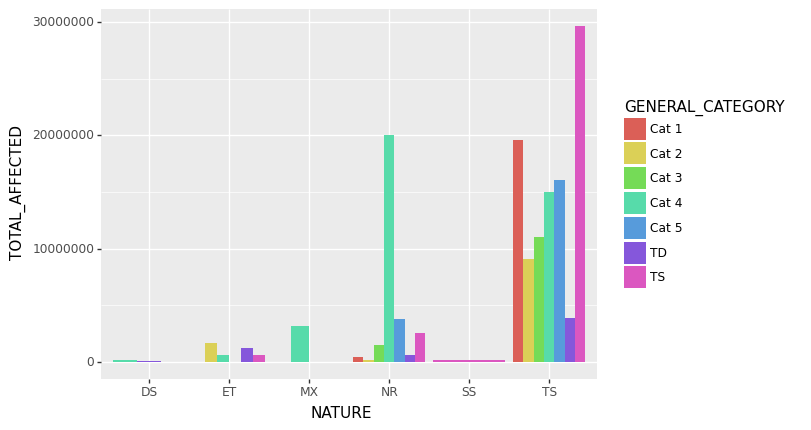

<ggplot: (8785612403106)>


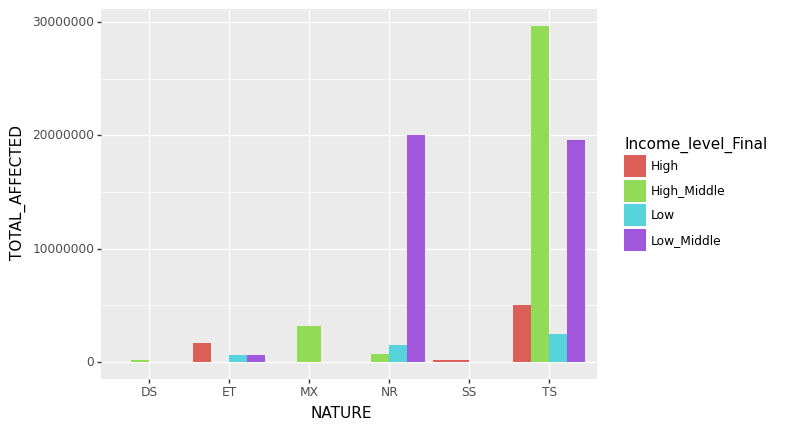

<ggplot: (-9223363251242920395)>


In [0]:
#### NATURE
print(ggplot(df, aes(x='NATURE'))
 + geom_bar(fill="#990099"))

plotBiMulti_cat('NATURE')

## MAX_USA_SSHS_INLAND

In [0]:
### MAX_USA_SSHS_INLAND
df['MAX_USA_SSHS_INLAND'] = df['MAX_USA_SSHS_INLAND'].astype('object')

## Get Frequency Mapping
MAX_SSHS_dict = {x: df['MAX_USA_SSHS_INLAND'].value_counts()[x] 
                 for x in df['MAX_USA_SSHS_INLAND'].value_counts().index}

df['SSH_Freq'] = df['MAX_USA_SSHS_INLAND'].map(MAX_SSHS_dict)



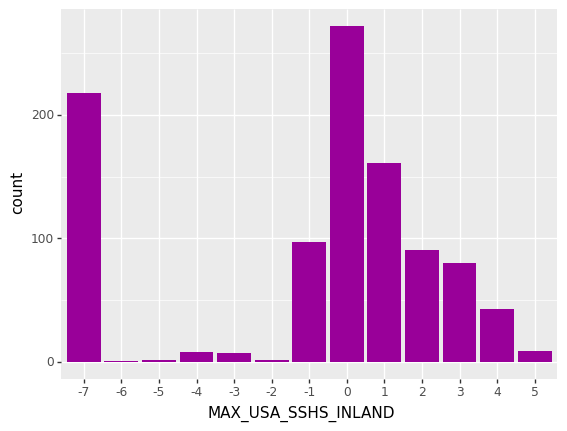

<ggplot: (8785614416637)>


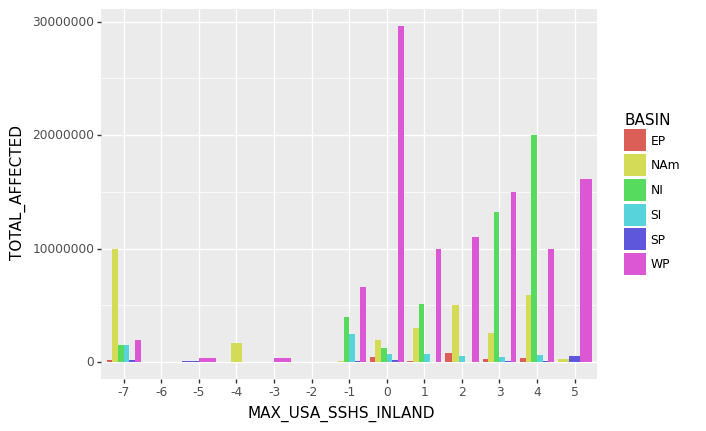

<ggplot: (8785611328737)>


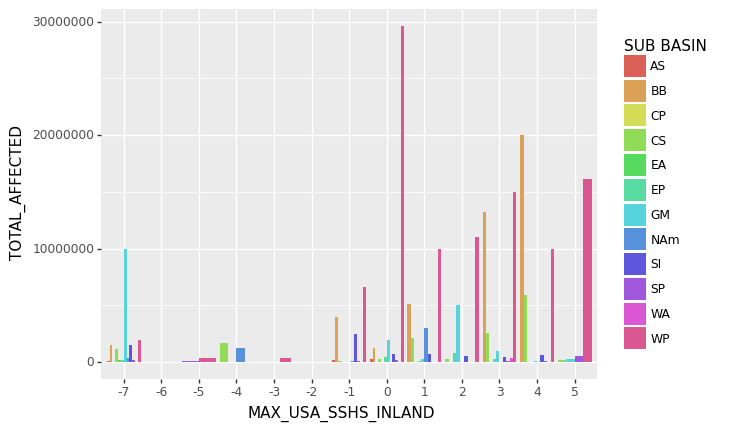

<ggplot: (8785611020040)>


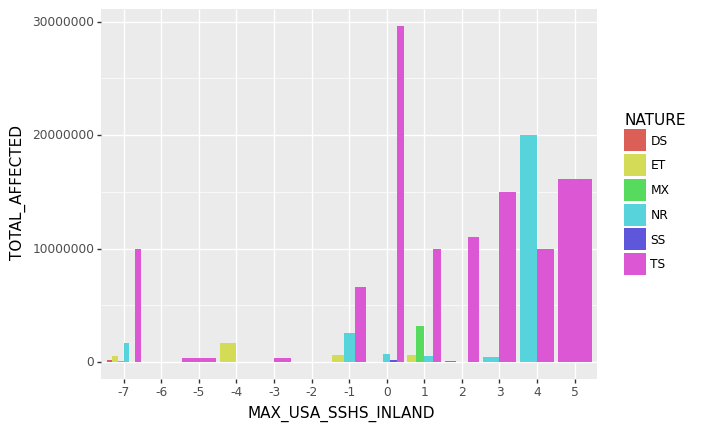

<ggplot: (-9223363251242329649)>


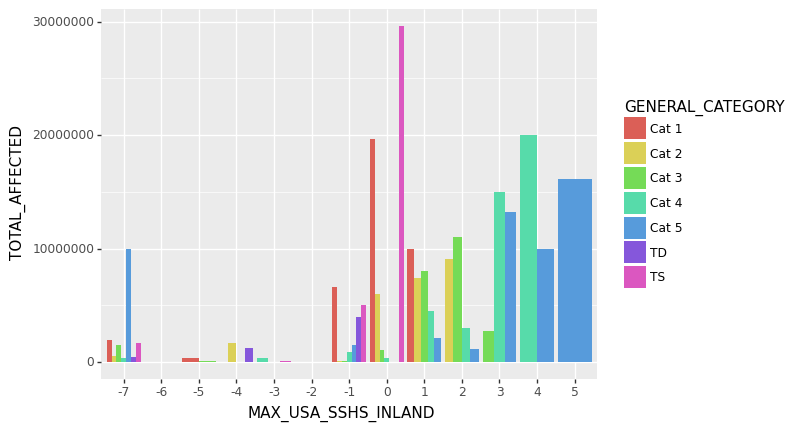

<ggplot: (8785610981647)>


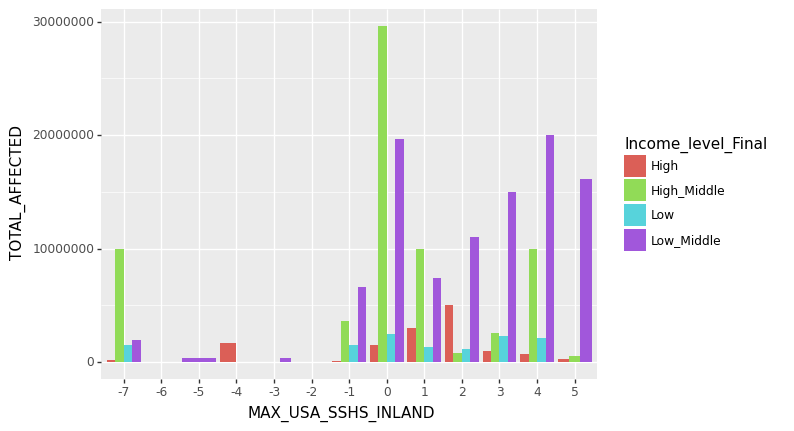

<ggplot: (8785611478427)>


In [0]:
print(ggplot(df, aes(x='MAX_USA_SSHS_INLAND'))
 + geom_bar(fill="#990099"))


plotBiMulti_cat('MAX_USA_SSHS_INLAND')

## BASIN

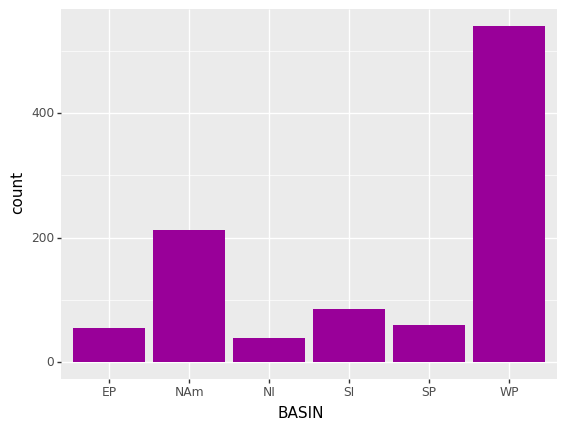

<ggplot: (-9223363251243482350)>


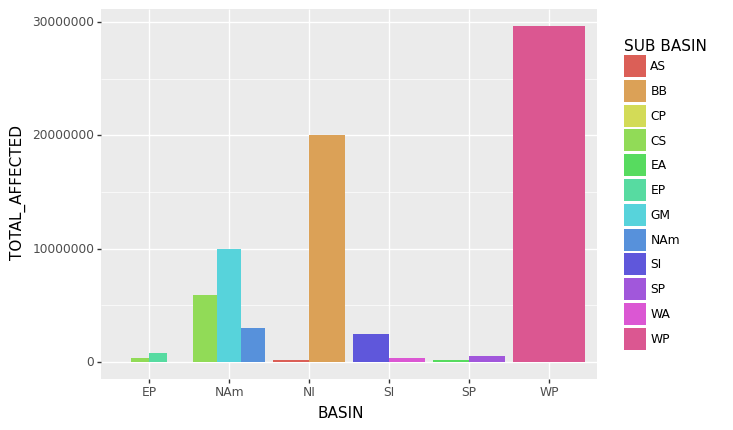

<ggplot: (-9223363251242191328)>


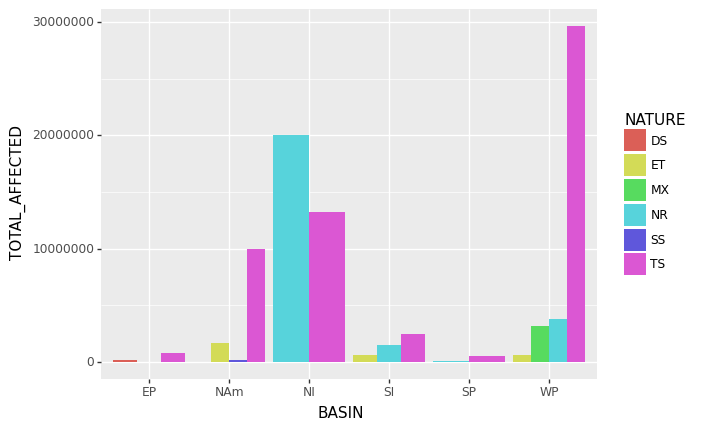

<ggplot: (8785612165510)>


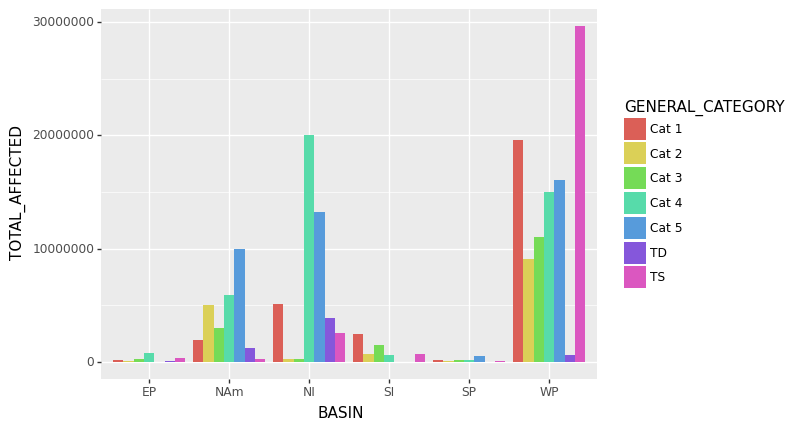

<ggplot: (8785612375002)>


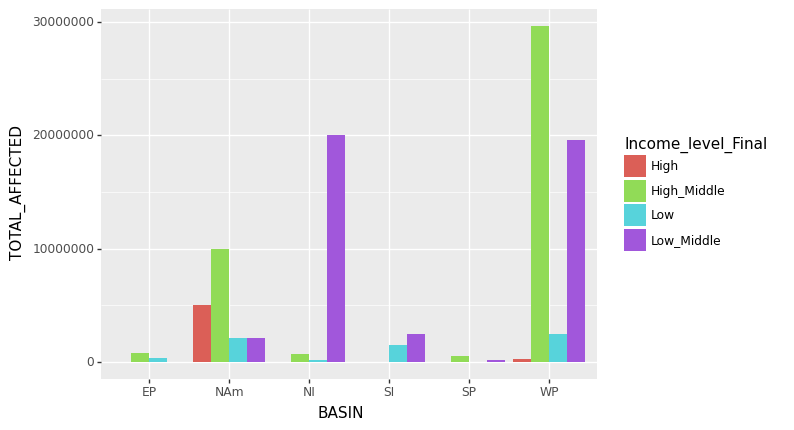

<ggplot: (-9223363251236326589)>


In [0]:
### BASIN
print(ggplot(df, aes(x='BASIN'))
 + geom_bar(fill="#990099"))

plotBiMulti_cat('BASIN')

## SUB BASIN

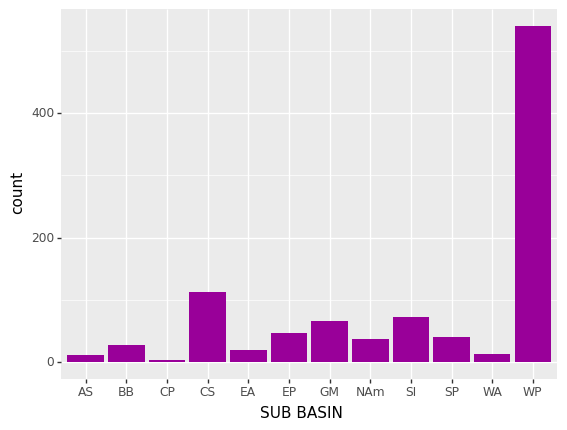

<ggplot: (-9223363251243121741)>


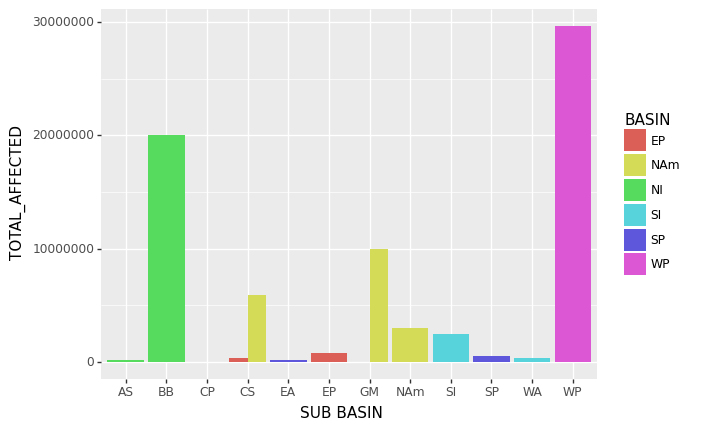

<ggplot: (-9223363251242373148)>


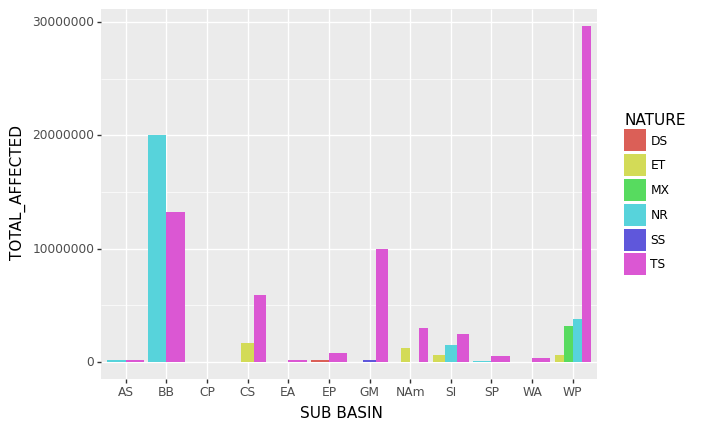

<ggplot: (8785612096569)>


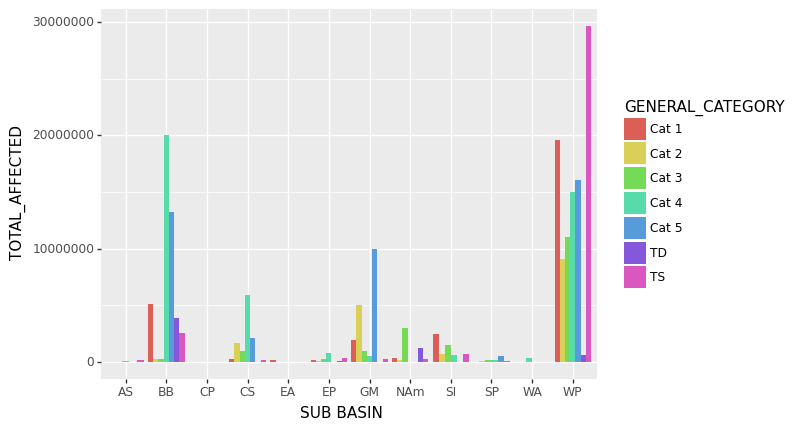

<ggplot: (-9223363251242994933)>


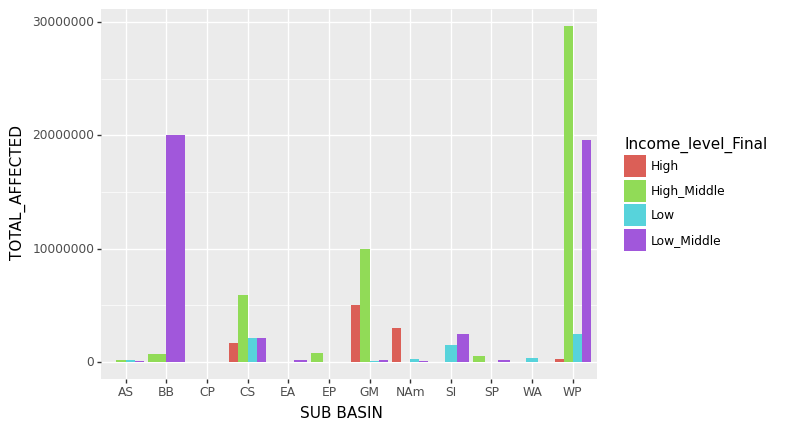

<ggplot: (-9223363251240426166)>


In [0]:
### SUB BASIN
print(ggplot(df, aes(x='SUB BASIN'))
 + geom_bar(fill="#990099"))

plotBiMulti_cat('SUB BASIN')

## Income_level_Final

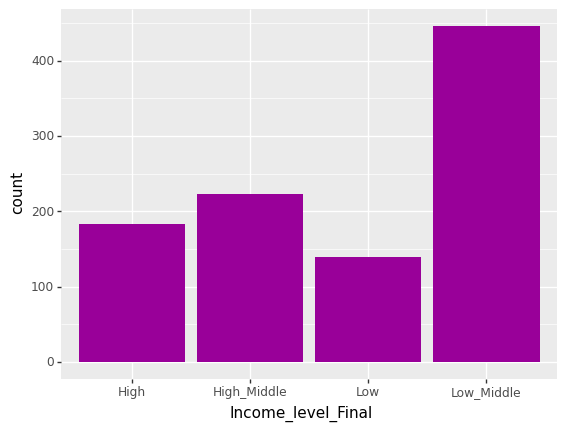

<ggplot: (-9223363251240426082)>


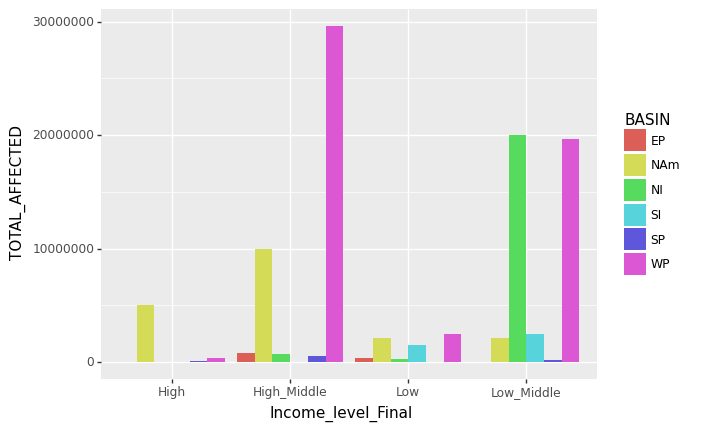

<ggplot: (8785611652216)>


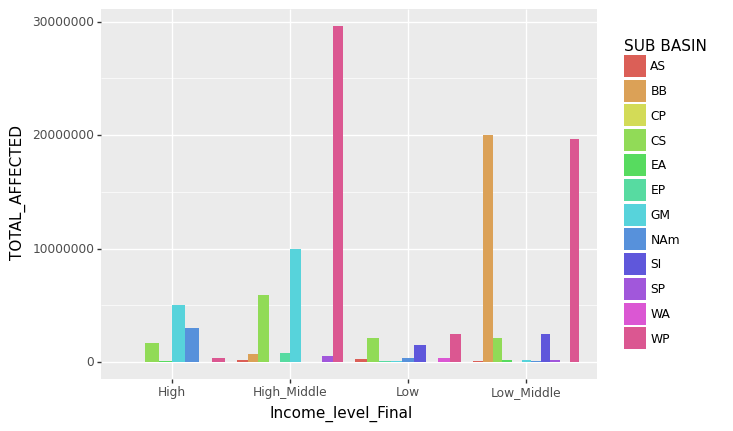

<ggplot: (8785611652223)>


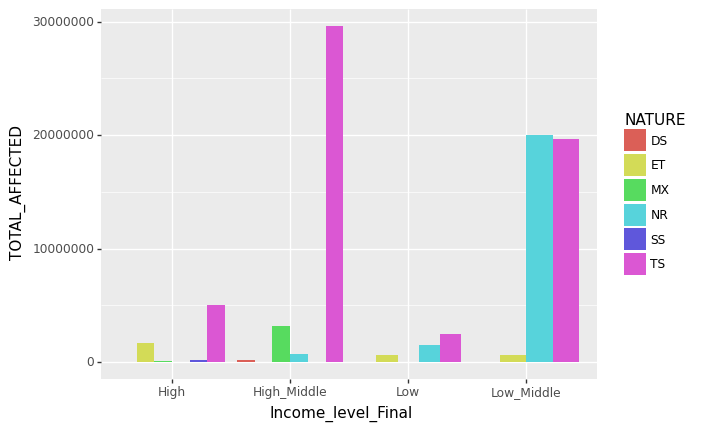

<ggplot: (8785611058766)>


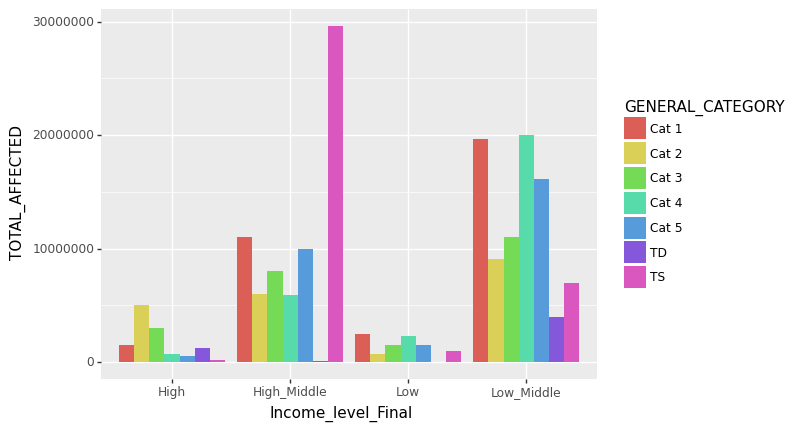

<ggplot: (-9223363251243413160)>


In [0]:
# Income_level_Final
print(ggplot(df, aes(x='Income_level_Final'))
 + geom_bar(fill="#990099"))


plotBiMulti_cat('Income_level_Final')

In [0]:
df["SUBGEN"] = df['SUB BASIN'] + df['GENERAL_CATEGORY']
df["SUBINCOME"] = df['SUB BASIN'] + df['Income_level_Final']

In [0]:
len(df["SUBINCOME"].unique()), len(df["SUBGEN"].unique())

(38, 74)

# Target Variable

/usr/local/lib/python3.6/dist-packages/plotnine/stats/stat_bin.py:93: PlotnineWarning: 'stat_bin()' using 'bins = 608'. Pick better value with 'binwidth'.
  warn(msg.format(params['bins']), PlotnineWarning)


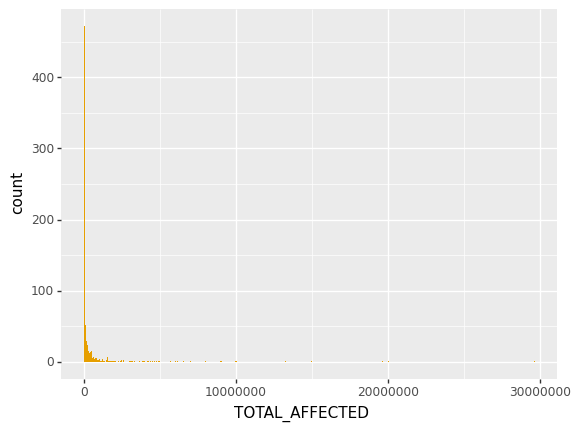

<ggplot: (8758138742862)>


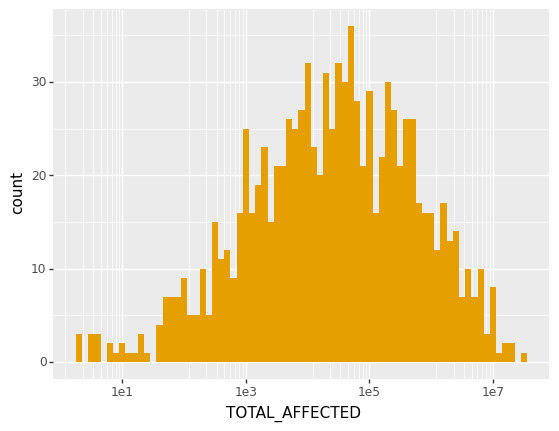

<ggplot: (-9223363278716004934)>


In [0]:
#############################################################################
#############################################################################
################ Target Variable ############################################
#############################################################################
#############################################################################
print(ggplot(df, aes(x='TOTAL_AFFECTED'))
 + geom_histogram(fill="#E69F00"))

print(ggplot(df, aes(x='TOTAL_AFFECTED'))
 + geom_histogram(fill="#E69F00", binwidth=0.1)
 + scale_x_log10())


df['TOTAL_AFFECTED'] = np.log10(df['TOTAL_AFFECTED'] + 1)

In [0]:
### Years since min year
df["YEARS_SINCE_MIN"] = df["YEAR"] - df["YEAR"].min()



## Create dummies for categorical features
df.drop(columns=['YEAR'])

df['MAX_USA_SSHS_INLAND'] = df['MAX_USA_SSHS_INLAND'].astype('int')


object_columns = [col for col in df.columns.values if df[col].dtype == 'object']
dummies = pd.get_dummies(df[object_columns])



df_dummies = pd.concat([df, dummies], axis=1)
df_dummies = df_dummies.drop(columns=object_columns)

In [0]:
## Split data
features = [x for x in df_dummies.columns.values if x != 'TOTAL_AFFECTED']
X_train, X_test, y_train, y_test = train_test_split(
    df_dummies[features], df_dummies['TOTAL_AFFECTED'], test_size=0.2, random_state=42)

In [0]:
# Standard scaler
scaler = StandardScaler()
scaled_X = scaler.fit_transform(X_train)

# Clustering


Drop for now. Check on later

## KMEANS

In [0]:
for n_cluster in range(2, 11):
  km = KMeans(n_clusters=n_cluster, random_state=42).fit(scaled_X)
  print('{} -- {}'.format(n_cluster, silhouette_score(scaled_X, km.labels_)))

2 -- 0.16492223601177855
3 -- 0.11774071177928729
4 -- 0.10154751112370722
5 -- 0.12305817305046411
6 -- 0.13247114900721585
7 -- 0.02235460894875271
8 -- 0.03192940951678921
9 -- 0.03531463043026558
10 -- 0.10576242751523689


In [0]:
km = KMeans(n_clusters=2, random_state=42).fit(scaled_X)
km.fit(scaled_X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=42, tol=0.0001, verbose=0)

## PCA

In [0]:
pca = PCA(n_components=2)
pca.fit(scaled_X)

scaled_X_pca = pca.transform(scaled_X)

In [0]:
pca_df = pd.DataFrame({"Labels": km.labels_, 
                       "Feature_1": scaled_X_pca[:, 0], 
                       "Feature_2": scaled_X_pca[:, 1]})

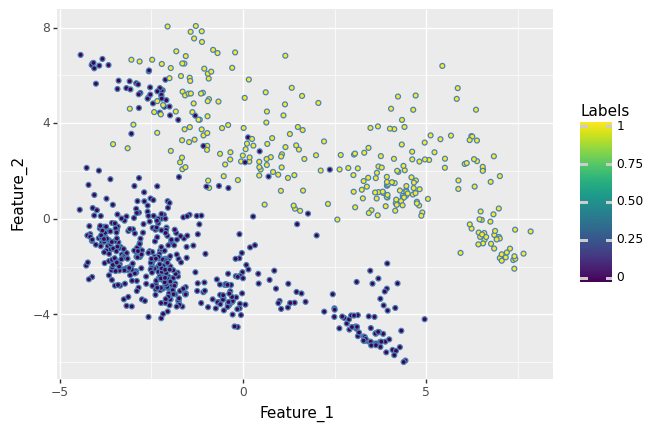

<ggplot: (8758128195192)>


In [0]:
print(ggplot(pca_df, aes(x='Feature_1', y='Feature_2', fill="Labels"))
 + geom_point(color='steelblue'))

# Modeling

## Model Architecture

In [0]:
# Model Architecture
def build_model():
  clf = Sequential()

  clf.add(Dense(16, kernel_initializer='random_normal', input_shape=(X_train.shape[1], )))
  clf.add(BatchNormalization())
  clf.add(ReLU())

  clf.add(Dense(32, kernel_initializer='random_normal'))
  clf.add(ReLU())
  clf.add(Dropout(0.45))
  
  clf.add(Dense(64, kernel_initializer='random_normal'))
  clf.add(BatchNormalization())
  clf.add(ReLU())

  clf.add(Dense(128, kernel_initializer='random_normal'))
  clf.add(BatchNormalization())
  clf.add(Dropout(0.3))

  clf.add(Dense(256, kernel_initializer='random_normal'))
  clf.add(BatchNormalization())
  clf.add(ReLU())

  clf.add(Dense(512, kernel_initializer='random_normal'))
  clf.add(BatchNormalization()) ## 512 ----
  clf.add(ReLU())

  clf.add(Dense(1, kernel_initializer='random_normal'))

  optim = optimizers.RMSprop(learning_rate=0.00001)
  clf.compile(loss='mse', optimizer=optim, metrics=['mae'])

  return(clf)

## Loss & Callback

In [0]:
## Loss & Optimizer setup
keras_model = build_model()
callback = [EarlyStopping(monitor='val_loss', patience=400, 
                                              verbose=1, mode='min'), 
            ModelCheckpoint('model.sve', monitor='val_loss', verbose=True, 
                            save_best_only=True, mode='min')]

## Train model

In [0]:
history = keras_model.fit(scaled_X, np.array(y_train), epochs=500, 
                          validation_split=0.2, batch_size=32, callbacks=callback)

Train on 633 samples, validate on 159 samples
Epoch 1/500
633/633 [==============================] - 1s 2ms/step - loss: 30.2857 - mae: 5.2203 - val_loss: 19.2101 - val_mae: 4.2030

Epoch 00001: val_loss improved from inf to 19.21009, saving model to model.sve
Epoch 2/500
633/633 [==============================] - 0s 281us/step - loss: 29.1393 - mae: 5.1480 - val_loss: 19.4235 - val_mae: 4.2283

Epoch 00002: val_loss did not improve from 19.21009
Epoch 3/500
633/633 [==============================] - 0s 292us/step - loss: 28.3541 - mae: 5.0684 - val_loss: 19.5197 - val_mae: 4.2396

Epoch 00003: val_loss did not improve from 19.21009
Epoch 4/500
633/633 [==============================] - 0s 294us/step - loss: 27.4596 - mae: 4.9795 - val_loss: 19.5661 - val_mae: 4.2451

Epoch 00004: val_loss did not improve from 19.21009
Epoch 5/500
633/633 [==============================] - 0s 346us/step - loss: 26.4793 - mae: 4.9036 - val_loss: 19.5143 - val_mae: 4.2389

Epoch 00005: val_loss did not i

## Visualize

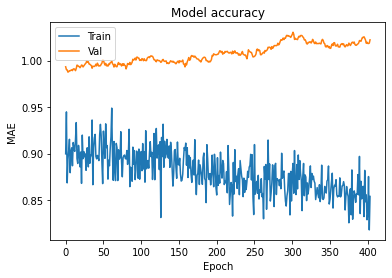

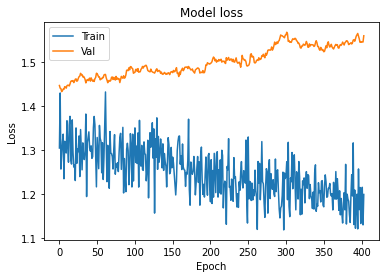

In [0]:
## Visualize model loss

# Plot training & validation accuracy values
plt.plot(history.history['mae'])
plt.plot(history.history['val_mae'])
plt.title('Model accuracy')
plt.ylabel('MAE')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='upper left')
plt.show()

# Plot training & validation loss values
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='upper left')
plt.show()

In [0]:
k_model = load_model("model.sve")
k_model.evaluate(np.array(scaler.transform(X_test)), np.array(y_test))


###1.34 best fit (so far)

199/199 [==============================] - 0s 486us/step


[1.610494097872595, 1.0298783779144287]

In [0]:
r2_score(10**np.array(y_test), 10**k_model.predict(np.array(scaler.transform(X_test))))

-0.06701487458582789

In [0]:
np.sqrt(mean_squared_error(10**np.array(y_test), 
                           10**k_model.predict(np.array(scaler.transform(X_test)))))

1008969.9198196795

In [0]:
from sklearn.ensemble import GradientBoostingRegressor

clf = GradientBoostingRegressor(n_estimators=1500, max_depth=4)
clf.fit(scaled_X, y_train)

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=4,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=1500,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

In [0]:
np.sqrt(mean_squared_error(10**y_test, 
                    10**clf.predict(np.array(scaler.transform(X_test)))))

1558298.2572887163

In [0]:
r2_score(10**y_test, 10**clf.predict(np.array(scaler.transform(X_test))))

-0.22799235223253778

In [0]:
r2_score(y_test, clf.predict(np.array(scaler.transform(X_test))))

0.21994007640470614

In [0]:
X_train.shape

(792, 188)

In [0]:
from keras.wrappers.scikit_learn import KerasRegressor
KR = KerasRegressor(build_model, epochs=962, batch_size=32, verbose=1)

In [0]:
KR.fit(scaled_X, y_train)

## Feature Importance

In [0]:

### Feature Importances - GradientBoosting
imp = permutation_importance(clf, scaler.transform(X_test), 
                                                y_test, scoring='neg_mean_squared_error')


imp = PermutationImportance(clf,n_iter=2).fit(scaler.transform(X_test), y_test)
eli5.show_weights(imp, feature_names = X_train.columns.tolist(), top=X_train.shape[1])

In [0]:
### Feature Importances - ANN

imp = permutation_importance(KR, scaler.transform(X_test), 
                                                y_test, scoring='neg_mean_squared_error')

imp = PermutationImportance(clf,n_iter=2).fit(scaler.transform(X_test), y_test)
eli5.show_weights(imp, feature_names = X_train.columns.tolist(), top=X_train.shape[1])

Weight,Feature
0.0957 ± 0.0467,POP_MAX_64_ADJ
0.0866 ± 0.0113,MIN_PRES
0.0778 ± 0.0338,V_LAND_KN
0.0571 ± 0.0092,GDP per capita (constant 2010 US$)
0.0408 ± 0.1029,RURAL_POP(%)
0.0356 ± 0.0387,POP_MAX_50_ADJ
0.0352 ± 0.0159,TOTAL_HOURS_EVENT
0.0352 ± 0.0186,"Life expectancy at birth, total (years)"
0.0338 ± 0.0077,POP_DEN_SQ_KM
0.0337 ± 0.0637,MAX_STORMSPEED
